<img src="https://github.com/hernancontigiani/ceia_memorias_especializacion/raw/master/Figures/logoFIUBA.jpg" width="500" align="center">


# **Visión por Computadora II - TPI**
# **Generador de tiles de imágenes satelitales**

> **Carrera de Especialización en Inteligencia Artificial, Facultad de Ingeniería**
>
> **Universidad de Buenos Aires, Agosto de 2024**
>
> Tatiana Arenas Suárez (particulastato@gmail.com)
>
> Edgar David Guarin Castro (davidg@marketpsychdata.com)

En este notebook se aplica el modelo a las imágenes extraídas de Mapbox y se generan polígonos en formato GeoJSON, los cuales se desplegarán en la aplicación de mapas de Mapbox. Solo aplicará para el modelo de Unet dado que dio mejores resultados.

In [ ]:
!pip install mercantile

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os
from tqdm.notebook import tqdm
from random import shuffle
import torch
from torch import nn
import math
from glob import glob
import sys
import shutil
import json

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
%matplotlib inline

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Se recrea la estructura de la Unet 

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F


class DoubleConv(nn.Module):
    """(convolution => [BN] => ReLU) * 2"""

    def __init__(self, in_channels, out_channels, mid_channels=None):
        super().__init__()
        if not mid_channels:
            mid_channels = out_channels
        self.double_conv = nn.Sequential(
            nn.Conv2d(in_channels, mid_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(mid_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(mid_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        return self.double_conv(x)


class Down(nn.Module):
    """Downscaling with maxpool then double conv"""

    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.maxpool_conv = nn.Sequential(
            nn.MaxPool2d(2),
            DoubleConv(in_channels, out_channels)
        )

    def forward(self, x):
        return self.maxpool_conv(x)


class Up(nn.Module):
    """Upscaling then double conv"""

    def __init__(self, in_channels, out_channels, bilinear=True):
        super().__init__()

        # if bilinear, use the normal convolutions to reduce the number of channels
        if bilinear:
            self.up = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
            self.conv = DoubleConv(in_channels, out_channels, in_channels // 2)
        else:
            self.up = nn.ConvTranspose2d(in_channels , in_channels // 2, kernel_size=2, stride=2)
            self.conv = DoubleConv(in_channels, out_channels)


    def forward(self, x1, x2):
        x1 = self.up(x1)
        # input is CHW
        diffY = x2.size()[2] - x1.size()[2]
        diffX = x2.size()[3] - x1.size()[3]

        x1 = F.pad(x1, [diffX // 2, diffX - diffX // 2,
                        diffY // 2, diffY - diffY // 2])

        x = torch.cat([x2, x1], dim=1)
        return self.conv(x)


class OutConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(OutConv, self).__init__()
        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size=1)

    def forward(self, x):
        return self.conv(x)

In [ ]:
class UNet(nn.Module):
    def __init__(self, n_channels, n_classes, bilinear=True):
        super(UNet, self).__init__()
        self.n_channels = n_channels
        self.n_classes = n_classes
        self.bilinear = bilinear

        self.inc = DoubleConv(n_channels, 64)
        self.down1 = Down(64, 128)
        self.down2 = Down(128, 256)
        self.down3 = Down(256, 512)
        factor = 2 if bilinear else 1
        self.down4 = Down(512, 1024 // factor)
        self.up1 = Up(1024, 512 // factor, bilinear)
        self.up2 = Up(512, 256 // factor, bilinear)
        self.up3 = Up(256, 128 // factor, bilinear)
        self.up4 = Up(128, 64, bilinear)
        self.outc = OutConv(64, n_classes)

    def forward(self, x):
        x1 = self.inc(x)
        x2 = self.down1(x1)
        x3 = self.down2(x2)
        x4 = self.down3(x3)
        x5 = self.down4(x4)
        x = self.up1(x5, x4)
        x = self.up2(x, x3)
        x = self.up3(x, x2)
        x = self.up4(x, x1)
        logits = self.outc(x)
        return logits

# Se carga el modelo con mejor rendimiento

In [ ]:
model = UNet(n_channels=3, n_classes=8, bilinear=True)
model.load_state_dict(torch.load('/content/drive/MyDrive/Colab Notebooks/unet_epoch_18_0.500_rural.pt',map_location=torch.device('cpu') ))


<All keys matched successfully>

In [ ]:
if torch.cuda.is_available():
    model.cuda()

# Clase para la carga de las clases

In [ ]:
class segDataset(torch.utils.data.Dataset):
    def __init__(self, root, training, transform=None):
        super(segDataset, self).__init__()
        self.root = root
        self.training = training
        self.transform = transform
        self.IMG_NAMES = sorted(glob(self.root + '/35.36-79.17_17/*.png')) # change your route
        self.BGR_classes = {'water' : [ 4,0,0],
                            'barren' : [5,0,0],
                            'road' : [3,0,0],
                            'building' : [2,0,0],
                            'forest' : [6,0,0],
                            'agriculture' : [7,0,0],
                            'background' : [ 1,0,0],
                            'unlabeled' : [0,0,0]} # in BGR

        self.bin_classes = ['unlabeled', 'background', 'building', 'road', 'water', 'barren', 'forest', 'agriculture']


    def __getitem__(self, idx):
        img_path = self.IMG_NAMES[idx]

        image = cv2.imread(img_path)

        if self.training==True:
            if self.transform:
              image = transforms.functional.to_pil_image(image)
              image = self.transform(image)
              image = np.array(image)

        image = cv2.resize(image, (512,512))/255.0
        image = np.moveaxis(image, -1, 0)

        return torch.tensor(image).float()


    def __len__(self):
        return len(self.IMG_NAMES)


In [ ]:
dataset = segDataset('/content/drive/MyDrive/Final_model/', training = True) # change your route
len(dataset)

270

In [ ]:
# apply image transformation to data set
BACH_SIZE = 4
test_dataloader = torch.utils.data.DataLoader(
    dataset, batch_size=BACH_SIZE, shuffle=False, num_workers=1)


In [ ]:
dataset_path_image = '/content/drive/MyDrive/Final_model/35.36-79.17_17/'
filenames_image = sorted(os.listdir(dataset_path_image))

# Función que transforma las máscaras en GeoJson

In [ ]:

from skimage import measure
import mercantile

def pixel2coordinate(tile_x, tile_y, zoom_level, pixel_y, pixel_x ):

# Get tile bounds (lat/lon)
    bounds = mercantile.bounds(tile_x, tile_y, zoom_level)

    min_lon, min_lat, max_lon, max_lat = bounds
    # print(min_lon, min_lat)

# Calculate tile size
    tile_size = 512

# Convert pixel coordinates to tile-relative coordinates
    relative_x = pixel_x / tile_size
    relative_y = pixel_y / tile_size

# Convert tile-relative coordinates to geographical coordinates
    pixel_lon = (max_lon - min_lon) * relative_x + min_lon
    pixel_lat = -(max_lat - min_lat) * relative_y + max_lat

    # print("Pixel Latitude:", pixel_lat , pixel_y)
    # print("Pixel Longitude:", pixel_lon, pixel_x)
    return pixel_lon, pixel_lat


def create_json(mask, tile_x, tile_y, zoom_level):
    unique_values = np.unique(mask)
    for value in unique_values:
        if value == 0:  # ignore no-data regions
            continue

        # Get the mask of the current category
        curr_mask = (mask == value).astype(np.uint8)

        # Add padding around the mask
        padded_mask = np.pad(curr_mask, pad_width=1, mode='constant', constant_values=0)

        geojson = {
            "type": "FeatureCollection",
            "features": []
        }

        # Use skimage to get the contours from the mask
        contours = measure.find_contours(padded_mask, 0.5, positive_orientation='low')

        for contour in contours:
          contour = contour - 1

          # Convert pixel coordinates to longitude and latitude (perform the necessary conversion)
          # Assuming you have a conversion function `convert_pixel_to_coordinates(x, y)` for pixel (x, y)
          coordinates = [pixel2coordinate(tile_x, tile_y, zoom_level, x, y) for [x, y] in contour.squeeze().tolist()]

          feature = {
            "type": "Feature",
            "geometry": {
            "type": "Polygon",
            "coordinates": [coordinates]
            },
              "properties": {}
                                }
          geojson["features"].append(feature)


          # Save the GeoJSON to a file
          output_file = '/content/drive/MyDrive/Final_model/results_35.36-79.17_17/'+str(tile_x)+'_'+ str(tile_y)+'_'+str(zoom_level)+'_'+str(value)+'.geojson'
          with open(output_file, 'w') as f:
              json.dump(geojson, f)

# Se aplica el modelo y se convierte a geojson cada máscara 




0
<class 'torch.Tensor'>
36703
51748


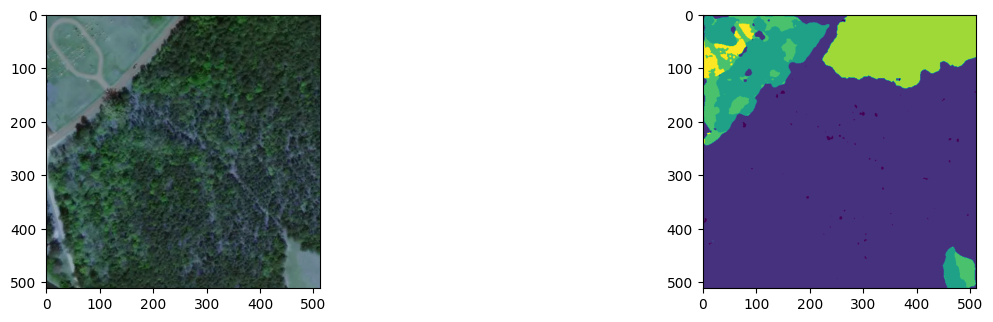

<class 'torch.Tensor'>
36703
51749


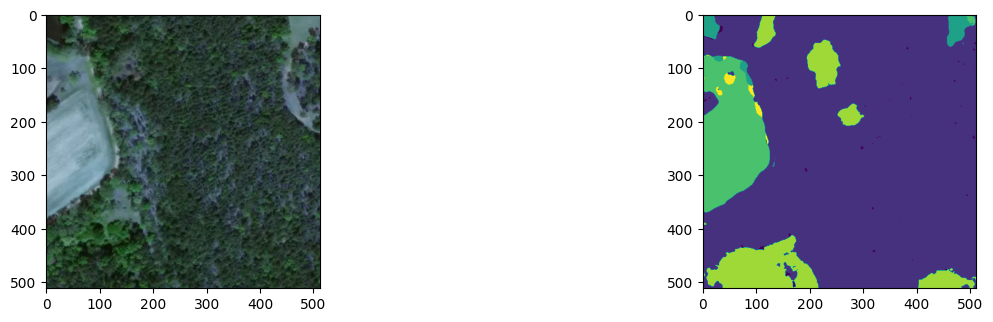

<class 'torch.Tensor'>
36703
51750


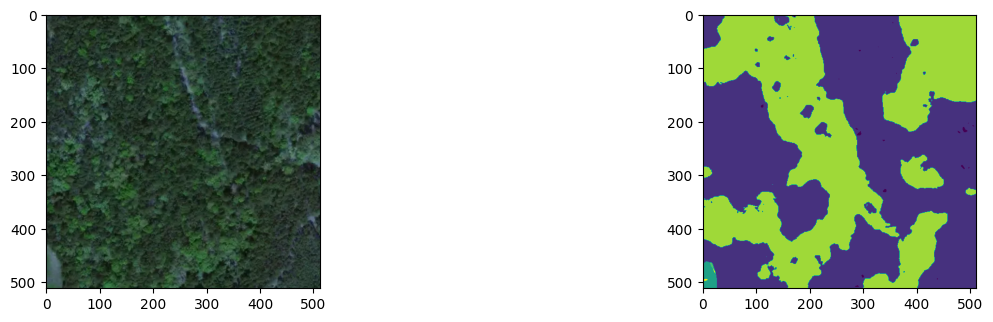

<class 'torch.Tensor'>
36703
51751


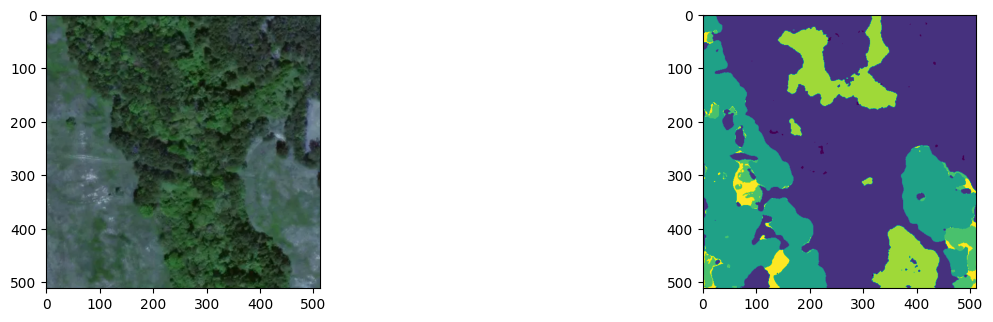

1
<class 'torch.Tensor'>
36703
51752


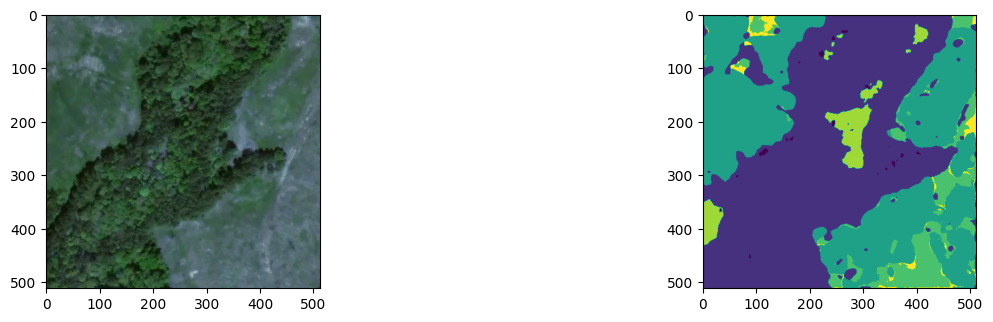

<class 'torch.Tensor'>
36703
51753


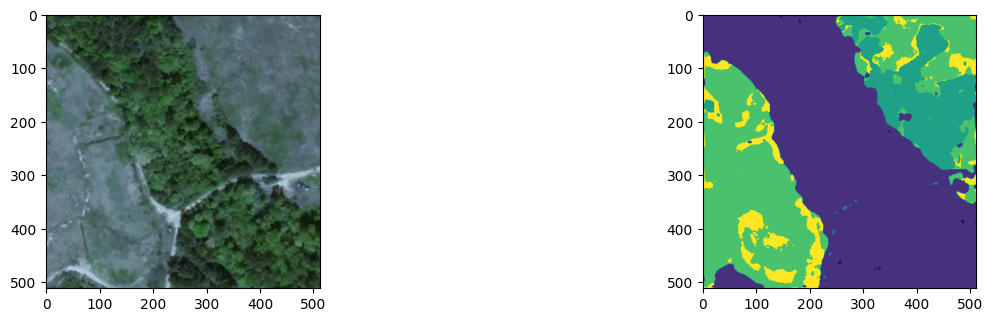

<class 'torch.Tensor'>
36703
51754


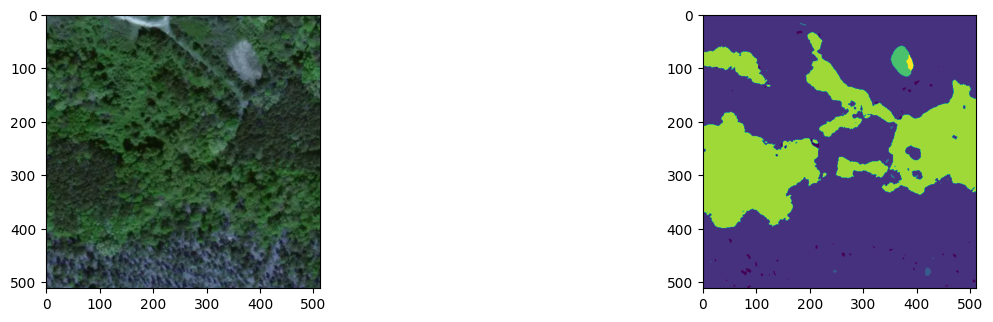

<class 'torch.Tensor'>
36703
51755


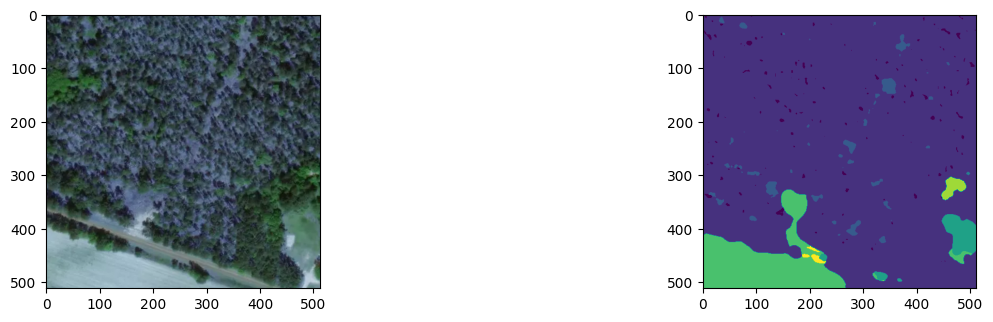

2
<class 'torch.Tensor'>
36703
51756


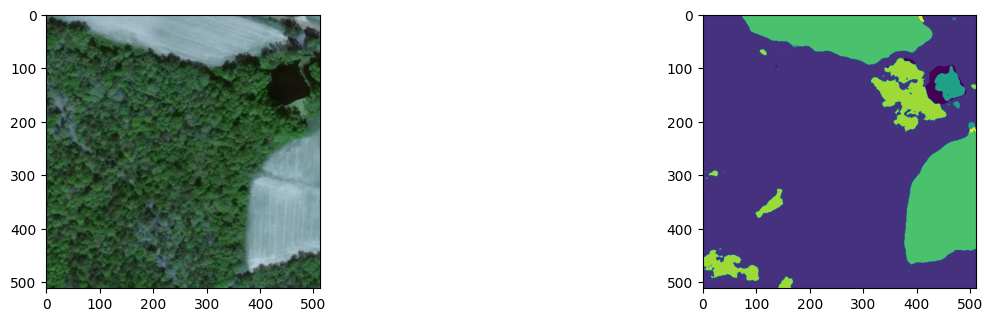

<class 'torch.Tensor'>
36703
51757


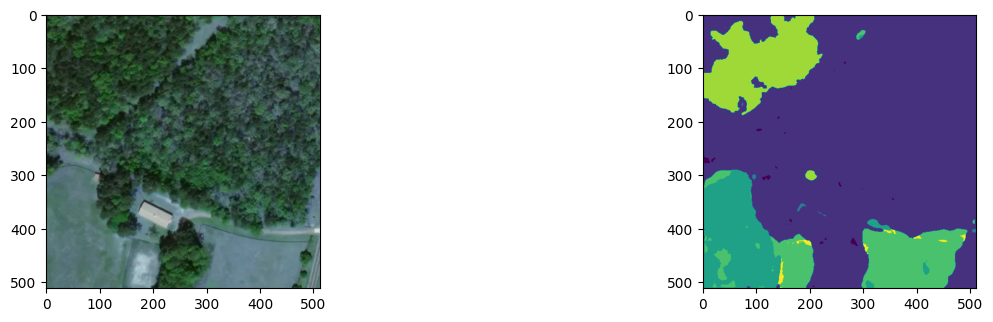

<class 'torch.Tensor'>
36703
51758


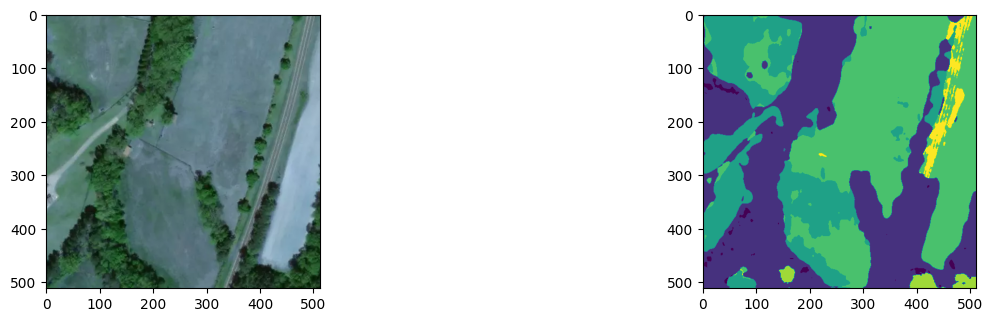

<class 'torch.Tensor'>
36703
51759


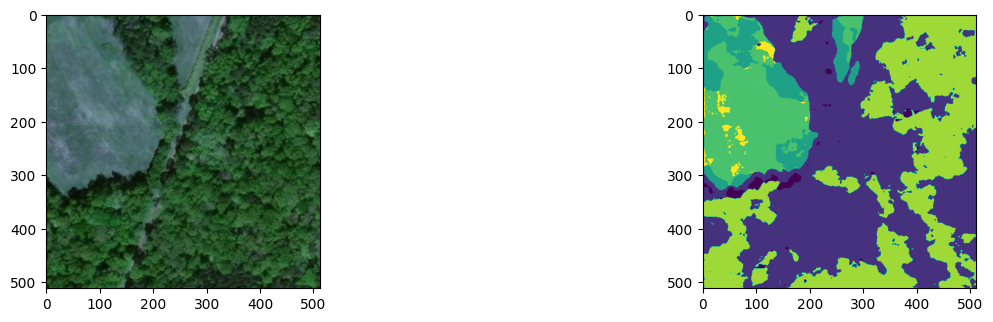

3
<class 'torch.Tensor'>
36703
51760


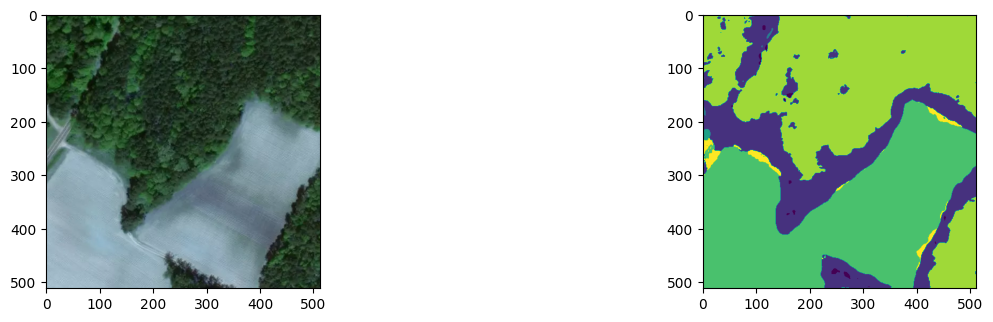

<class 'torch.Tensor'>
36703
51761


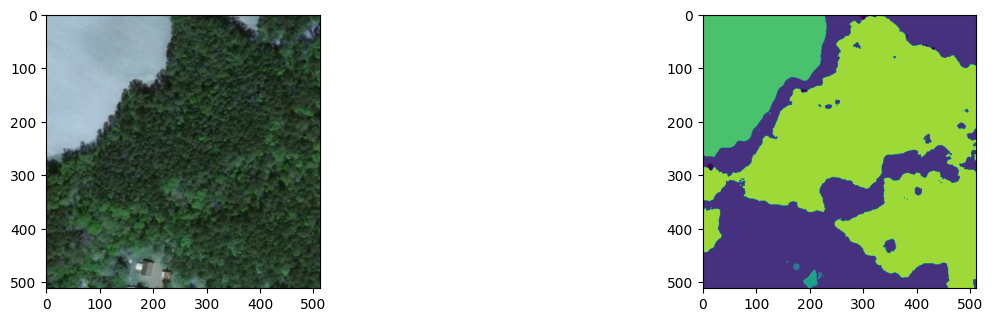

<class 'torch.Tensor'>
36703
51762


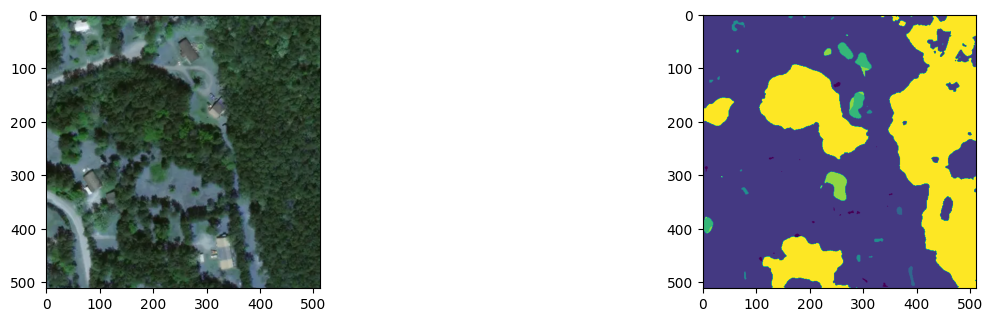

<class 'torch.Tensor'>
36703
51763


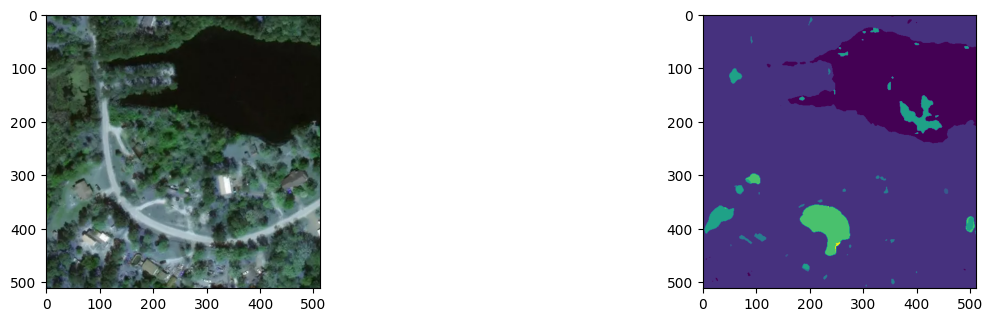

4
<class 'torch.Tensor'>
36703
51764


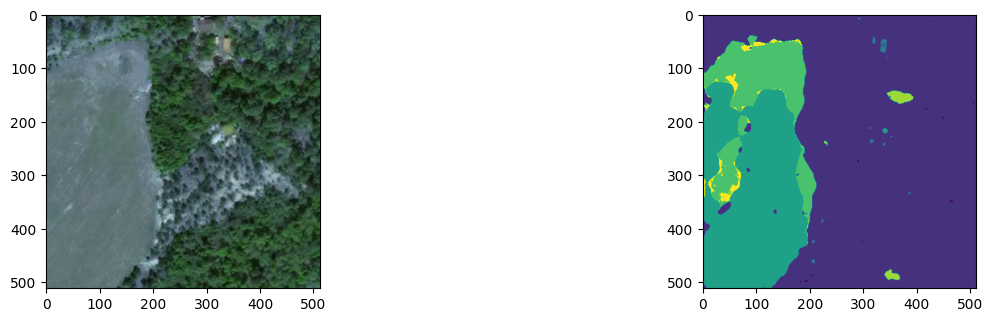

<class 'torch.Tensor'>
36703
51765


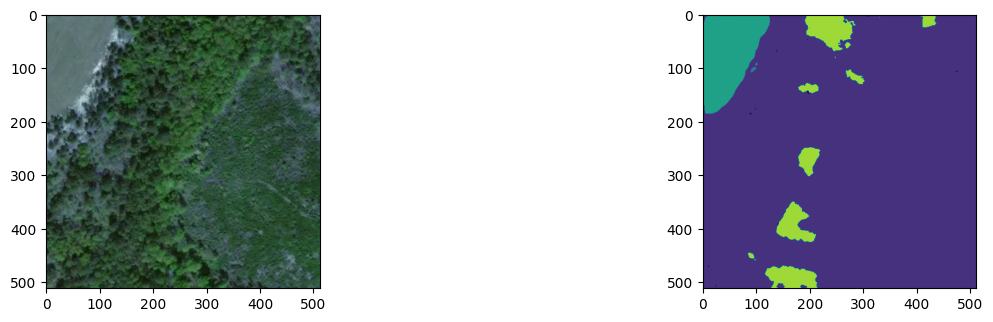

<class 'torch.Tensor'>
36704
51748


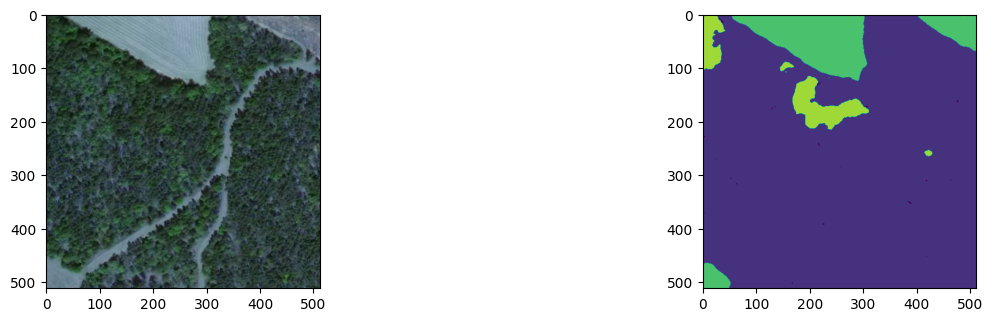

<class 'torch.Tensor'>
36704
51749


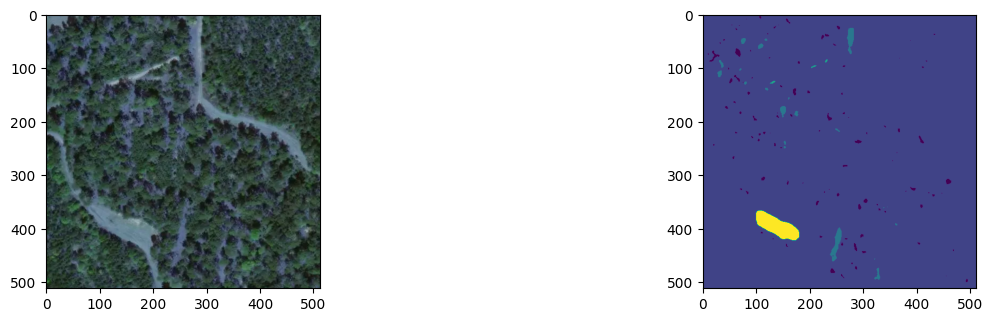

5
<class 'torch.Tensor'>
36704
51750


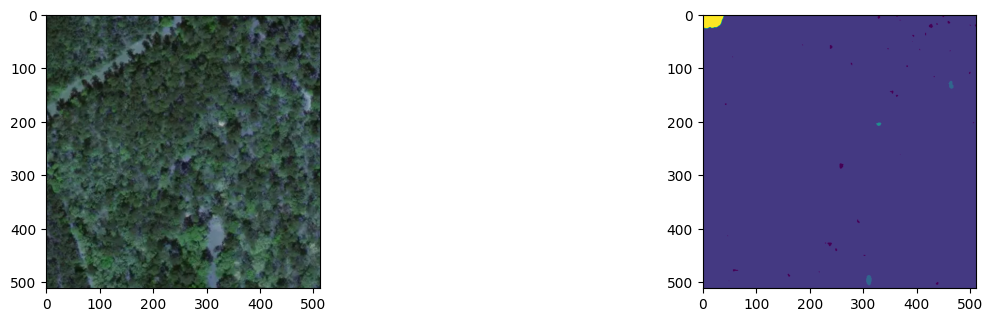

<class 'torch.Tensor'>
36704
51751


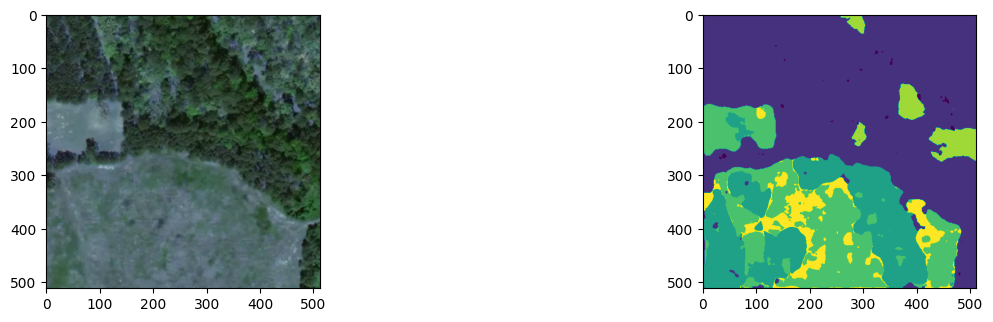

<class 'torch.Tensor'>
36704
51752


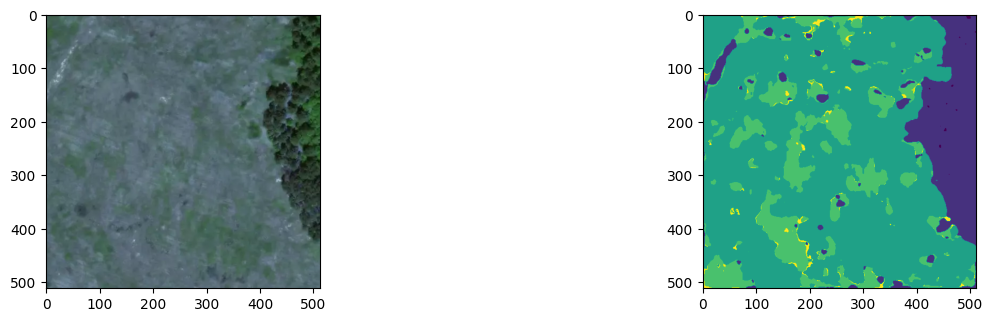

<class 'torch.Tensor'>
36704
51753


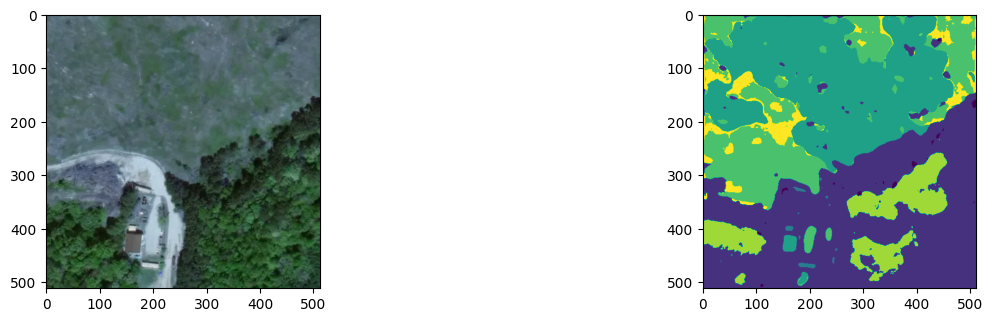

6
<class 'torch.Tensor'>
36704
51754


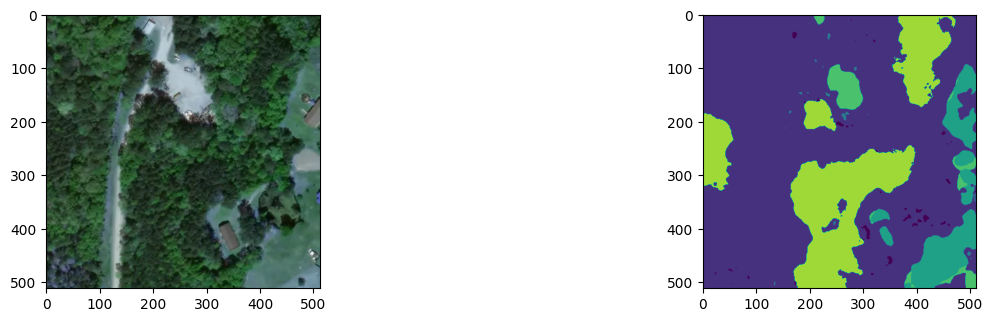

<class 'torch.Tensor'>
36704
51755


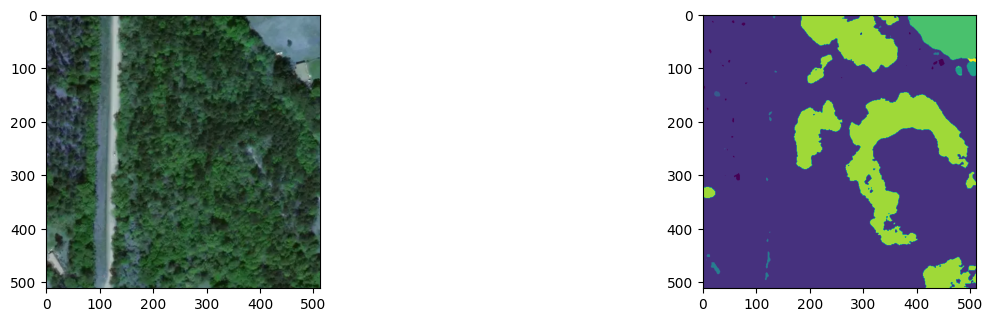

<class 'torch.Tensor'>
36704
51756


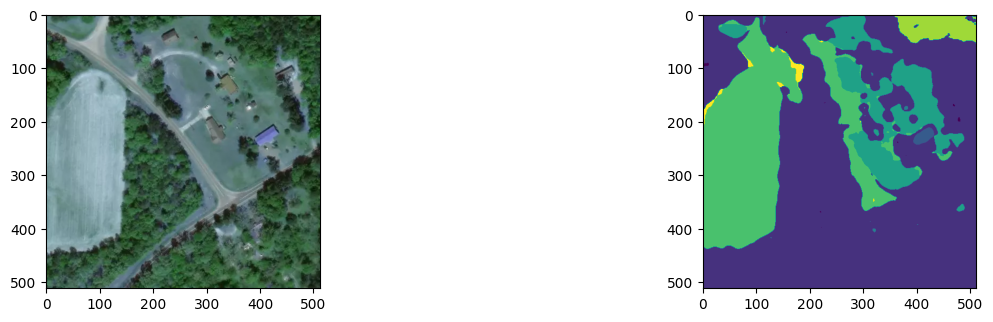

<class 'torch.Tensor'>
36704
51757


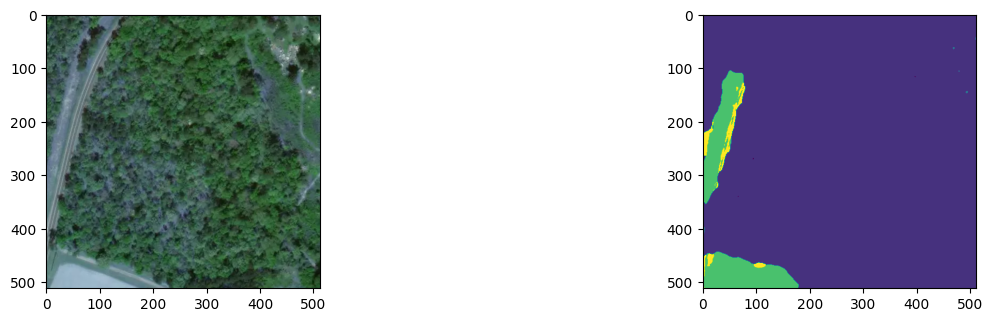

7
<class 'torch.Tensor'>
36704
51758


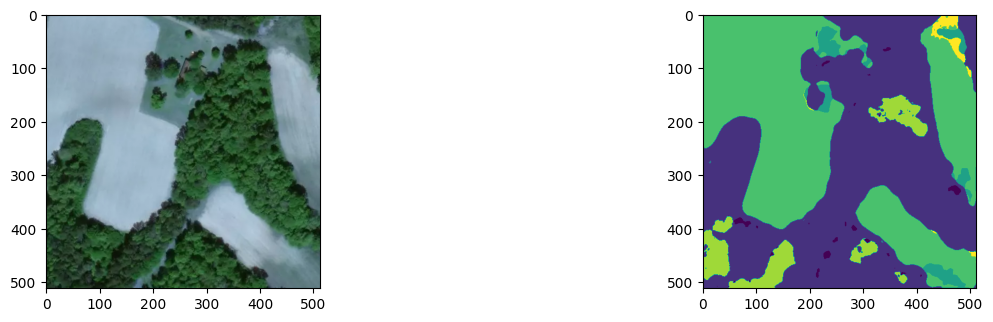

<class 'torch.Tensor'>
36704
51759


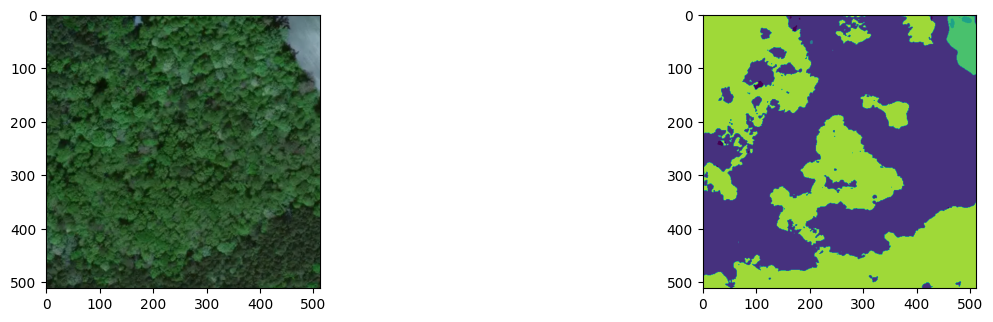

<class 'torch.Tensor'>
36704
51760


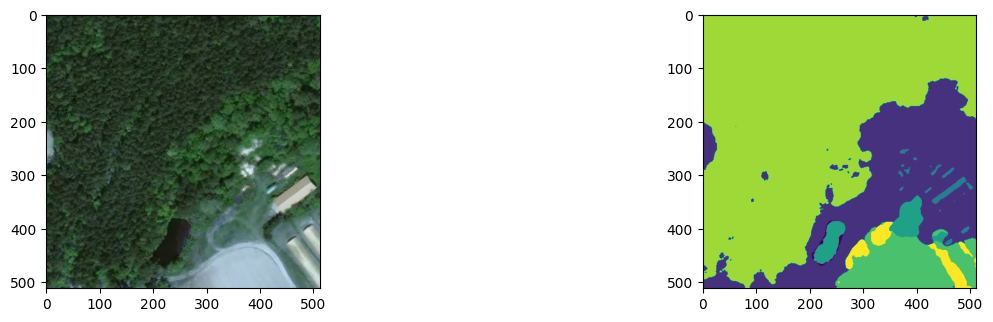

<class 'torch.Tensor'>
36704
51761


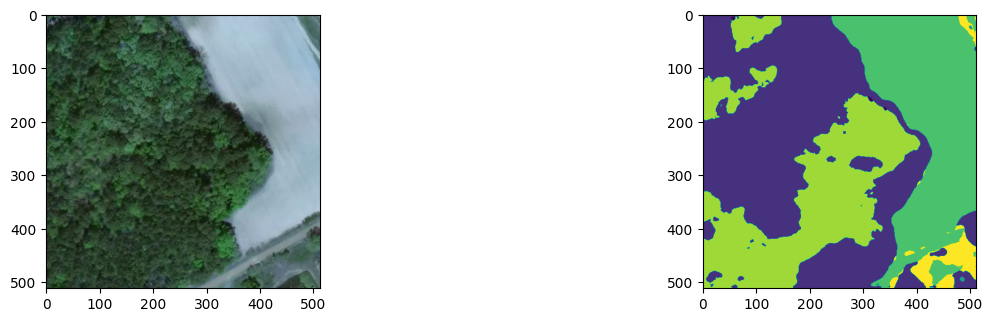

8
<class 'torch.Tensor'>
36704
51762


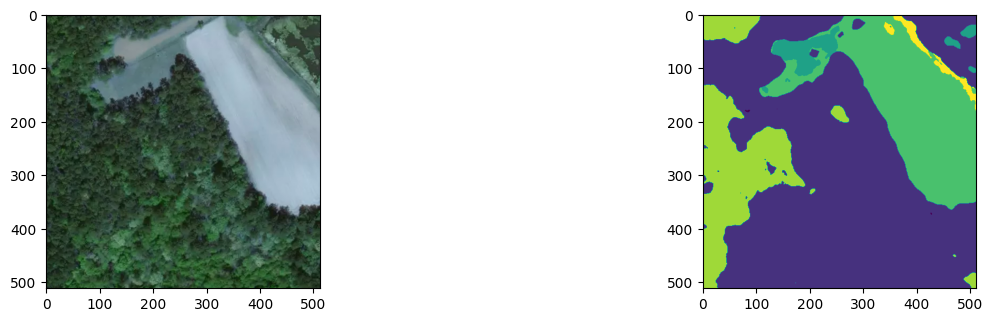

<class 'torch.Tensor'>
36704
51763


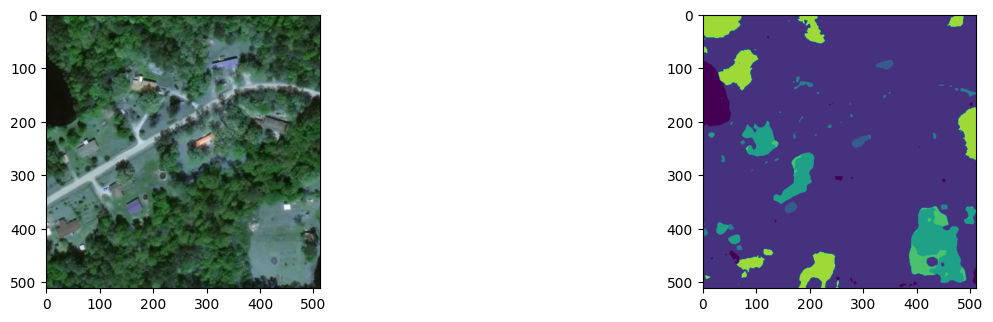

<class 'torch.Tensor'>
36704
51764


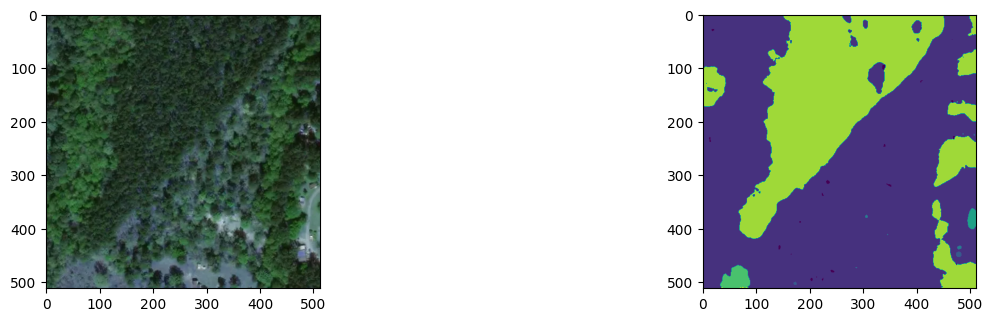

<class 'torch.Tensor'>
36704
51765


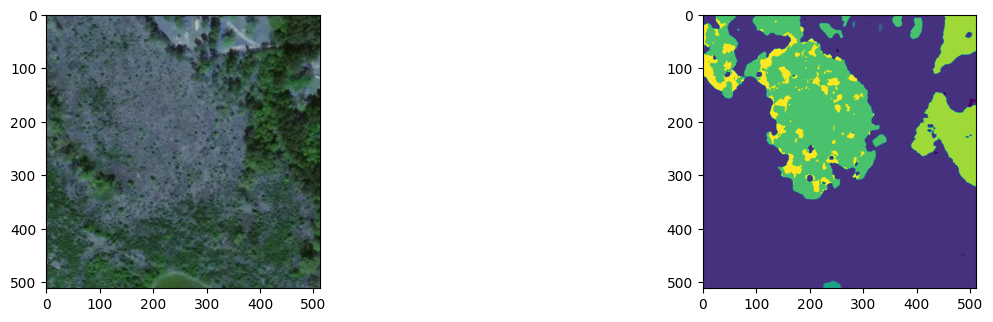

9
<class 'torch.Tensor'>
36705
51748


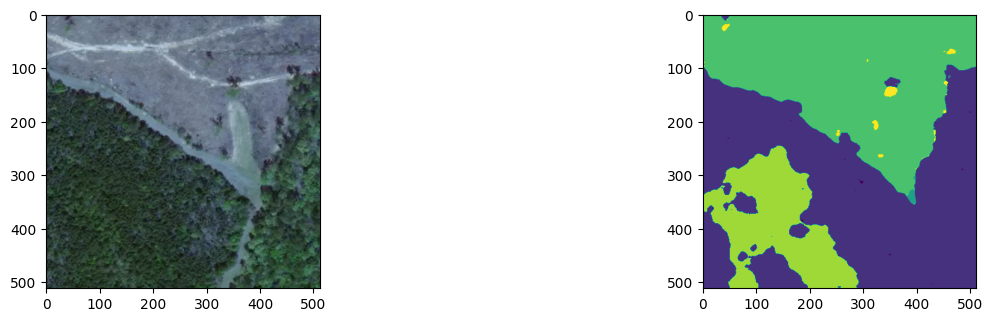

<class 'torch.Tensor'>
36705
51749


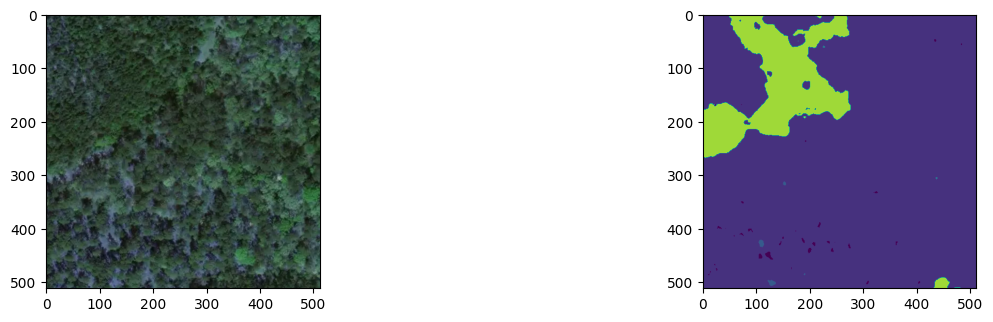

<class 'torch.Tensor'>
36705
51750


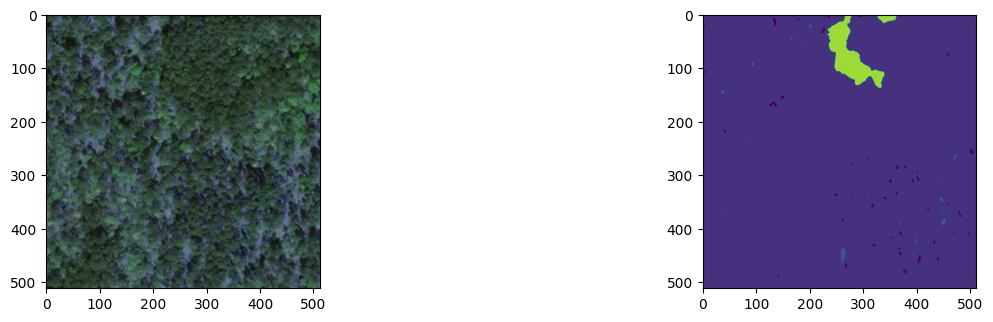

<class 'torch.Tensor'>
36705
51751


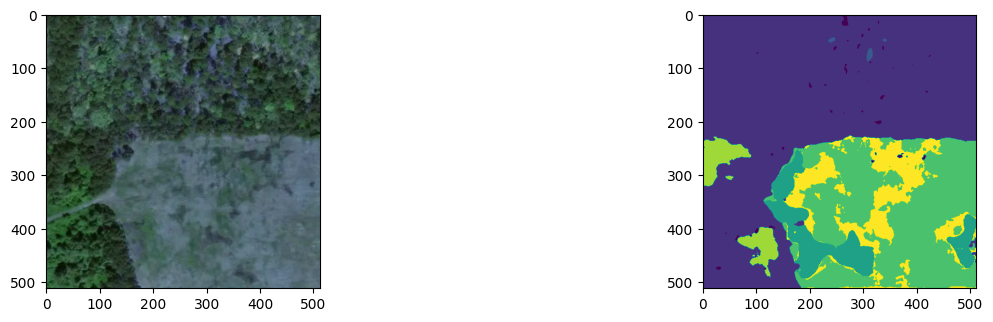

10
<class 'torch.Tensor'>
36705
51752


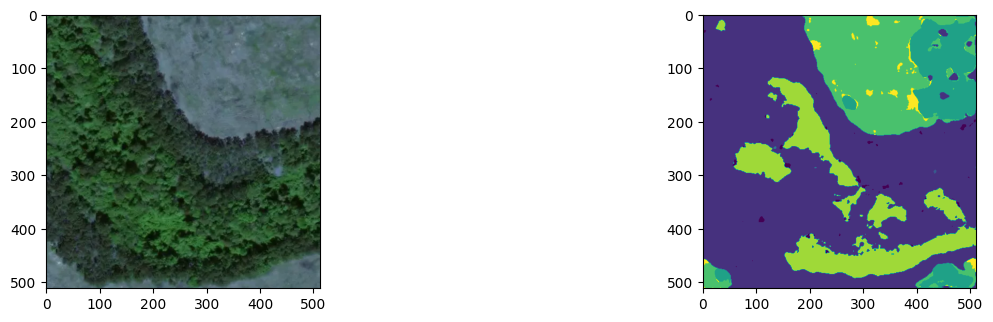

<class 'torch.Tensor'>
36705
51753


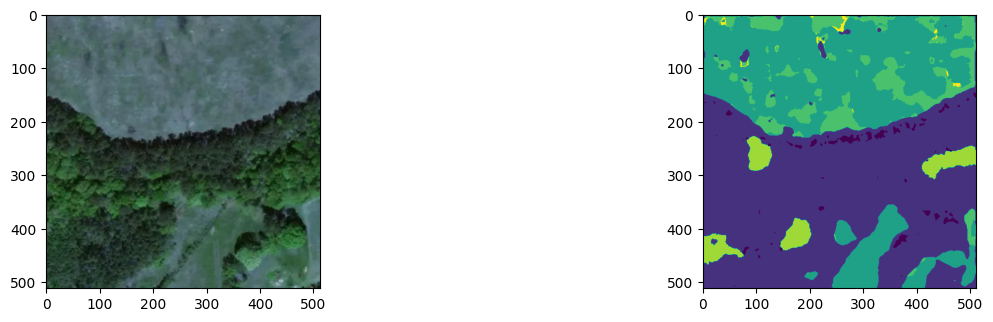

<class 'torch.Tensor'>
36705
51754


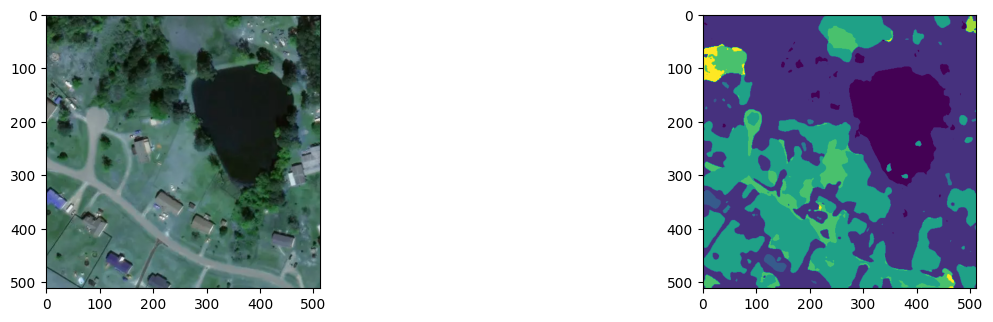

<class 'torch.Tensor'>
36705
51755


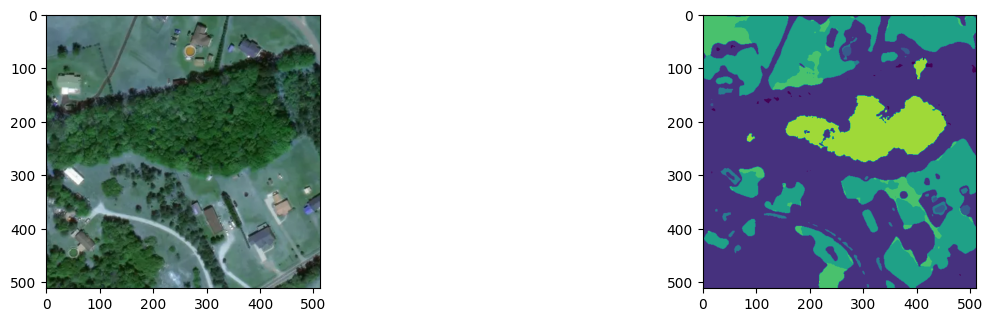

11
<class 'torch.Tensor'>
36705
51756


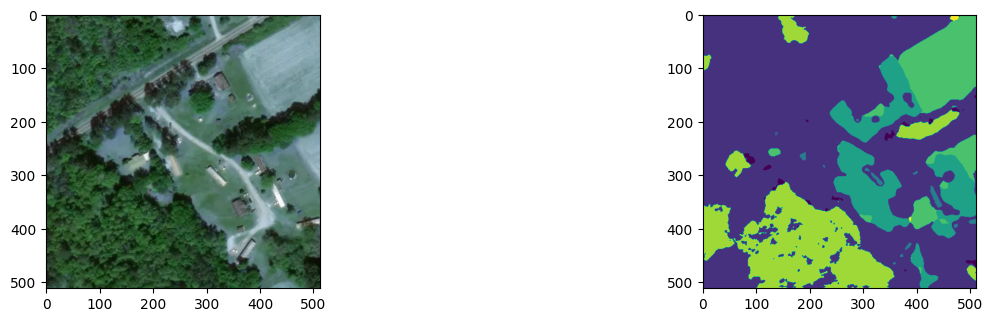

<class 'torch.Tensor'>
36705
51757


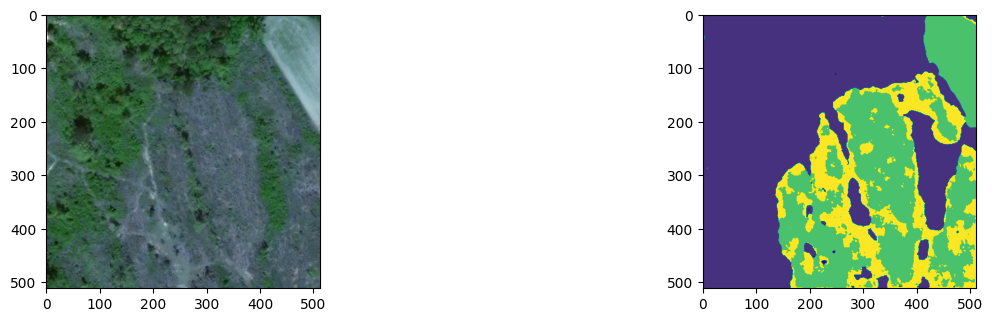

<class 'torch.Tensor'>
36705
51758


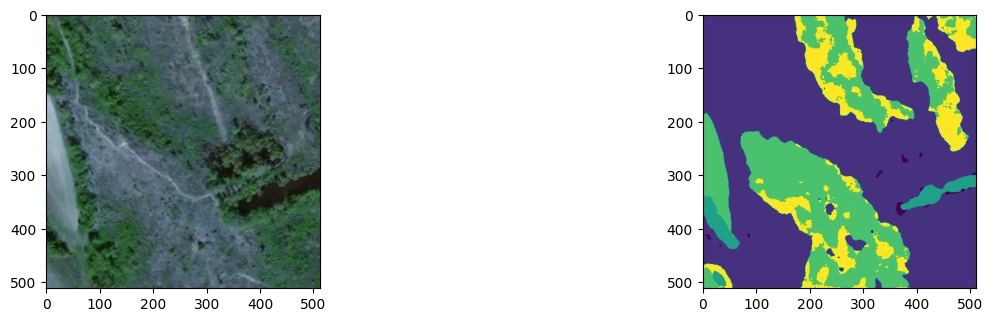

<class 'torch.Tensor'>
36705
51759


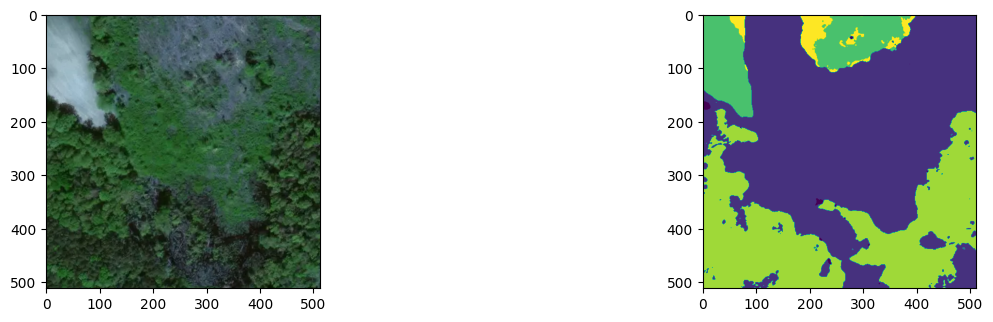

12
<class 'torch.Tensor'>
36705
51760


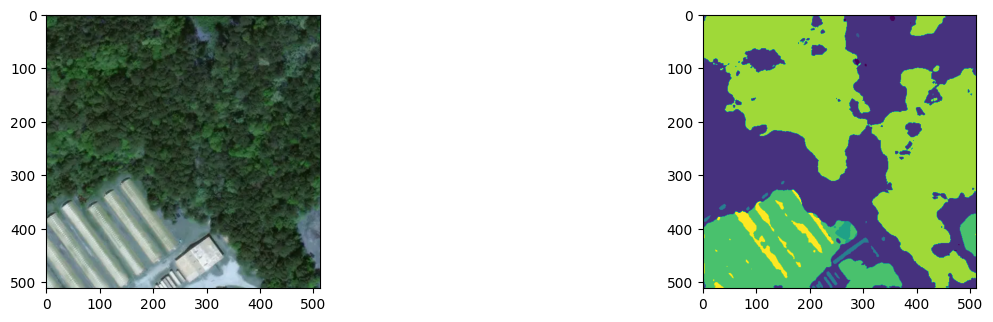

<class 'torch.Tensor'>
36705
51761


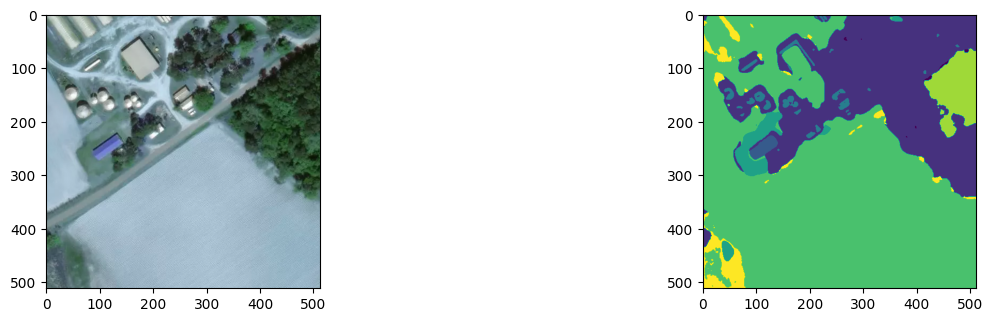

<class 'torch.Tensor'>
36705
51762


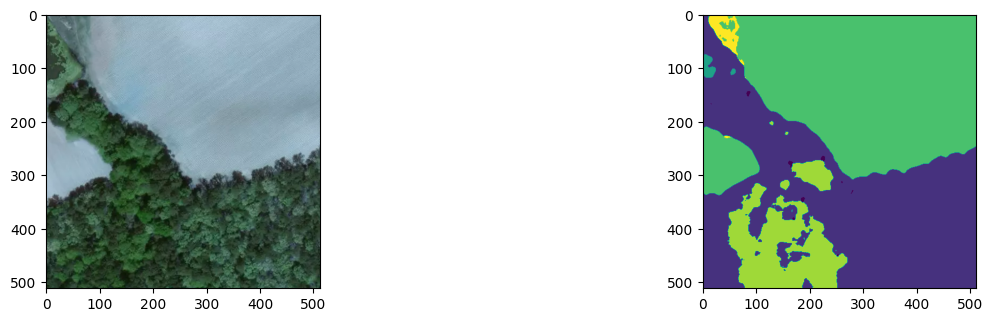

<class 'torch.Tensor'>
36705
51763


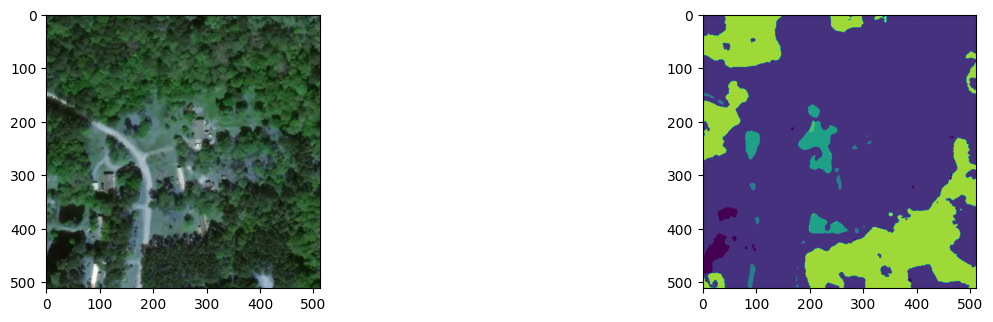

13
<class 'torch.Tensor'>
36705
51764


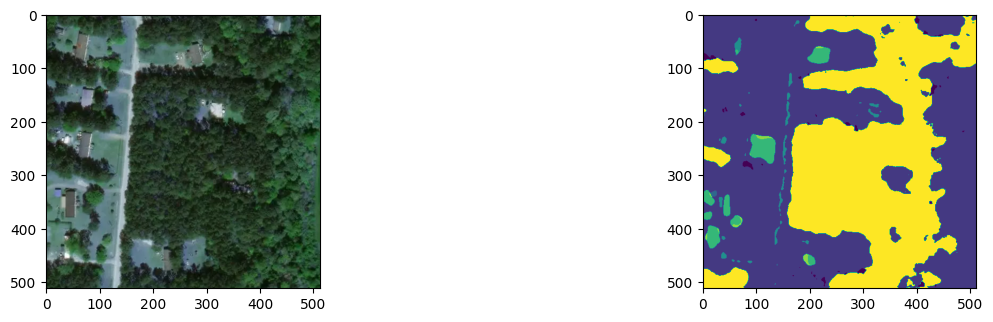

<class 'torch.Tensor'>
36705
51765


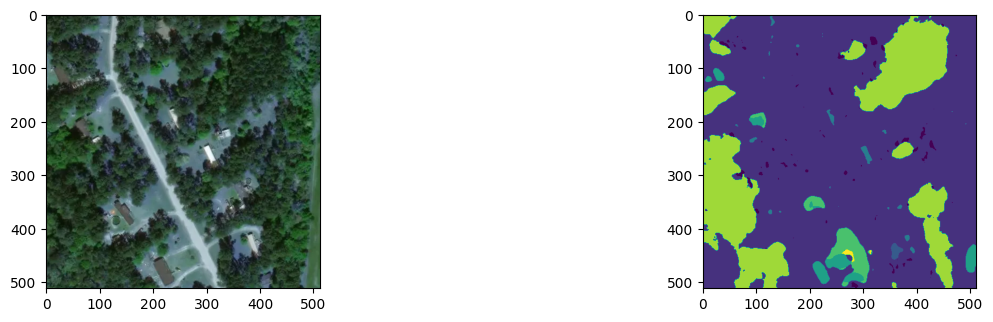

<class 'torch.Tensor'>
36706
51748


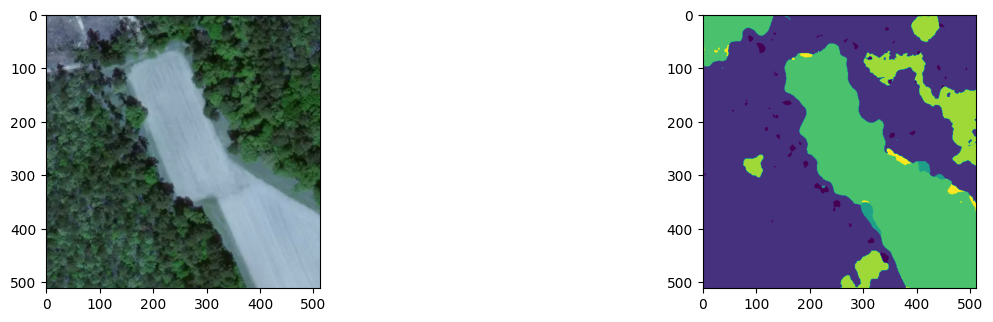

<class 'torch.Tensor'>
36706
51749


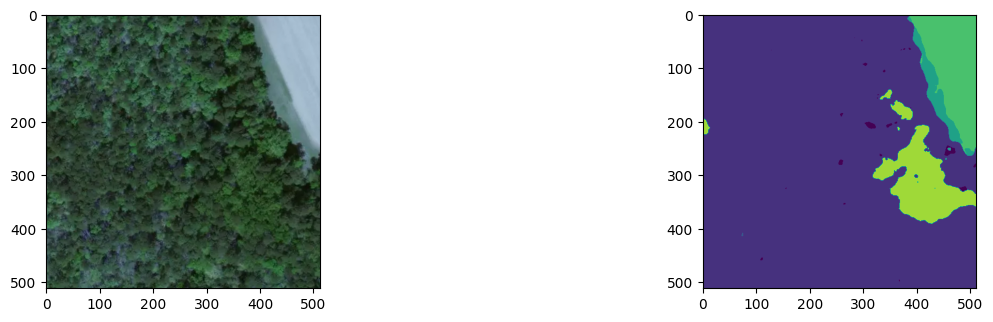

14
<class 'torch.Tensor'>
36706
51750


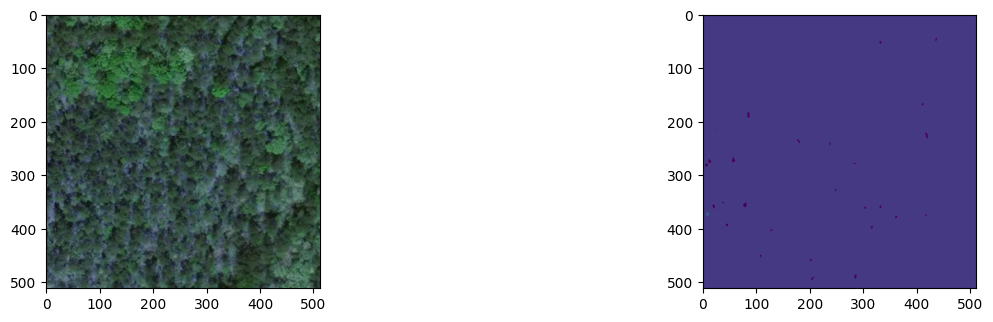

<class 'torch.Tensor'>
36706
51751


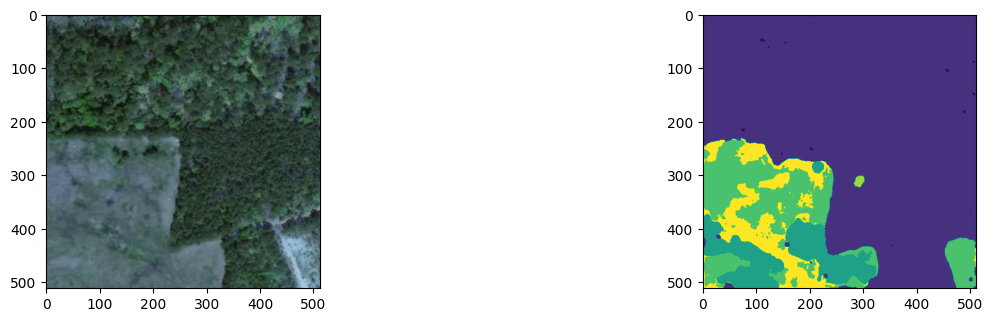

<class 'torch.Tensor'>
36706
51752


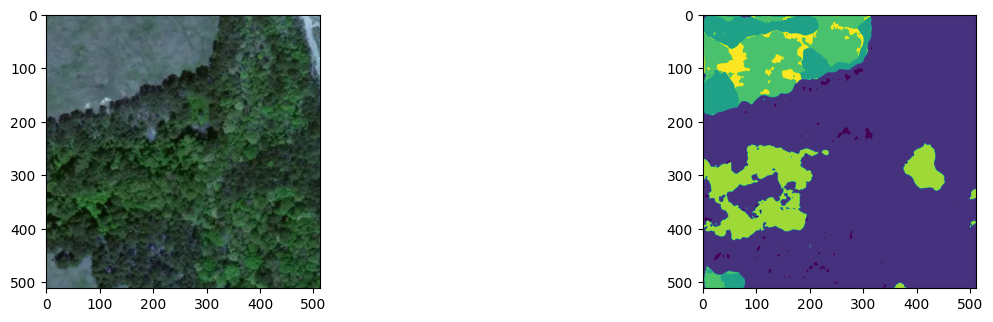

<class 'torch.Tensor'>
36706
51753


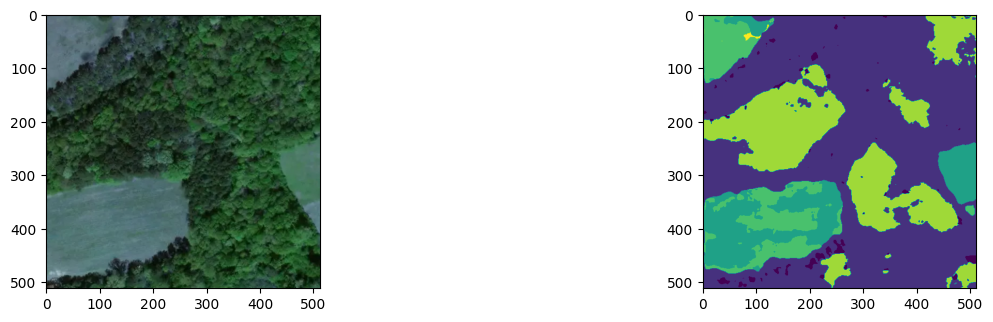

15
<class 'torch.Tensor'>
36706
51754


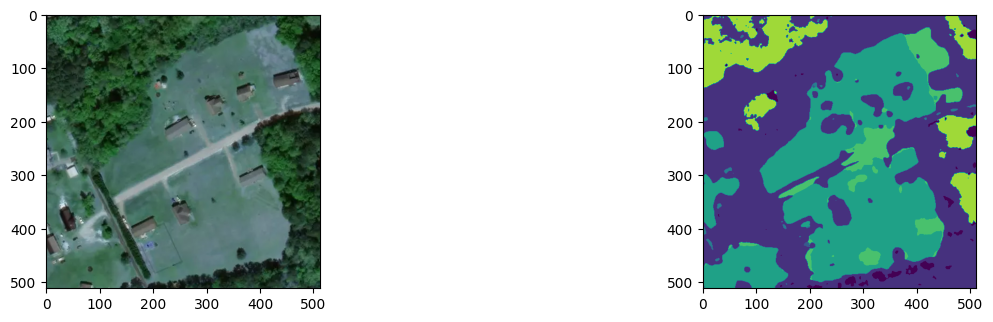

<class 'torch.Tensor'>
36706
51755


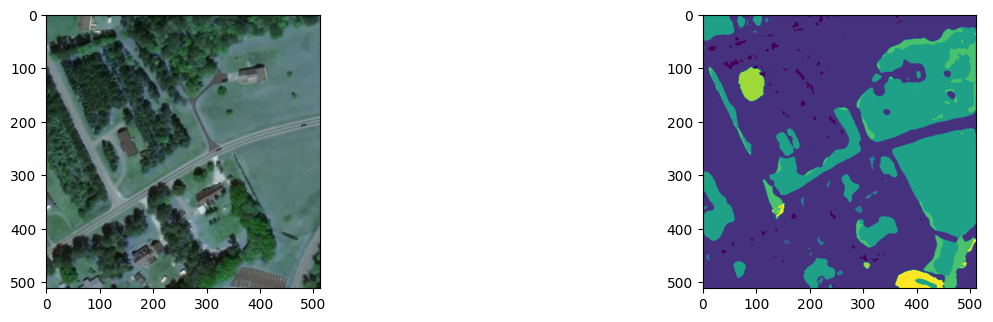

<class 'torch.Tensor'>
36706
51756


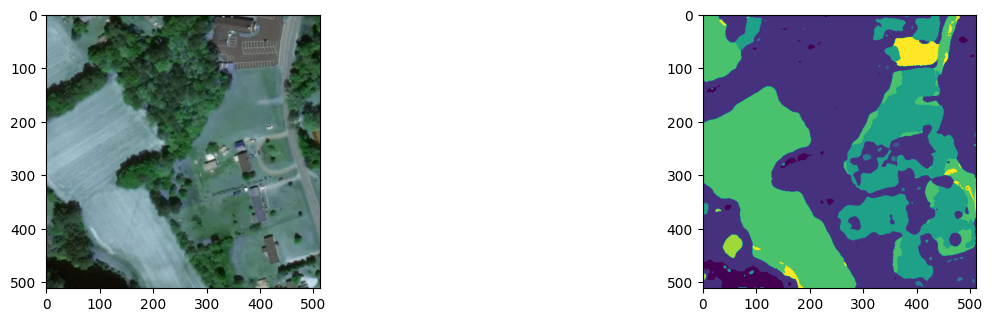

<class 'torch.Tensor'>
36706
51757


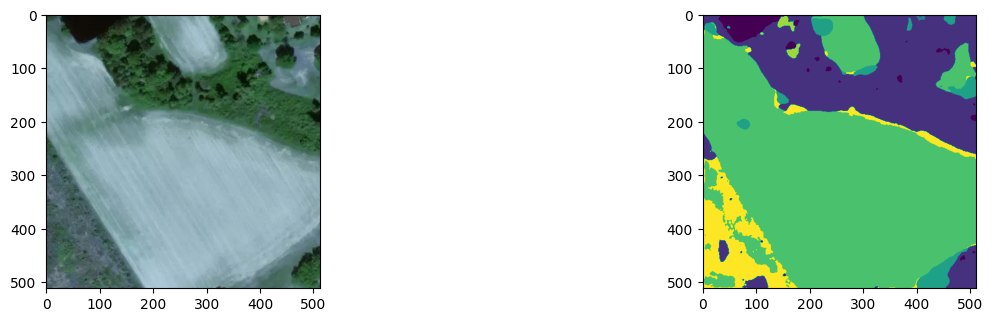

16
<class 'torch.Tensor'>
36706
51758


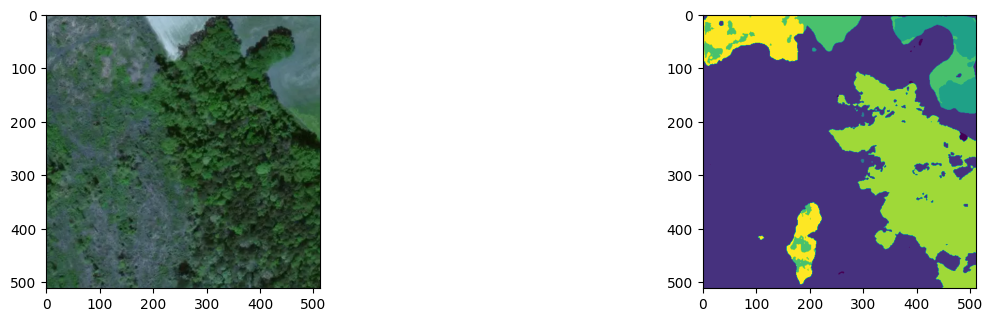

<class 'torch.Tensor'>
36706
51759


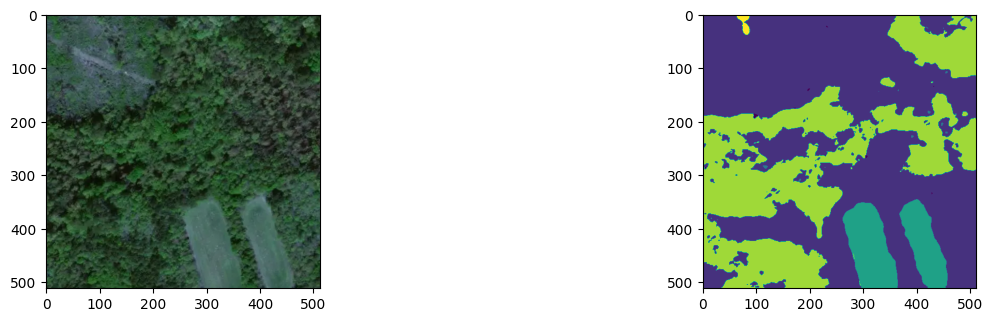

<class 'torch.Tensor'>
36706
51760


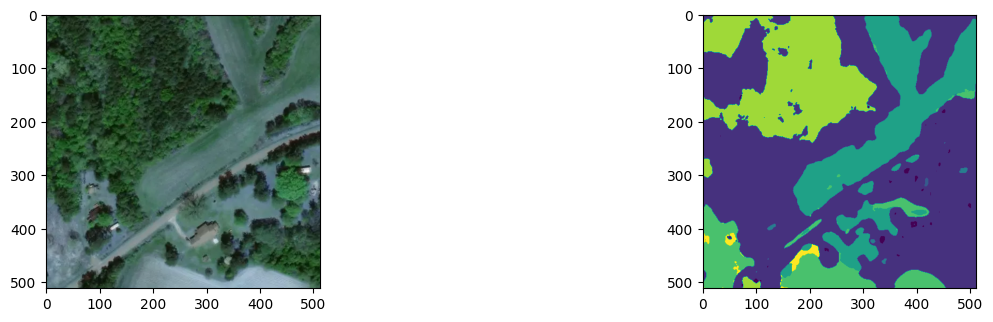

<class 'torch.Tensor'>
36706
51761


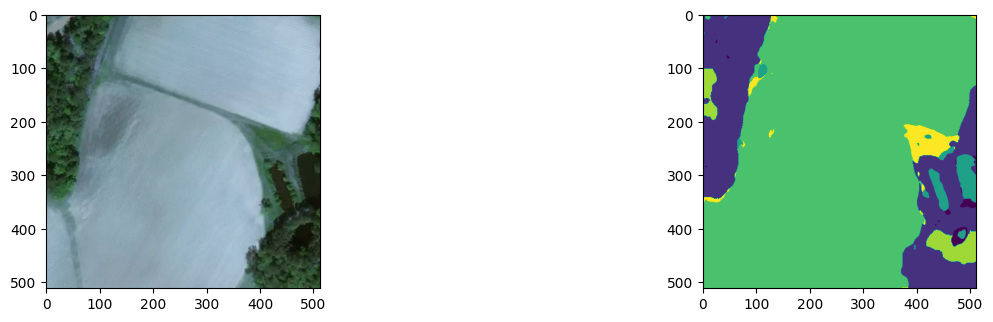

17
<class 'torch.Tensor'>
36706
51762


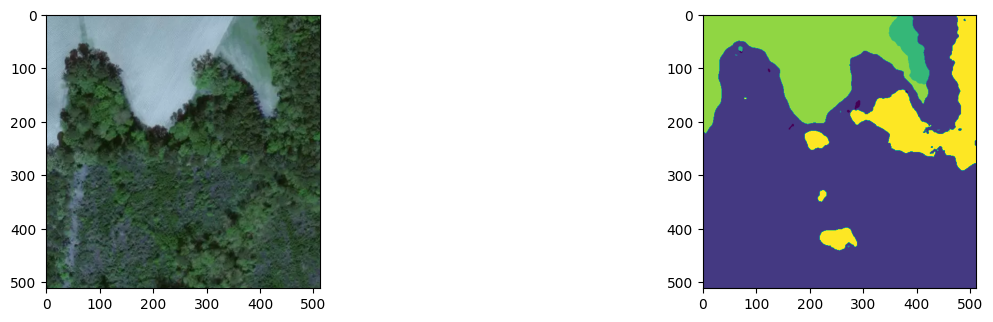

<class 'torch.Tensor'>
36706
51763


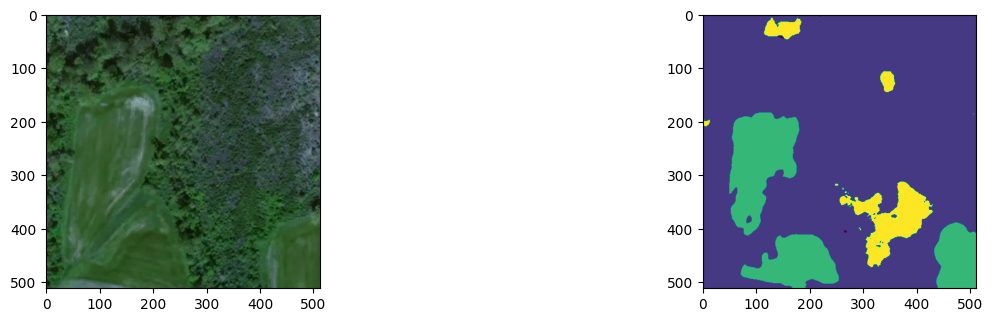

<class 'torch.Tensor'>
36706
51764


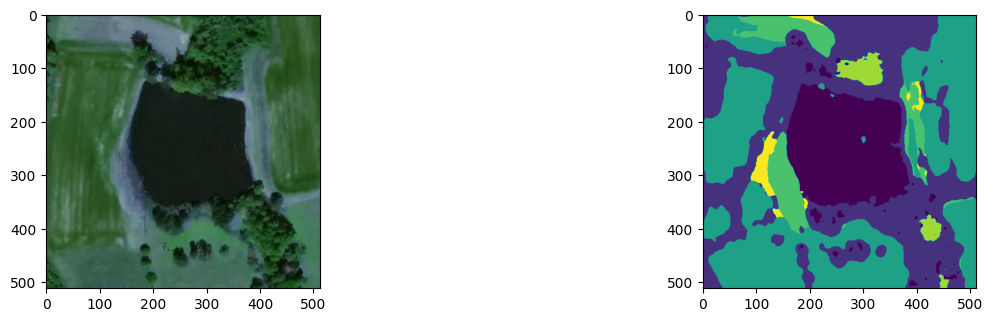

<class 'torch.Tensor'>
36706
51765


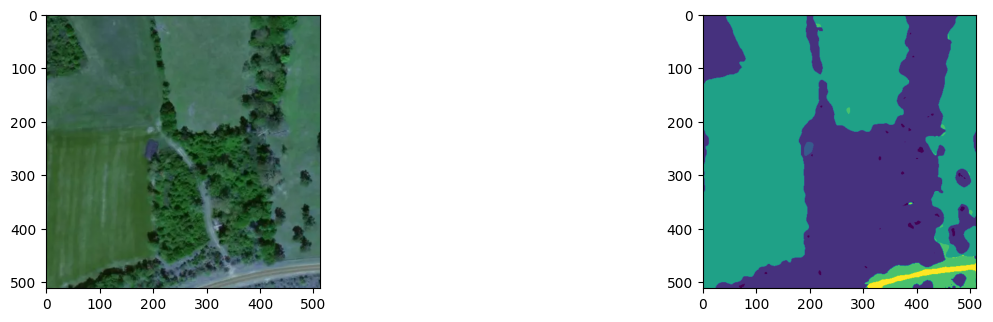

18
<class 'torch.Tensor'>
36707
51748


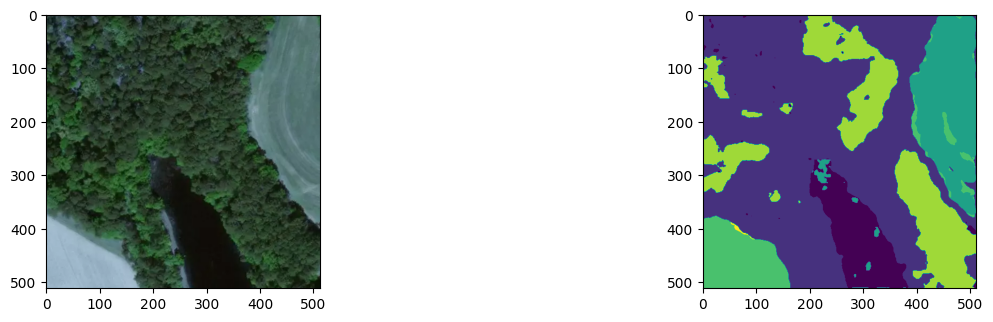

<class 'torch.Tensor'>
36707
51749


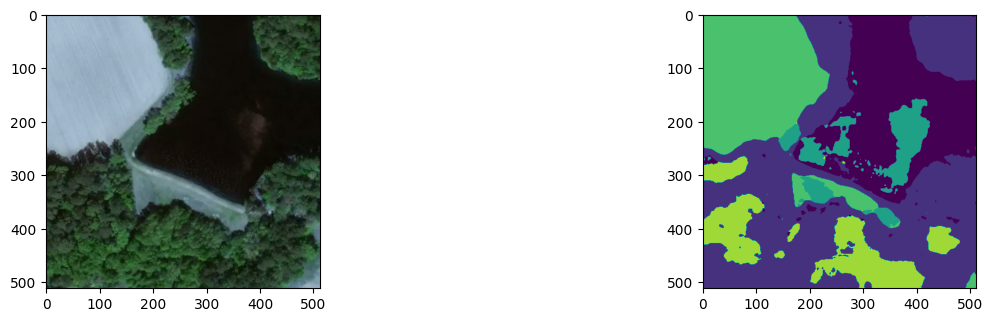

<class 'torch.Tensor'>
36707
51750


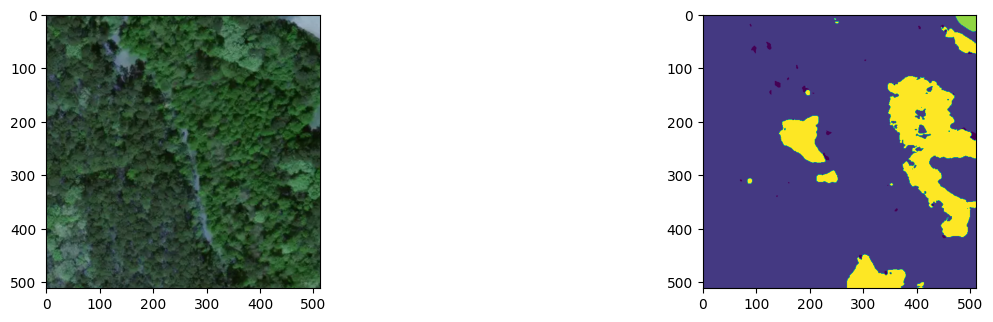

<class 'torch.Tensor'>
36707
51751


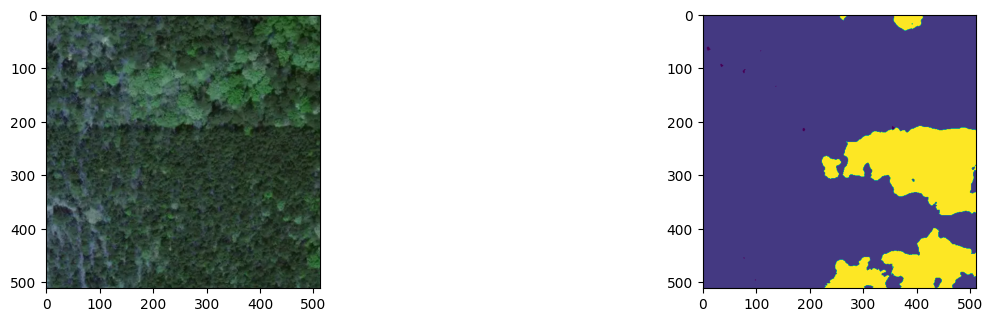

19
<class 'torch.Tensor'>
36707
51752


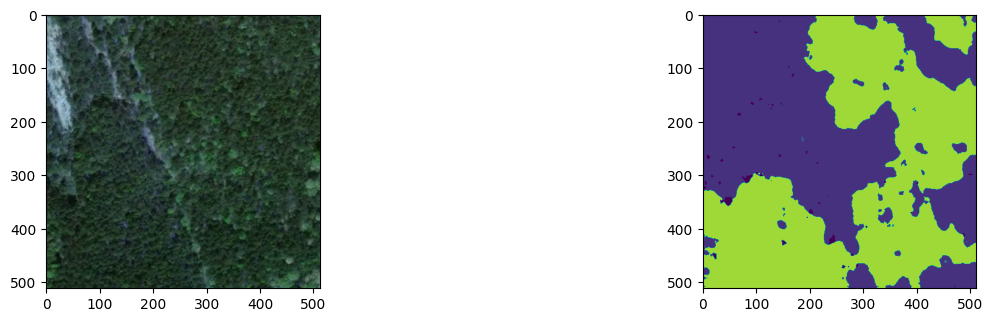

<class 'torch.Tensor'>
36707
51753


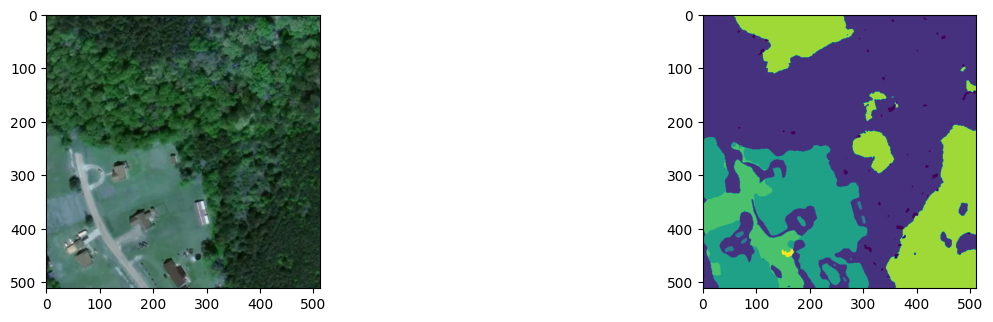

<class 'torch.Tensor'>
36707
51754


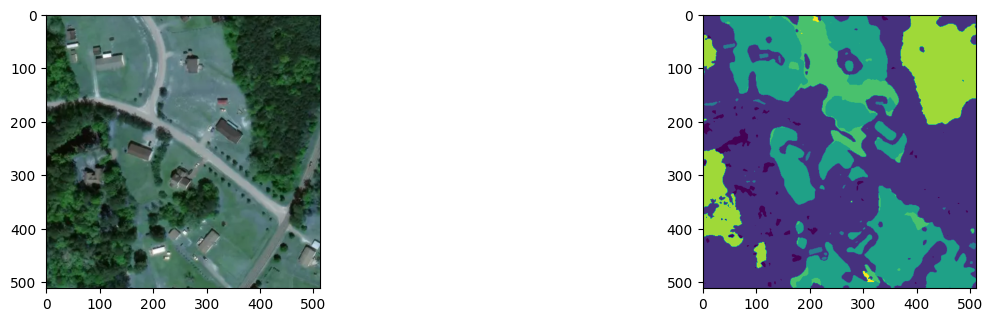

<class 'torch.Tensor'>
36707
51755


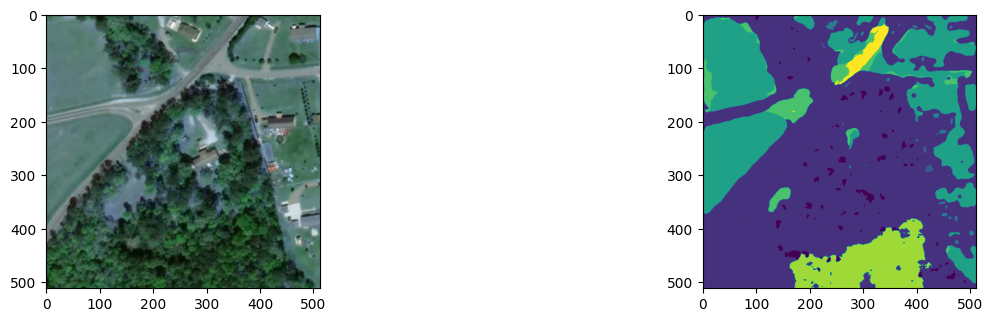

20
<class 'torch.Tensor'>
36707
51756


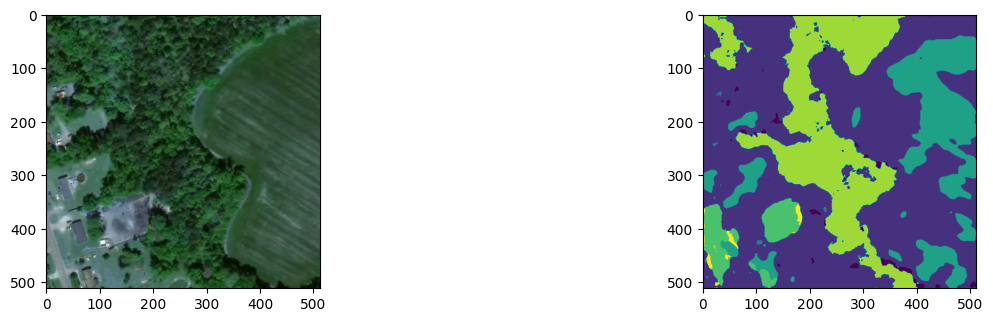

<class 'torch.Tensor'>
36707
51757


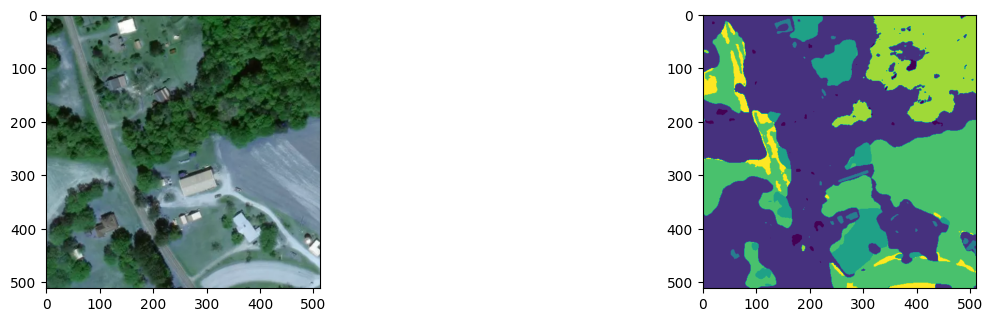

<class 'torch.Tensor'>
36707
51758


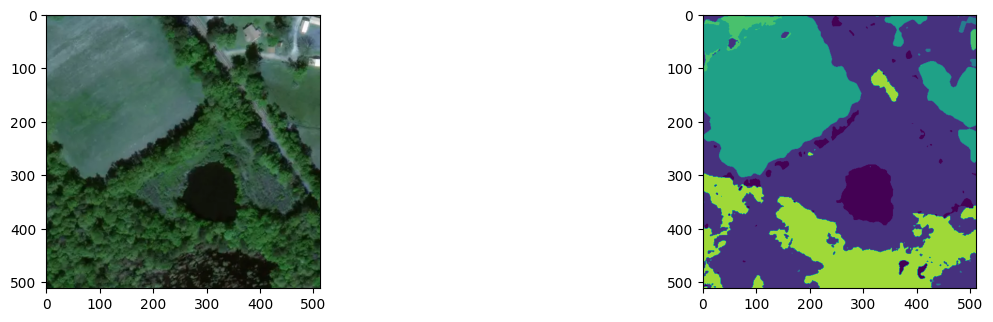

<class 'torch.Tensor'>
36707
51759


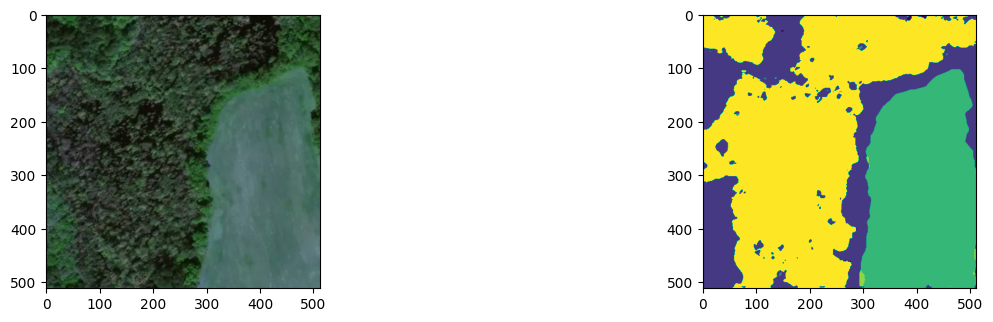

21
<class 'torch.Tensor'>
36707
51760


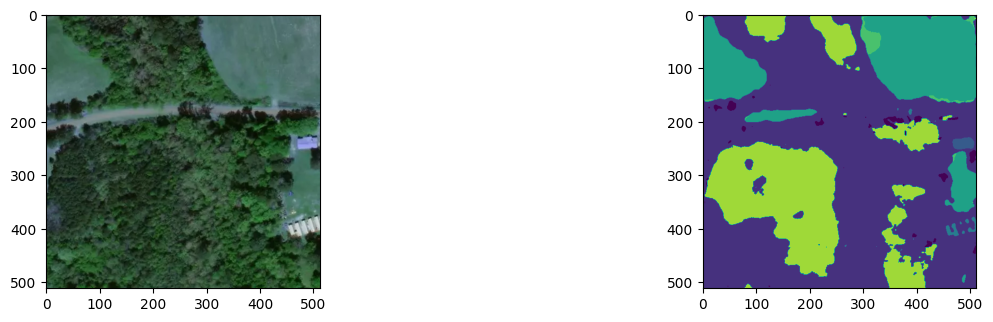

<class 'torch.Tensor'>
36707
51761


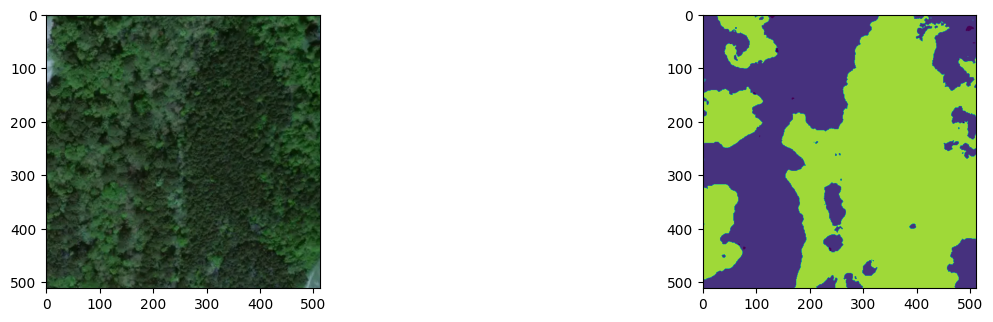

<class 'torch.Tensor'>
36707
51762


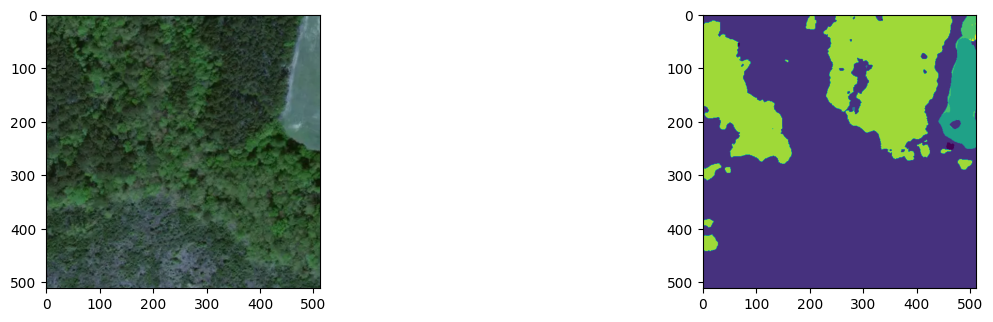

<class 'torch.Tensor'>
36707
51763


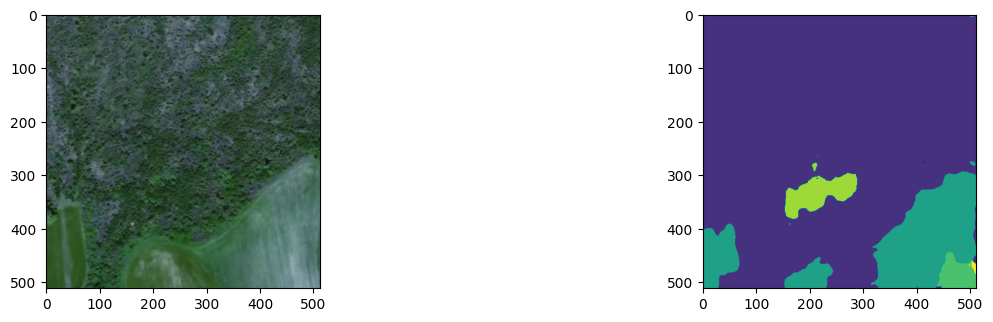

22
<class 'torch.Tensor'>
36707
51764


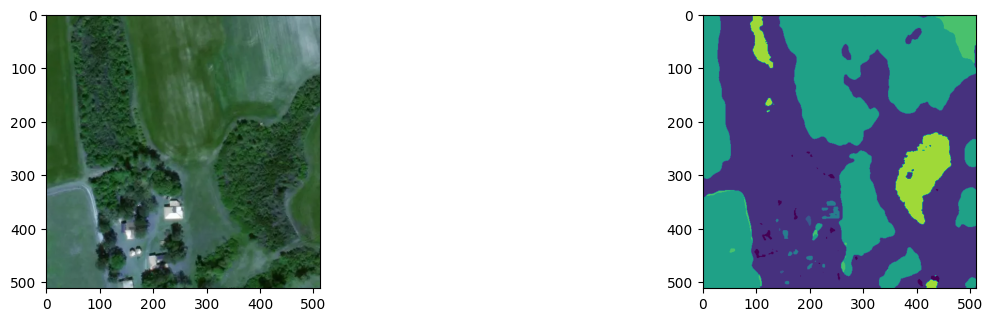

<class 'torch.Tensor'>
36707
51765


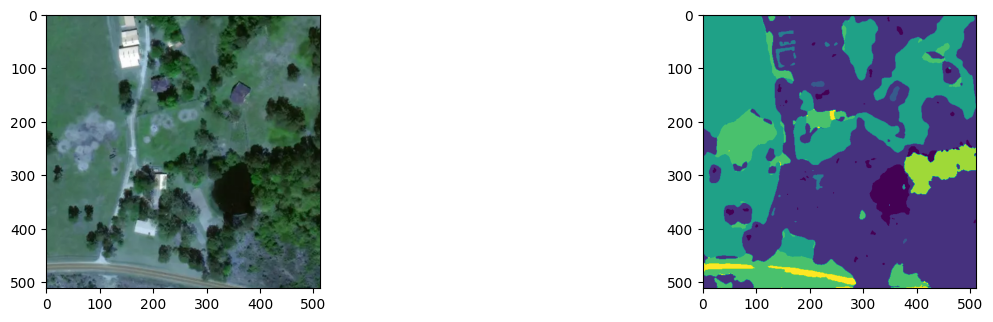

<class 'torch.Tensor'>
36708
51748


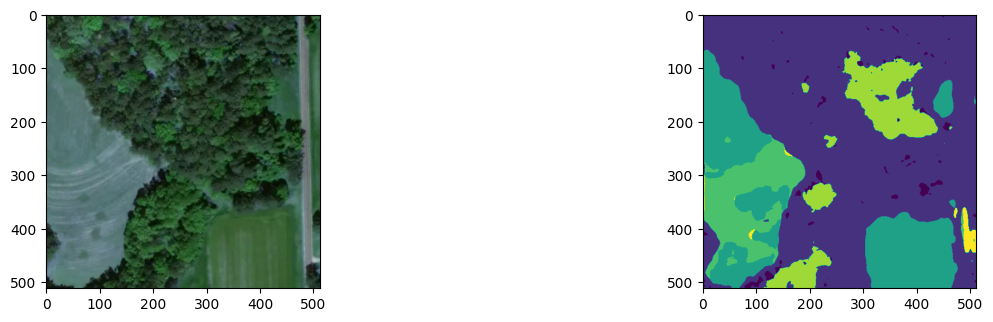

<class 'torch.Tensor'>
36708
51749


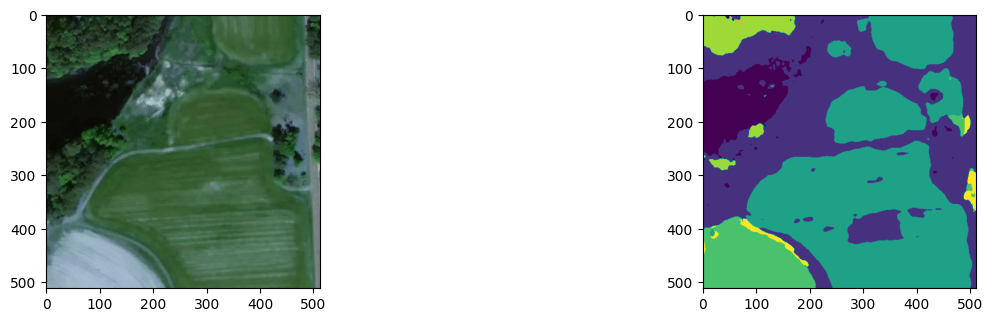

23
<class 'torch.Tensor'>
36708
51750


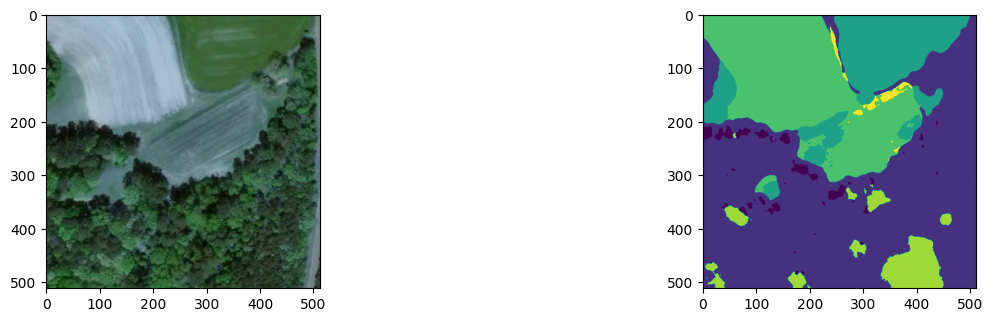

<class 'torch.Tensor'>
36708
51751


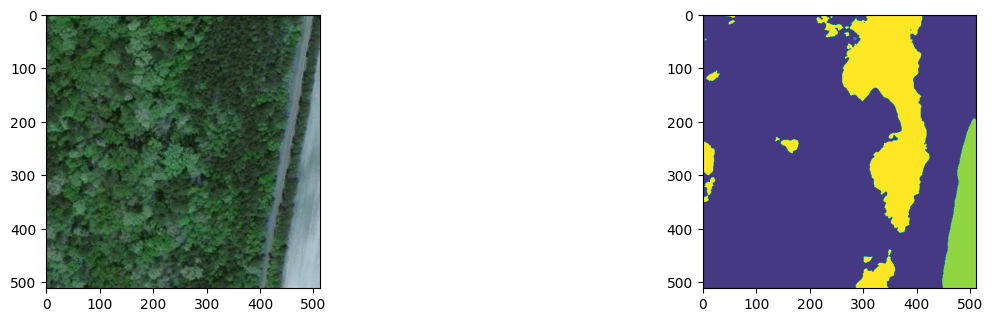

<class 'torch.Tensor'>
36708
51752


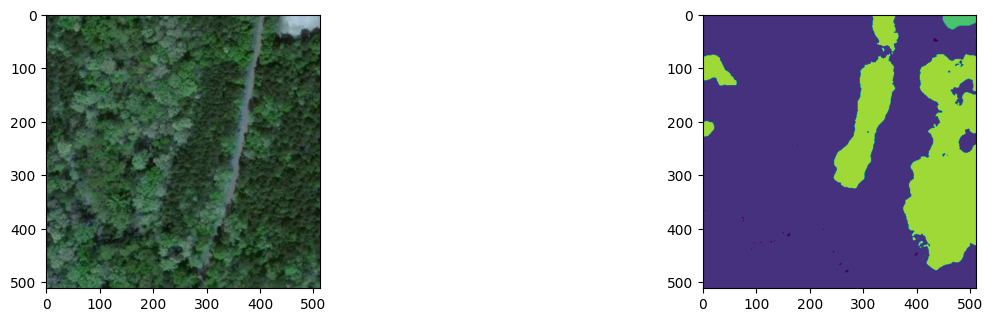

<class 'torch.Tensor'>
36708
51753


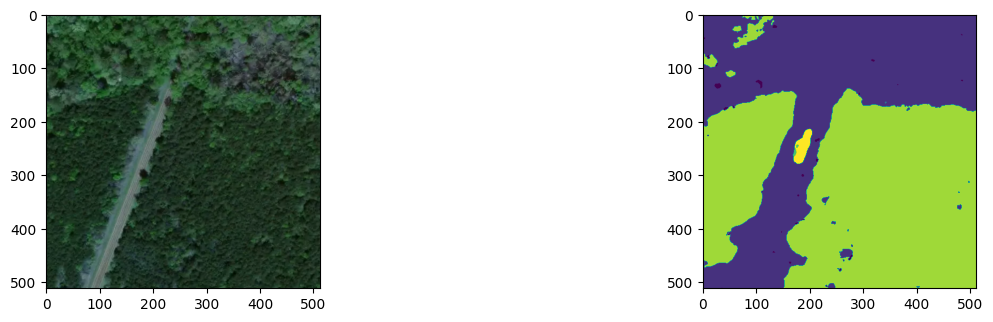

24
<class 'torch.Tensor'>
36708
51754


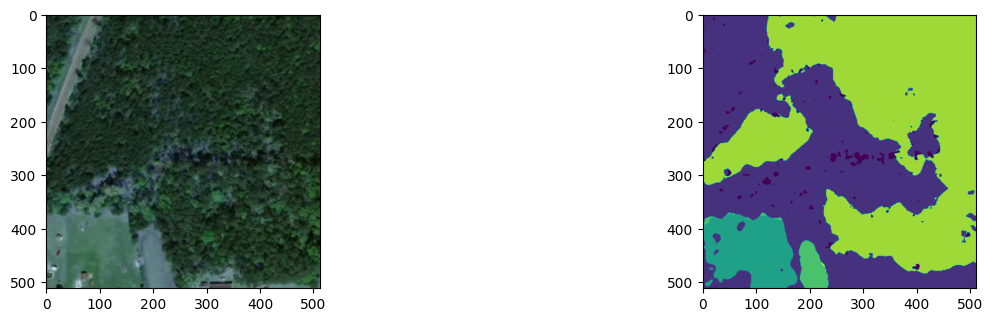

<class 'torch.Tensor'>
36708
51755


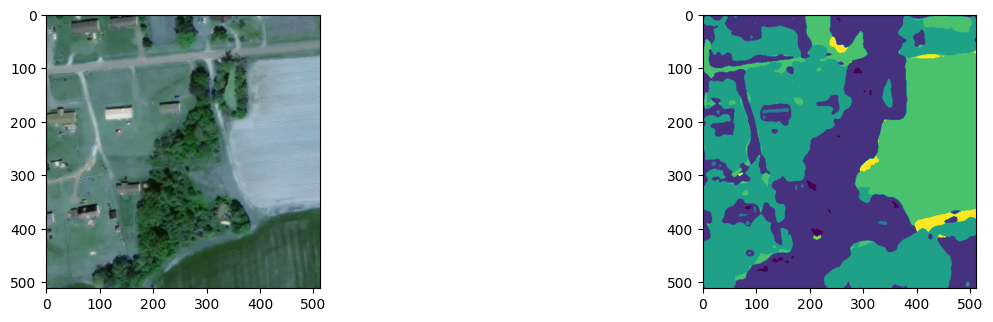

<class 'torch.Tensor'>
36708
51756


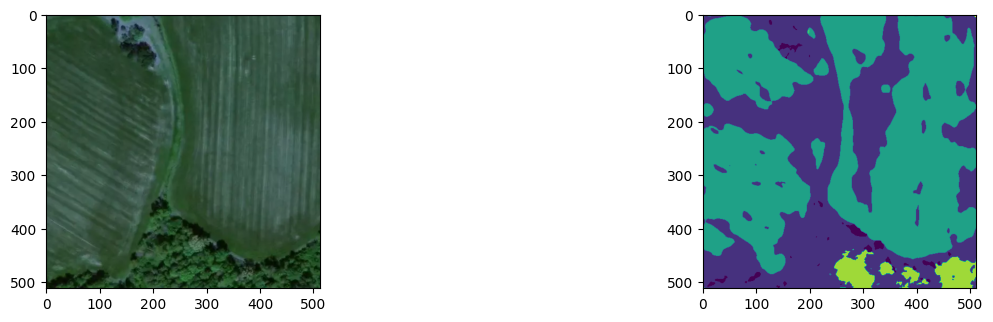

<class 'torch.Tensor'>
36708
51757


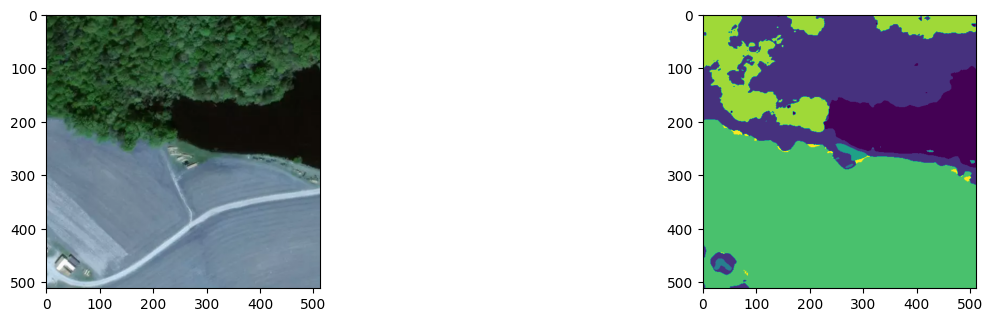

25
<class 'torch.Tensor'>
36708
51758


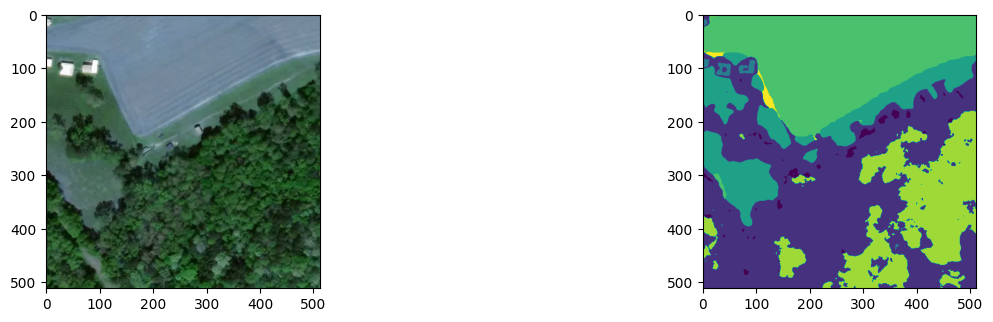

<class 'torch.Tensor'>
36708
51759


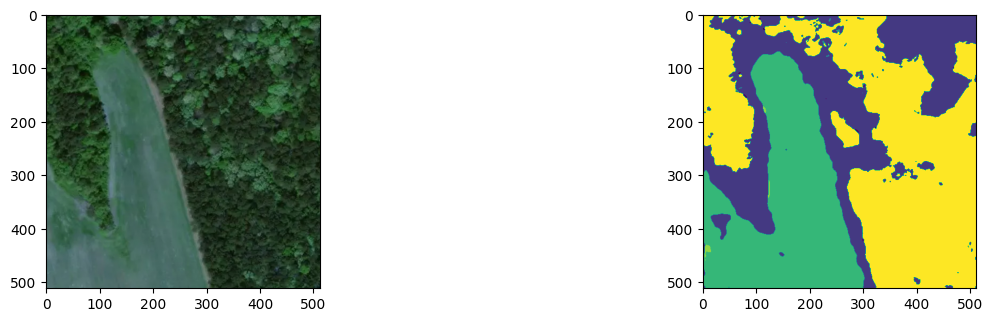

<class 'torch.Tensor'>
36708
51760


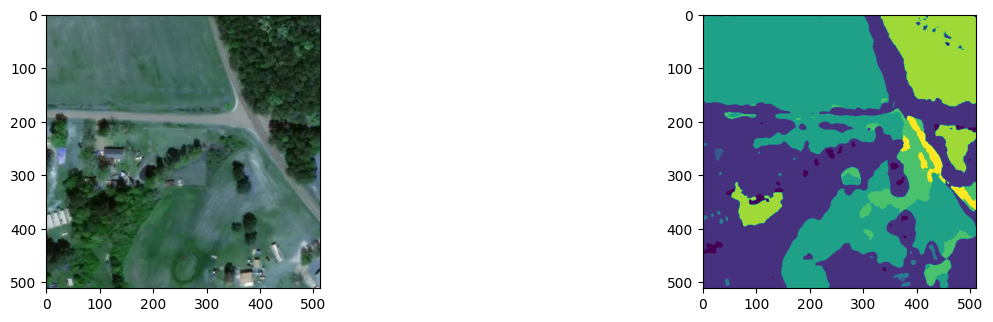

<class 'torch.Tensor'>
36708
51761


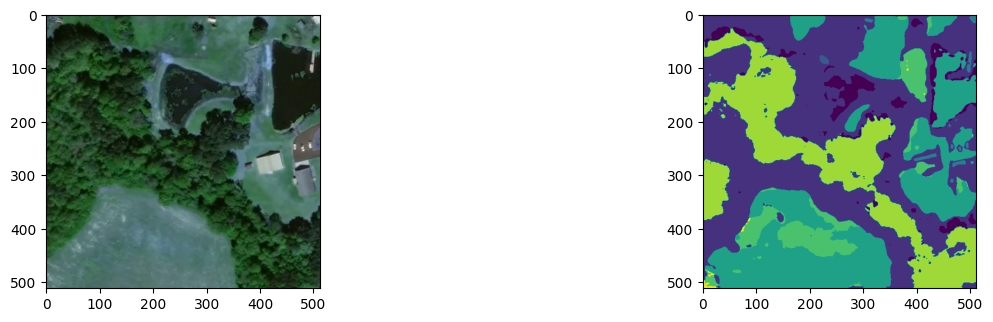

26
<class 'torch.Tensor'>
36708
51762


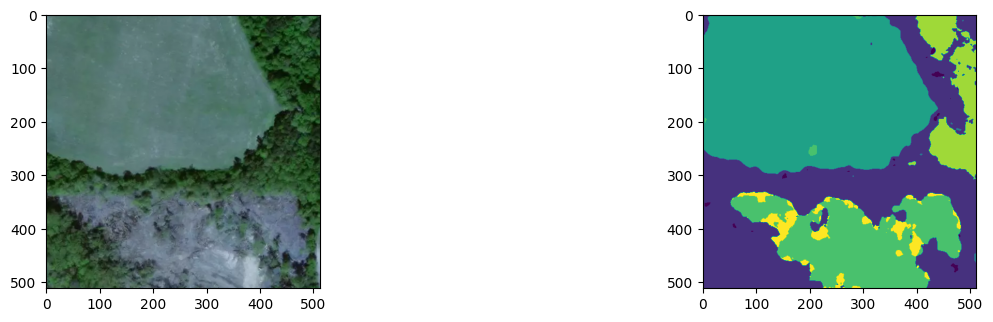

<class 'torch.Tensor'>
36708
51763


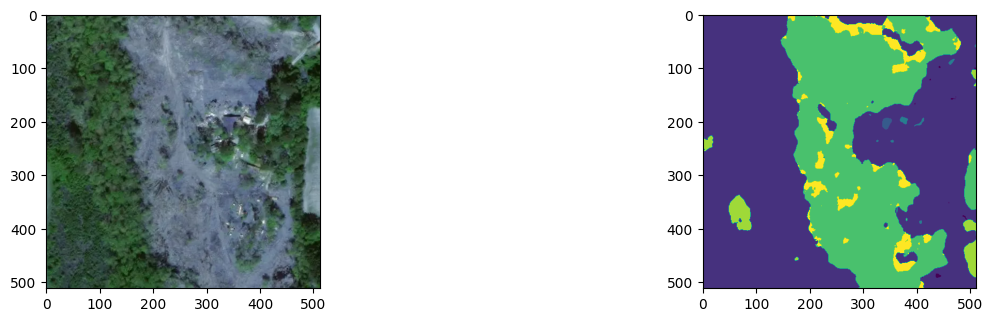

<class 'torch.Tensor'>
36708
51764


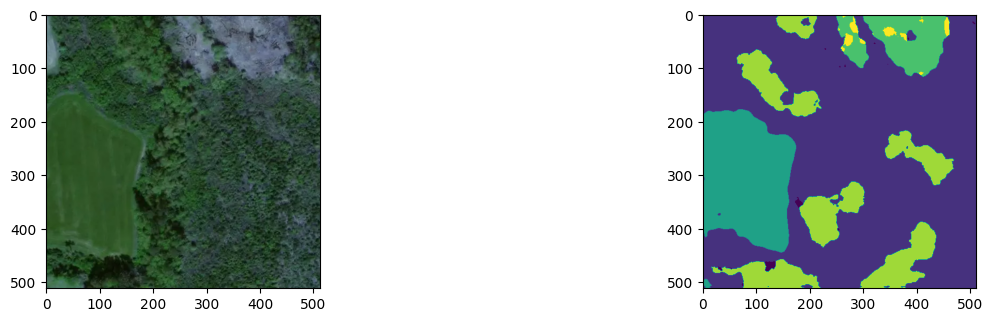

<class 'torch.Tensor'>
36708
51765


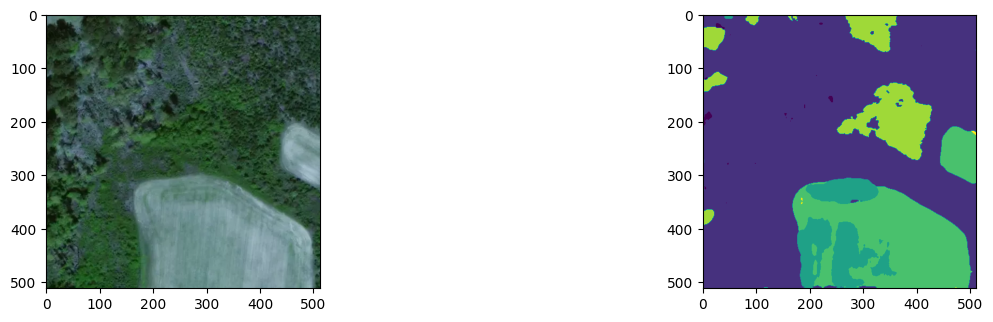

27
<class 'torch.Tensor'>
36709
51748


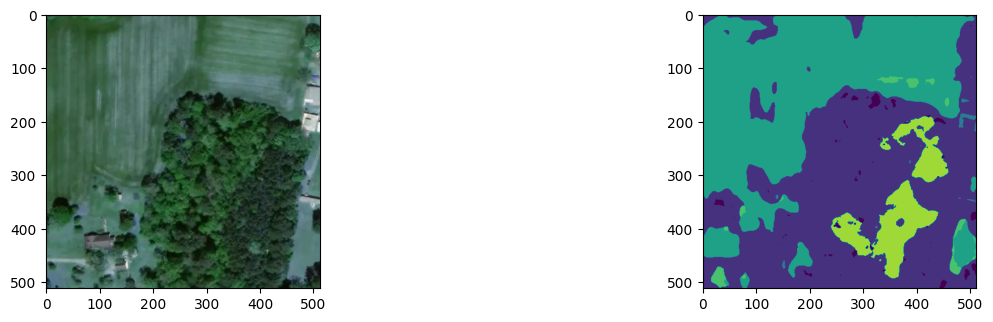

<class 'torch.Tensor'>
36709
51749


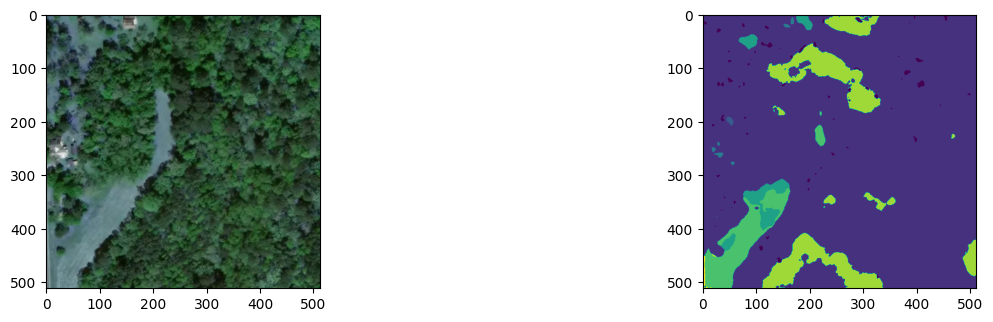

<class 'torch.Tensor'>
36709
51750


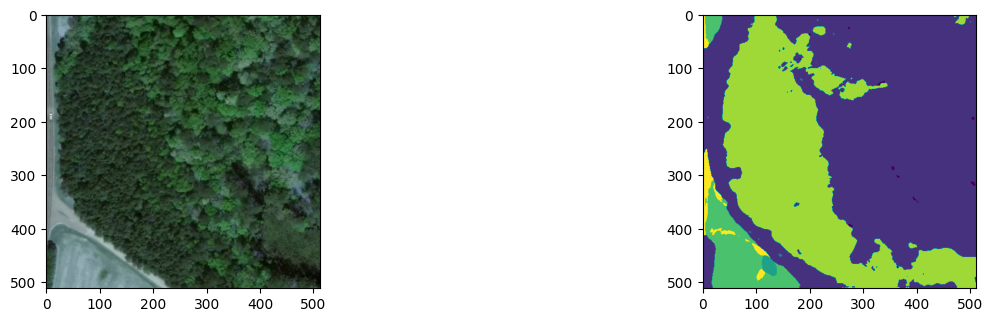

<class 'torch.Tensor'>
36709
51751


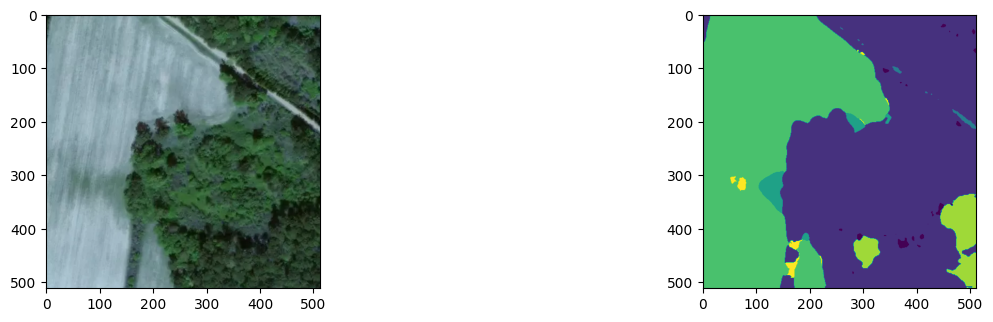

28
<class 'torch.Tensor'>
36709
51752


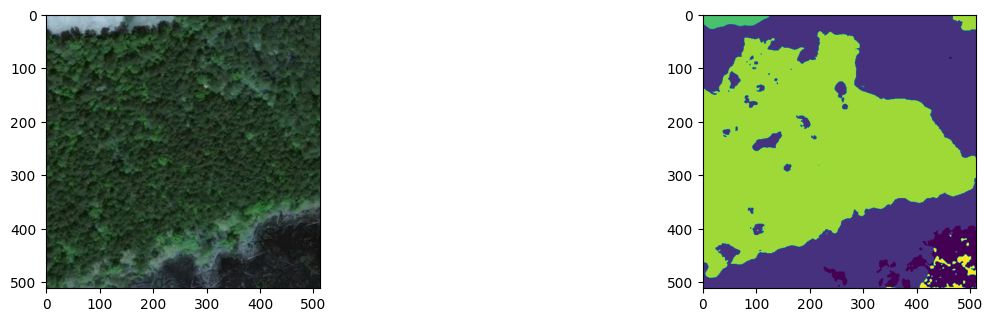

<class 'torch.Tensor'>
36709
51753


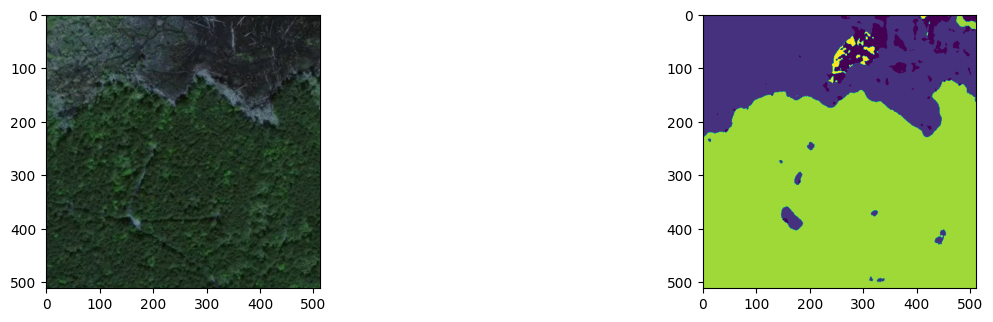

<class 'torch.Tensor'>
36709
51754


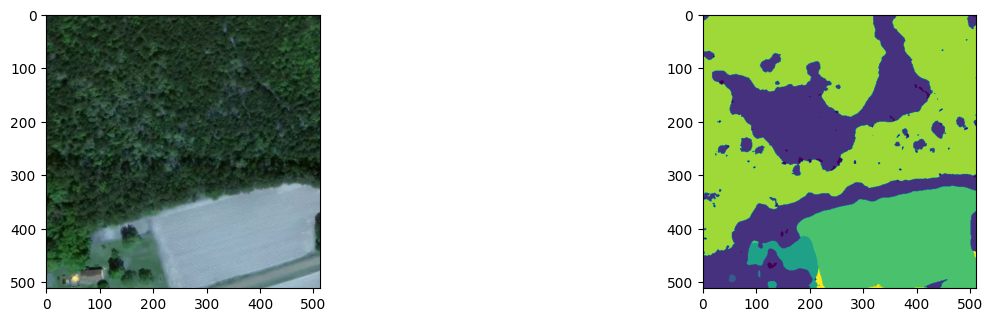

<class 'torch.Tensor'>
36709
51755


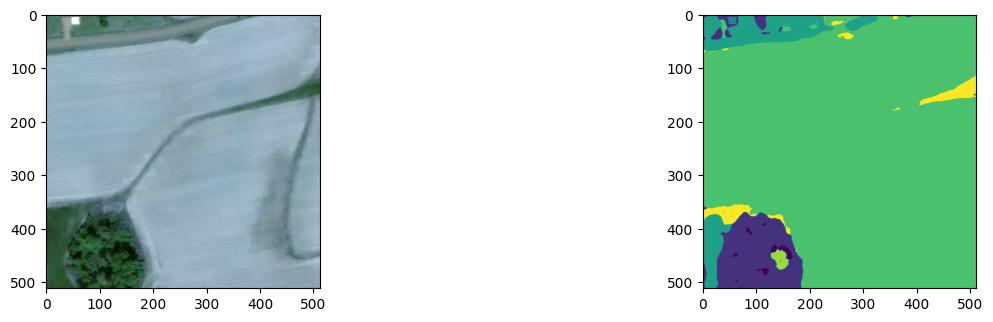

29
<class 'torch.Tensor'>
36709
51756


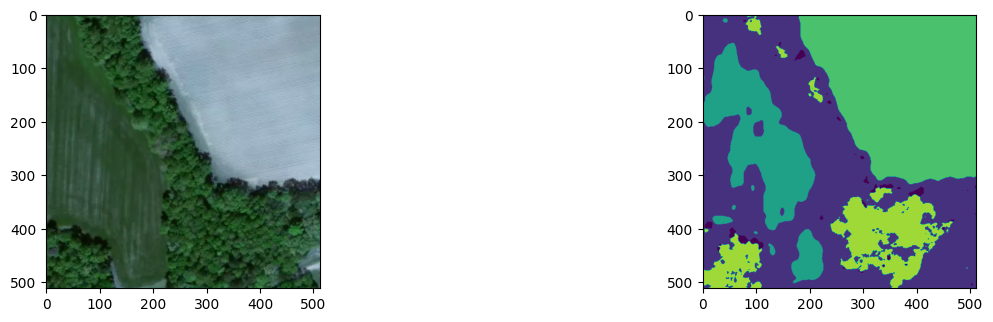

<class 'torch.Tensor'>
36709
51757


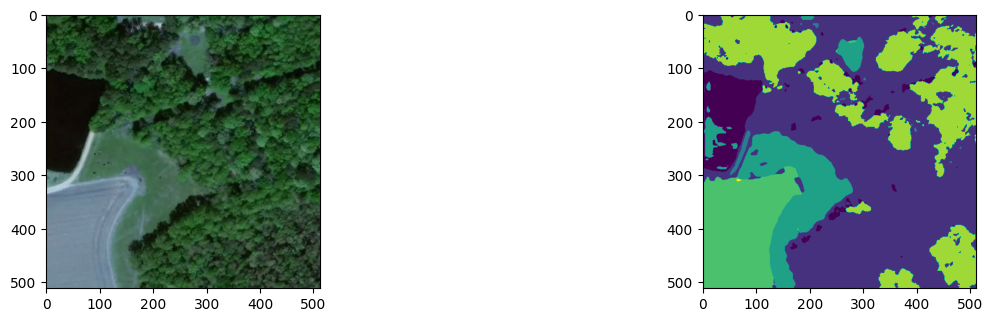

<class 'torch.Tensor'>
36709
51758


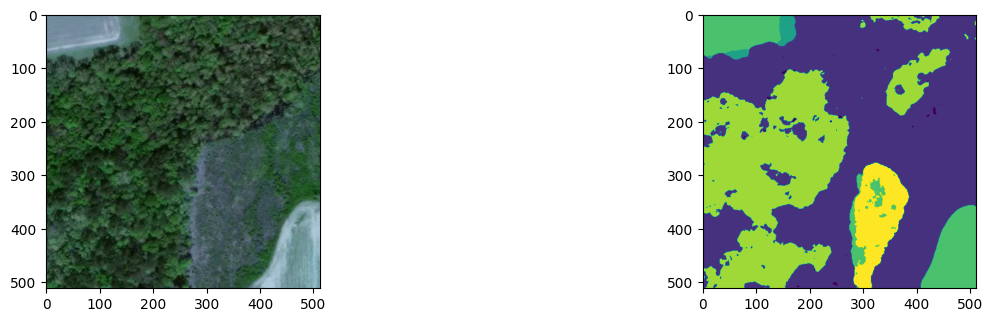

<class 'torch.Tensor'>
36709
51759


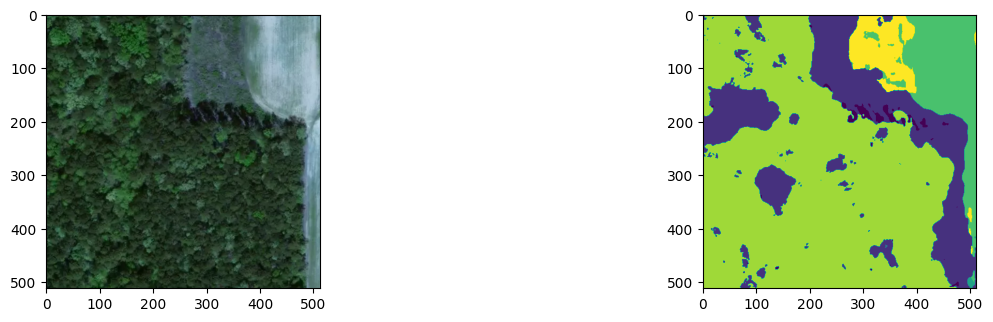

30
<class 'torch.Tensor'>
36709
51760


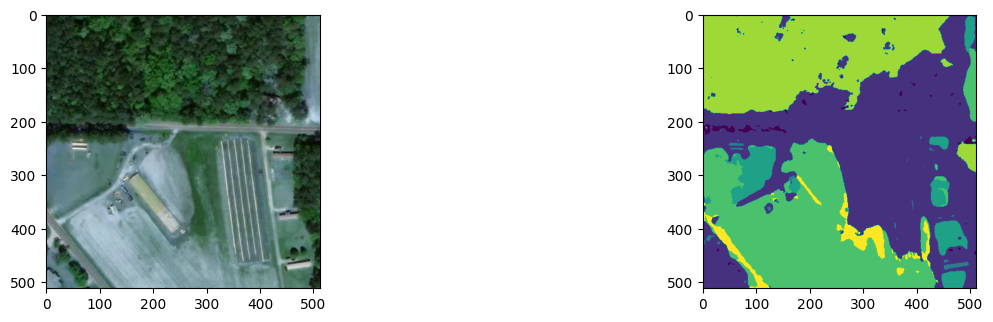

<class 'torch.Tensor'>
36709
51761


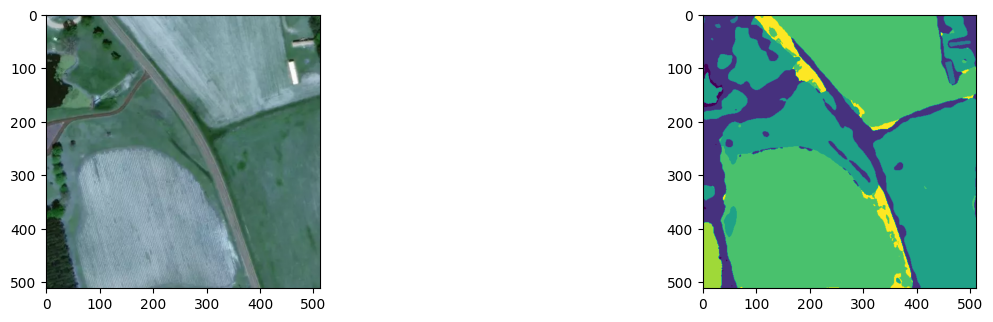

<class 'torch.Tensor'>
36709
51762


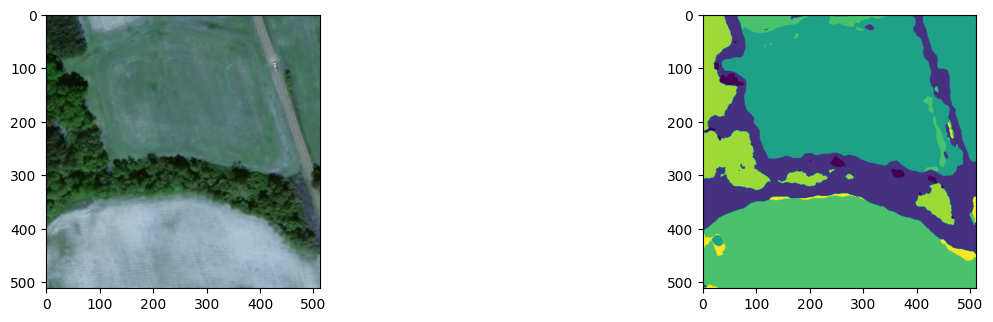

<class 'torch.Tensor'>
36709
51763


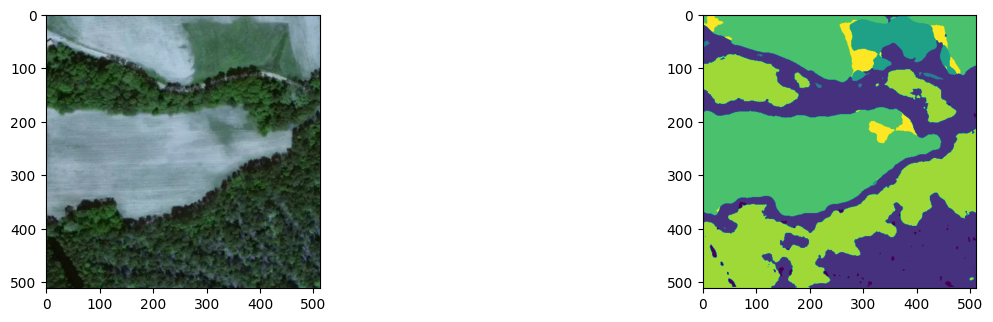

31
<class 'torch.Tensor'>
36709
51764


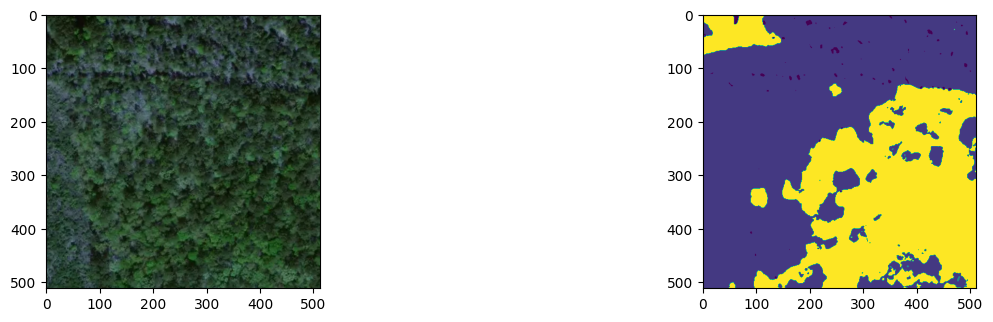

<class 'torch.Tensor'>
36709
51765


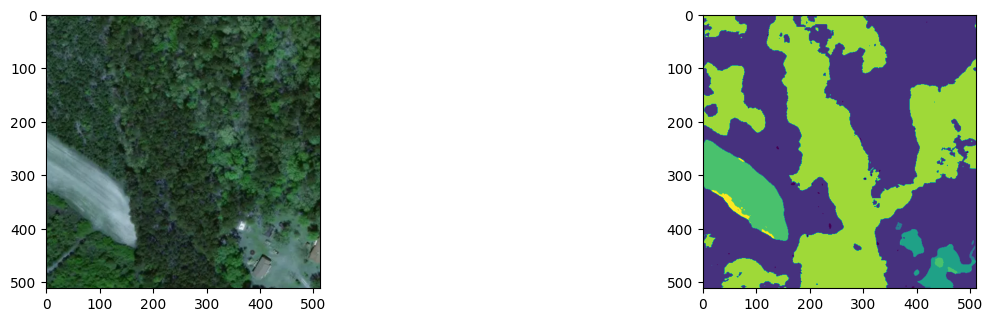

<class 'torch.Tensor'>
36710
51748


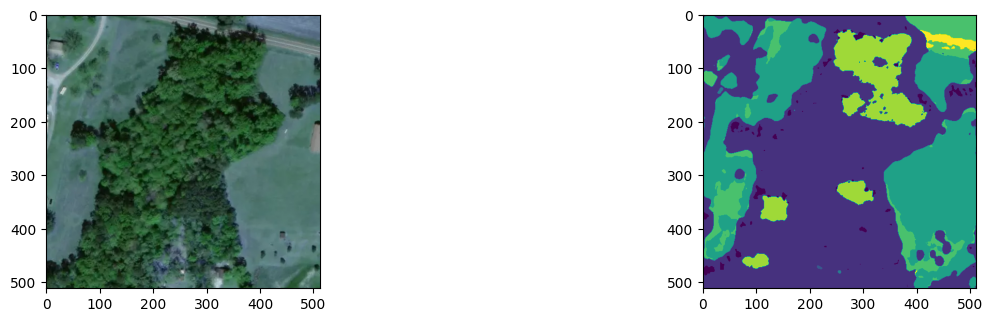

<class 'torch.Tensor'>
36710
51749


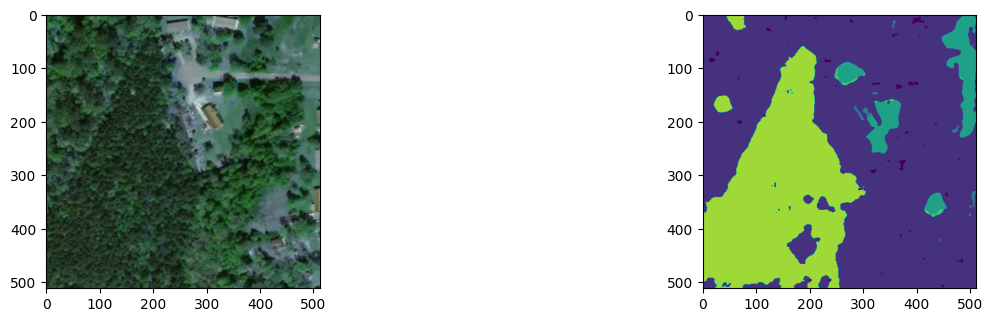

32
<class 'torch.Tensor'>
36710
51750


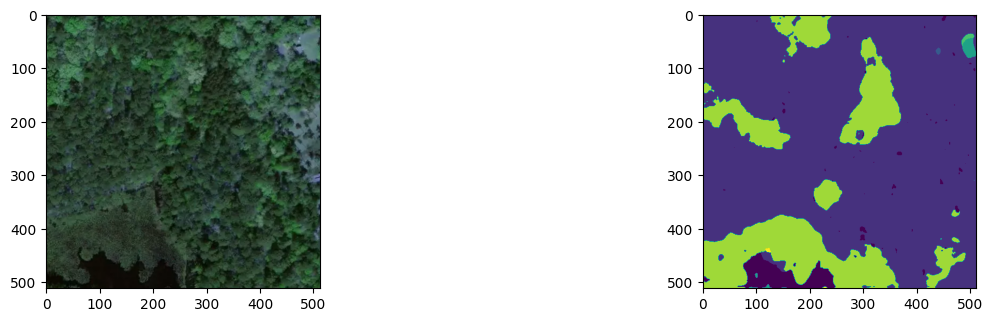

<class 'torch.Tensor'>
36710
51751


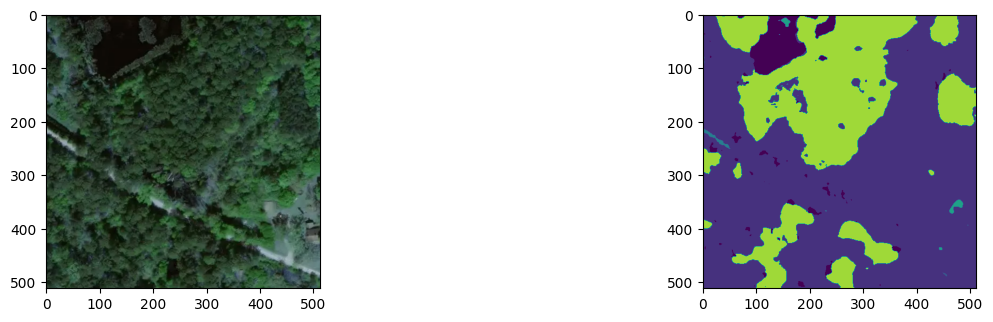

<class 'torch.Tensor'>
36710
51752


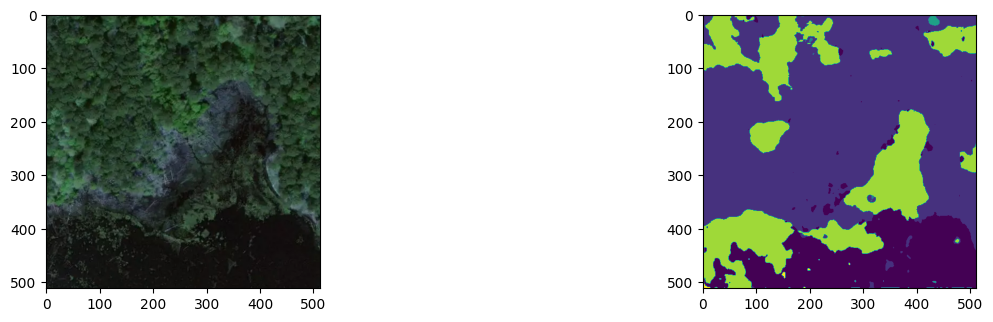

<class 'torch.Tensor'>
36710
51753


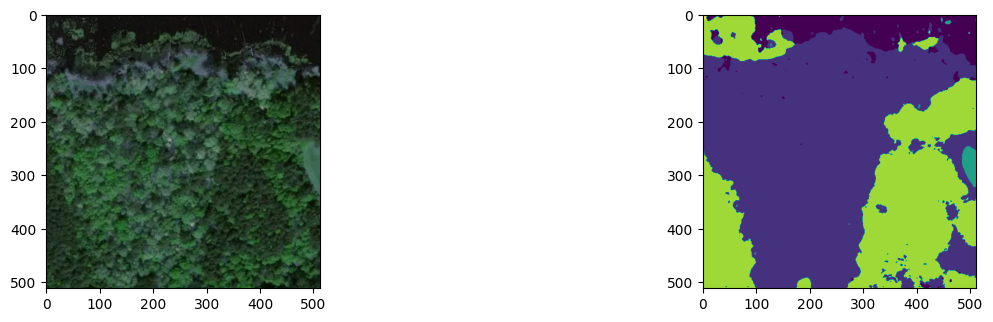

33
<class 'torch.Tensor'>
36710
51754


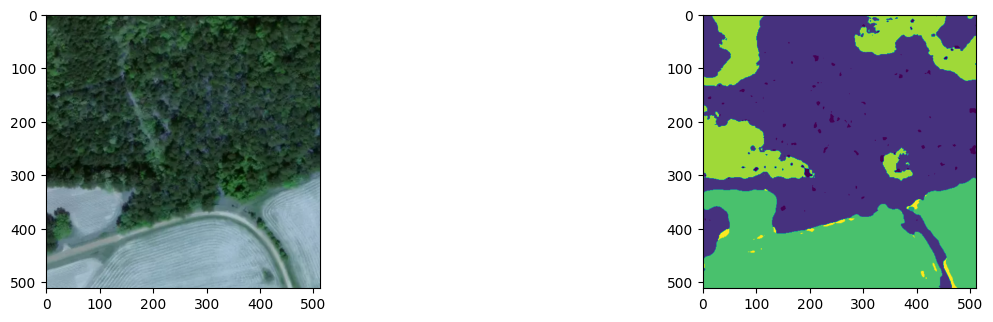

<class 'torch.Tensor'>
36710
51755


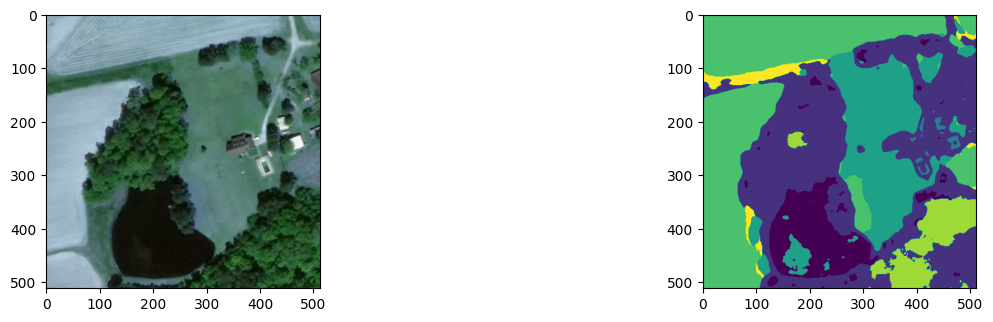

<class 'torch.Tensor'>
36710
51756


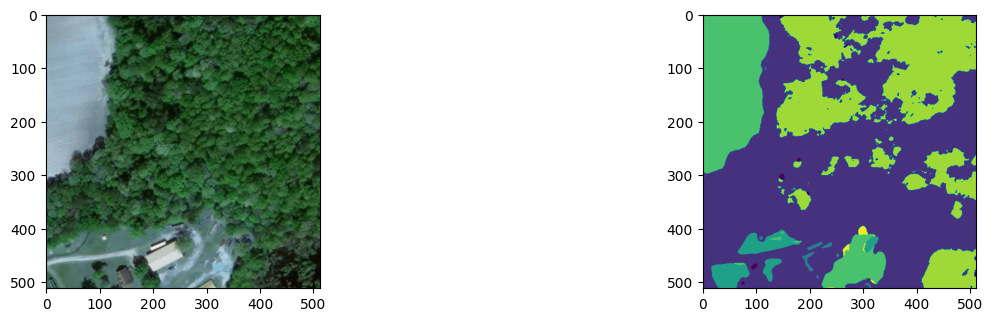

<class 'torch.Tensor'>
36710
51757


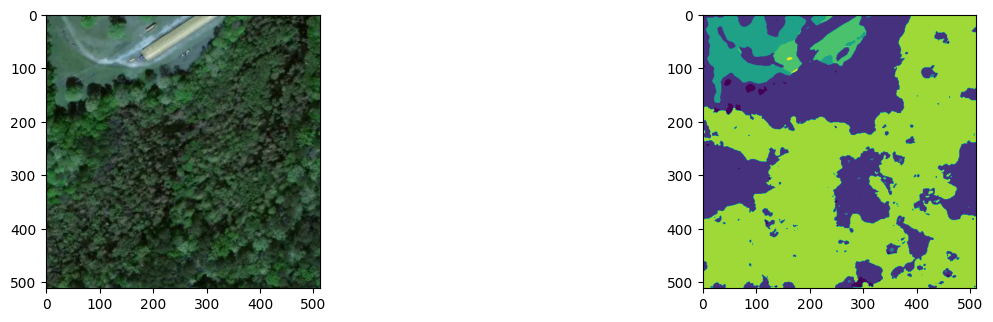

34
<class 'torch.Tensor'>
36710
51758


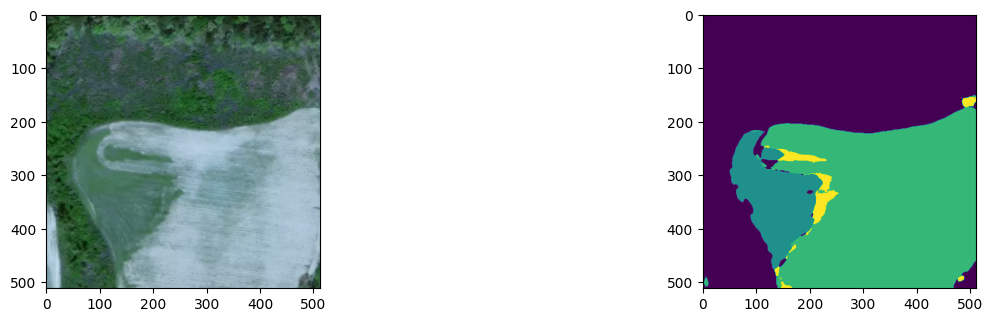

<class 'torch.Tensor'>
36710
51759


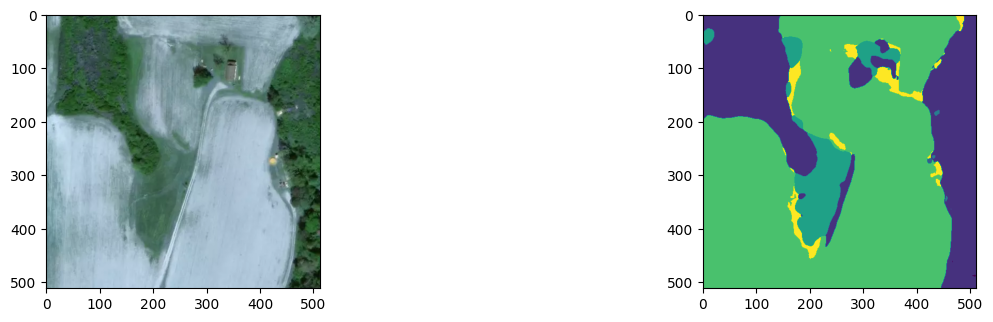

<class 'torch.Tensor'>
36710
51760


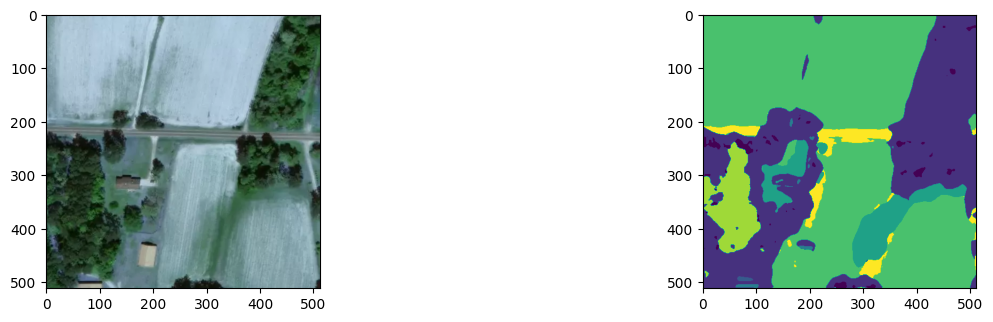

<class 'torch.Tensor'>
36710
51761


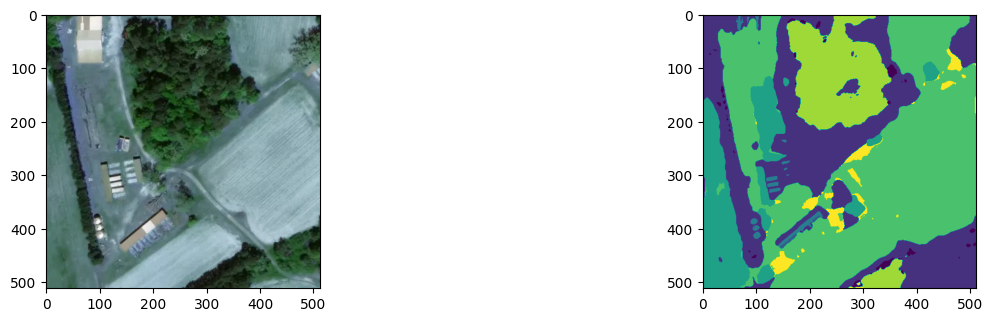

35
<class 'torch.Tensor'>
36710
51762


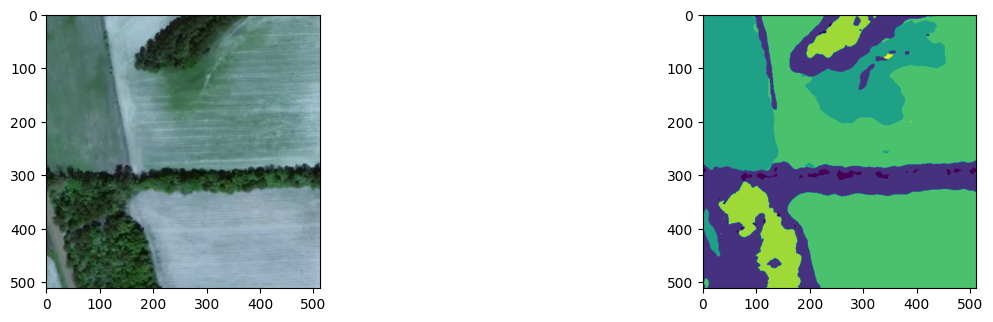

<class 'torch.Tensor'>
36710
51763


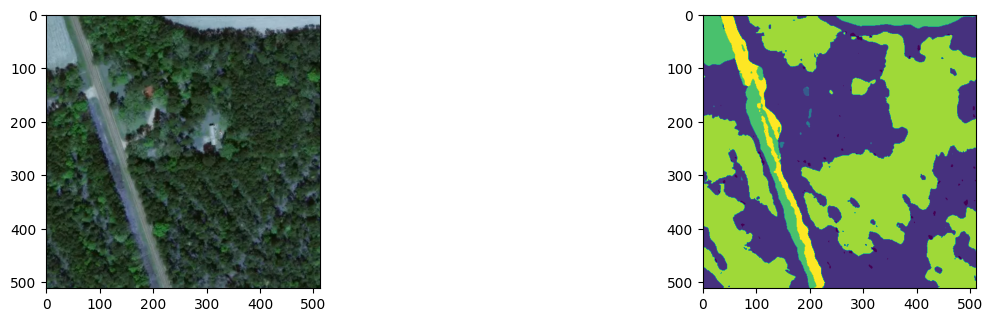

<class 'torch.Tensor'>
36710
51764


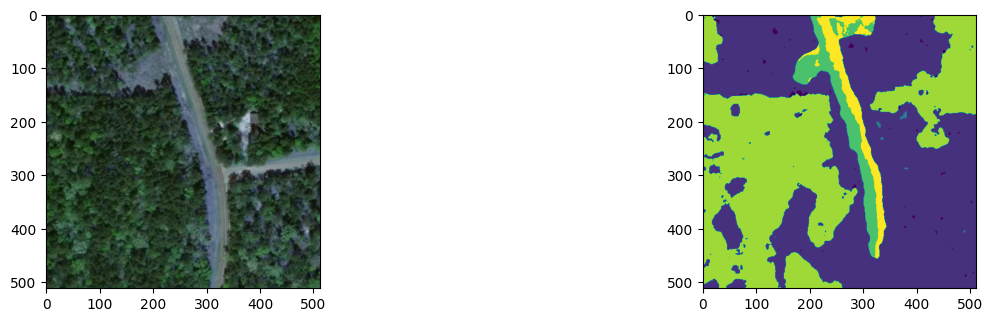

<class 'torch.Tensor'>
36710
51765


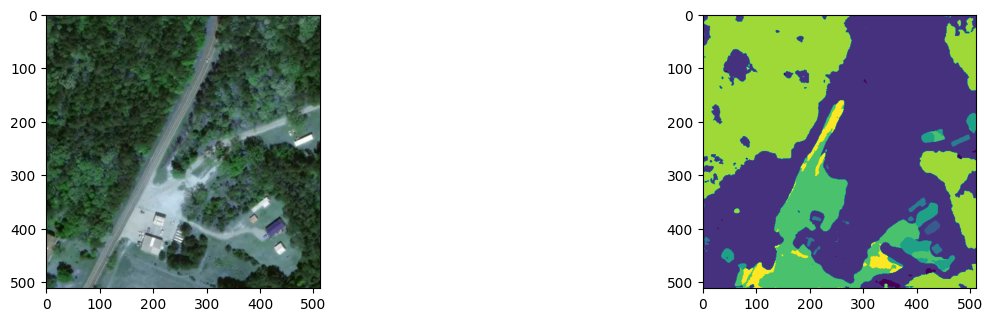

36
<class 'torch.Tensor'>
36711
51748


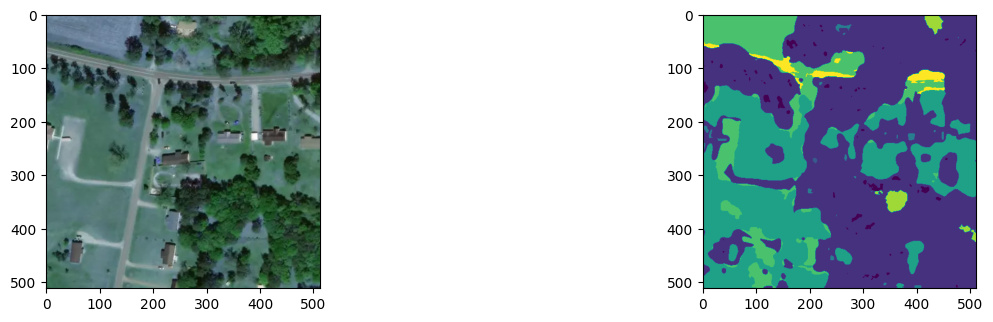

<class 'torch.Tensor'>
36711
51749


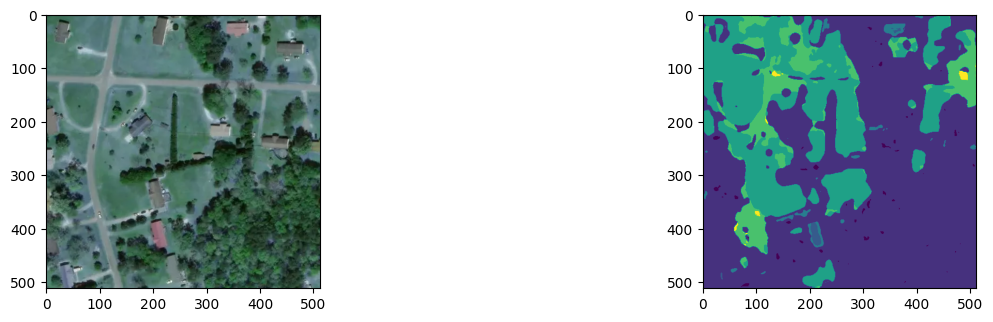

<class 'torch.Tensor'>
36711
51750


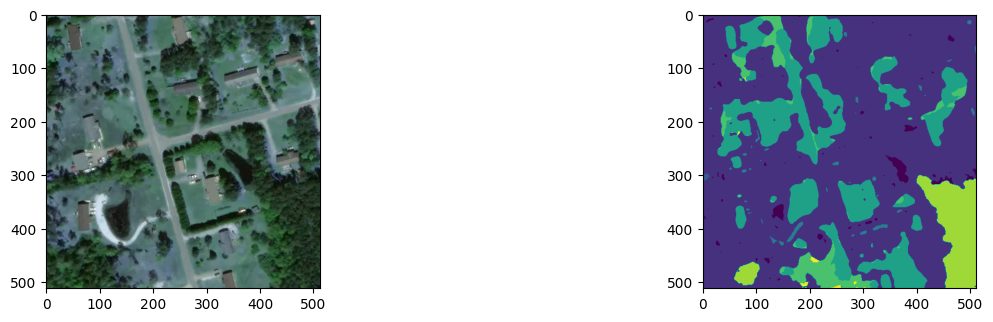

<class 'torch.Tensor'>
36711
51751


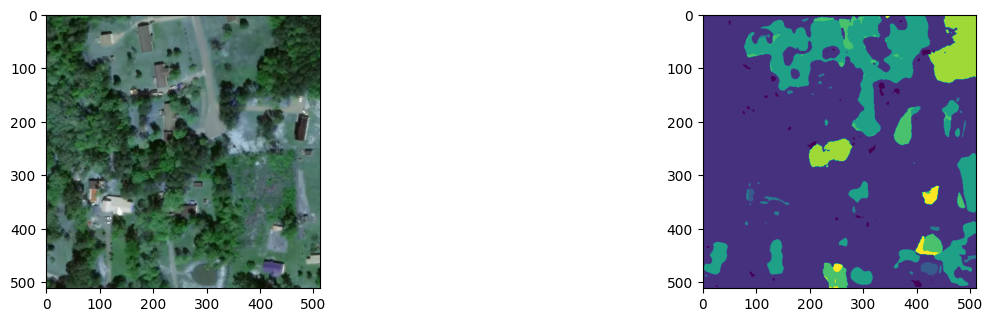

37
<class 'torch.Tensor'>
36711
51752


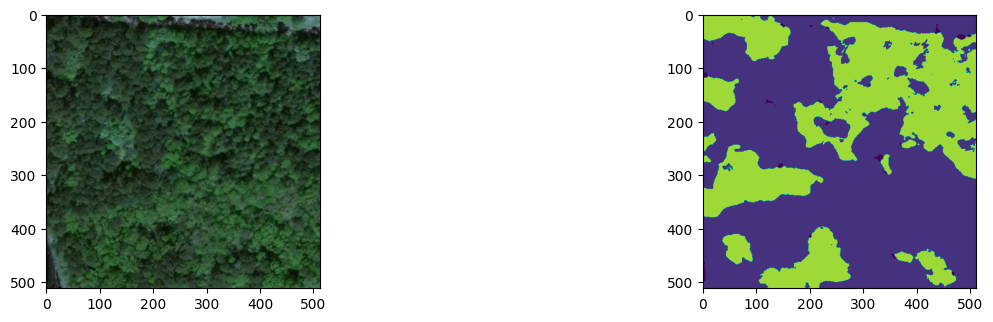

<class 'torch.Tensor'>
36711
51753


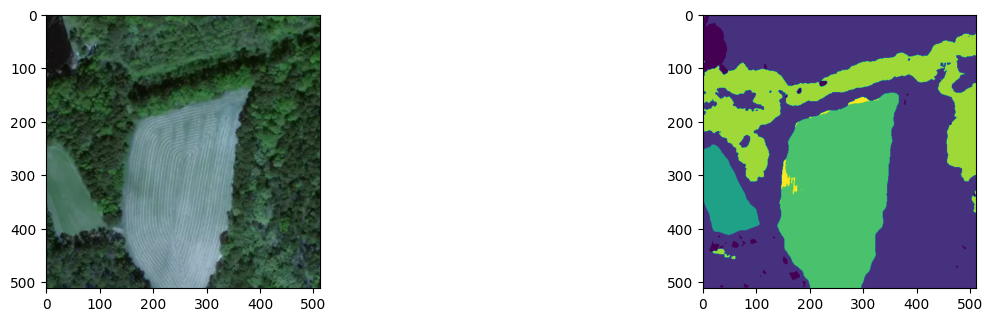

<class 'torch.Tensor'>
36711
51754


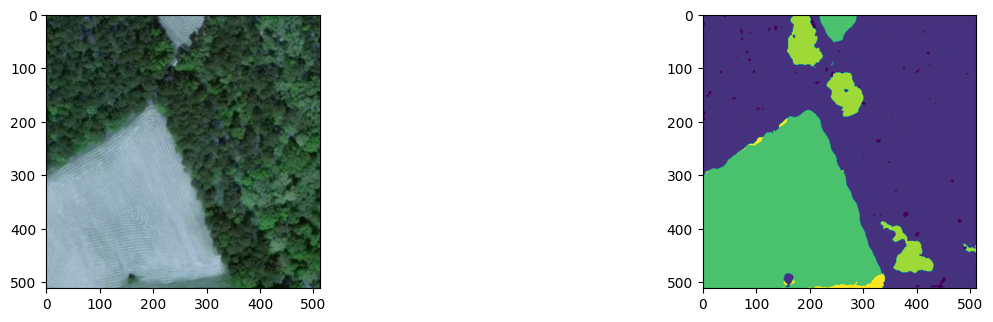

<class 'torch.Tensor'>
36711
51755


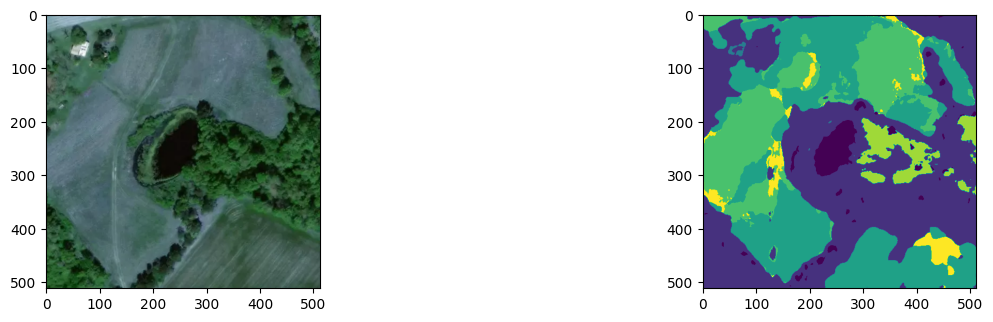

38
<class 'torch.Tensor'>
36711
51756


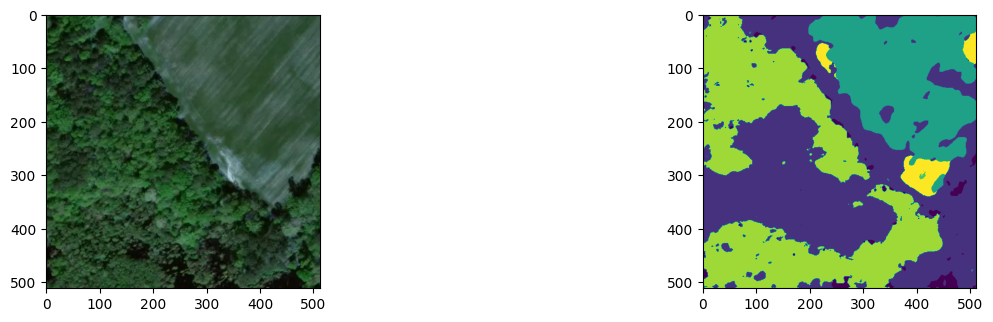

<class 'torch.Tensor'>
36711
51757


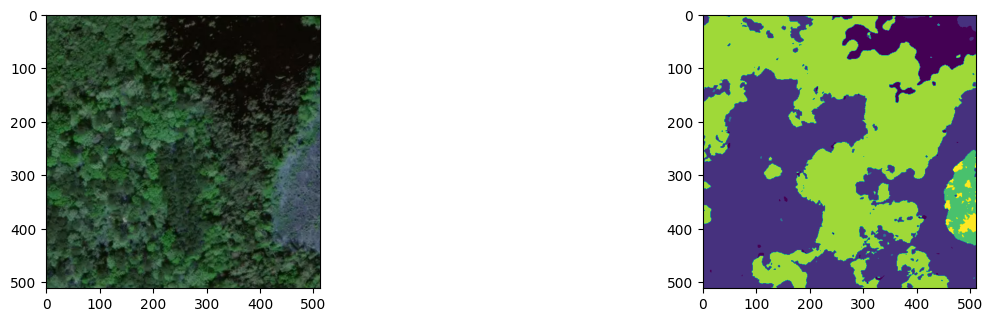

<class 'torch.Tensor'>
36711
51758


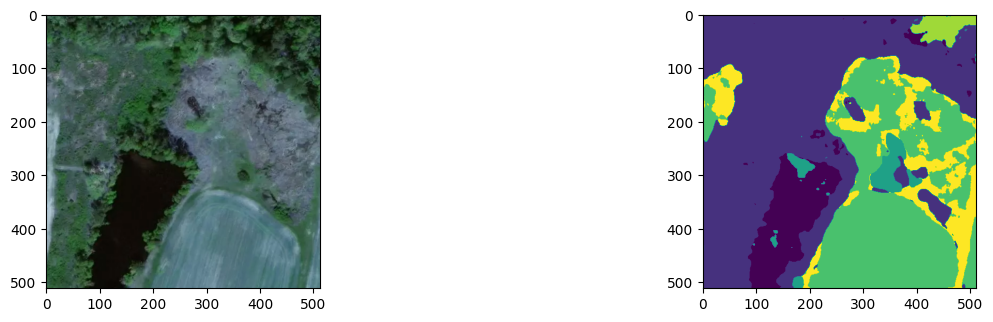

<class 'torch.Tensor'>
36711
51759


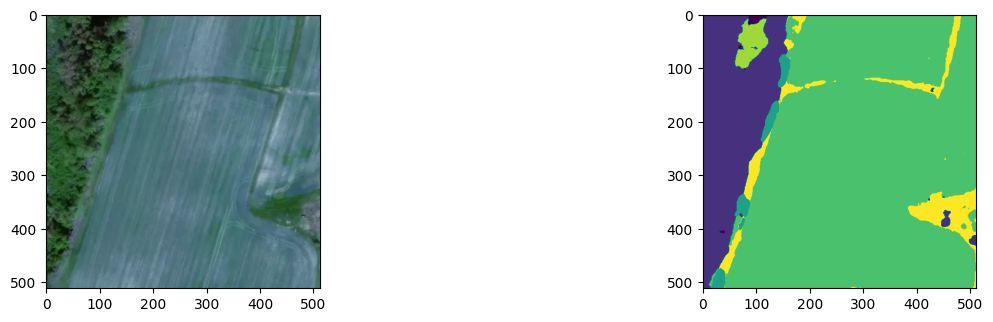

39
<class 'torch.Tensor'>
36711
51760


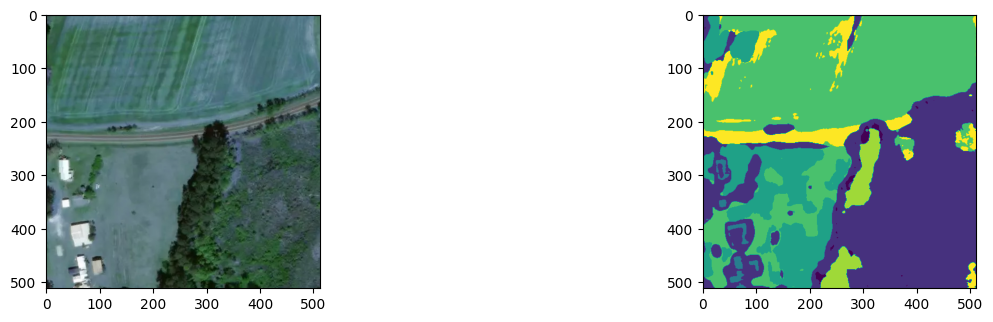

<class 'torch.Tensor'>
36711
51761


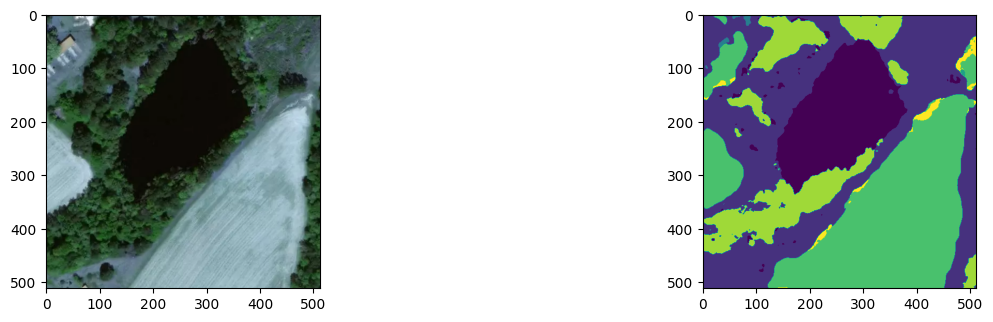

<class 'torch.Tensor'>
36711
51762


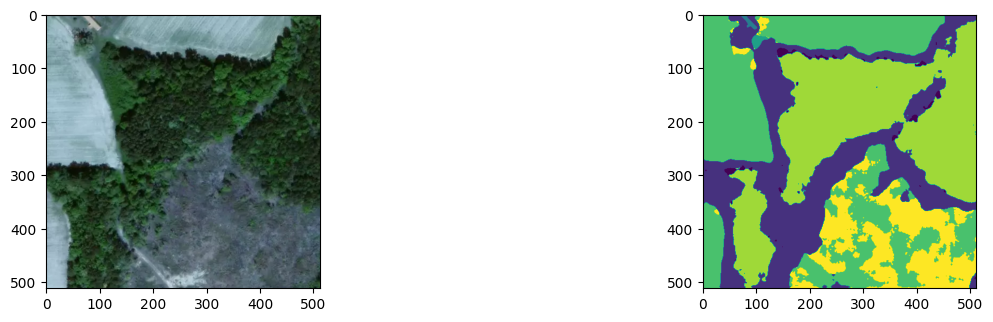

<class 'torch.Tensor'>
36711
51763


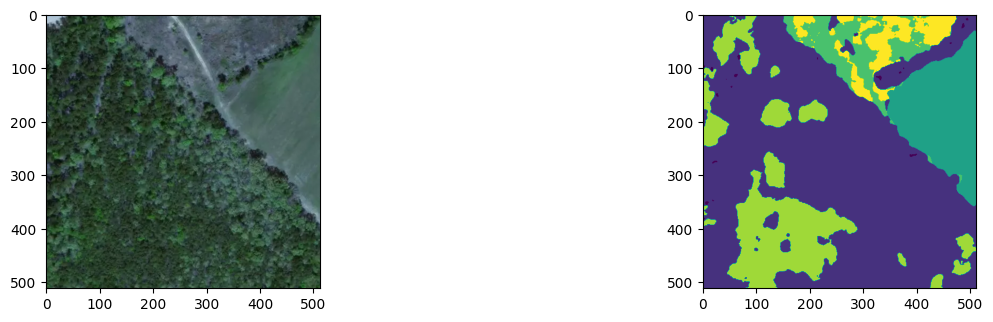

40
<class 'torch.Tensor'>
36711
51764


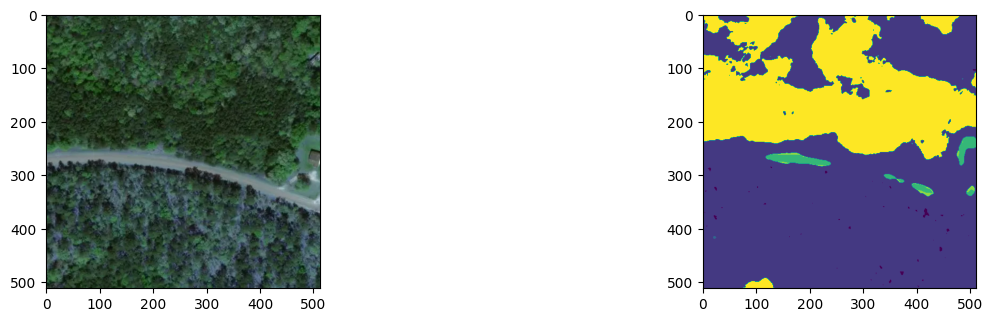

<class 'torch.Tensor'>
36711
51765


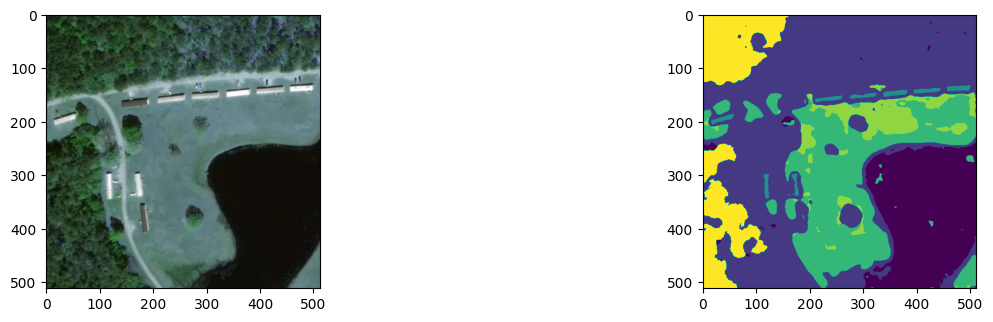

<class 'torch.Tensor'>
36712
51748


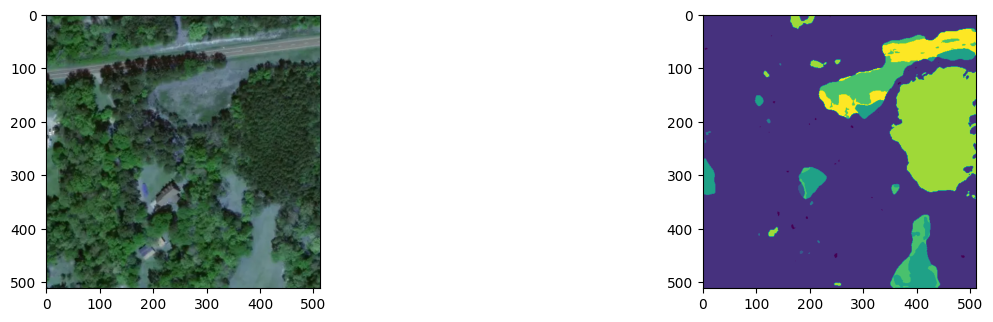

<class 'torch.Tensor'>
36712
51749


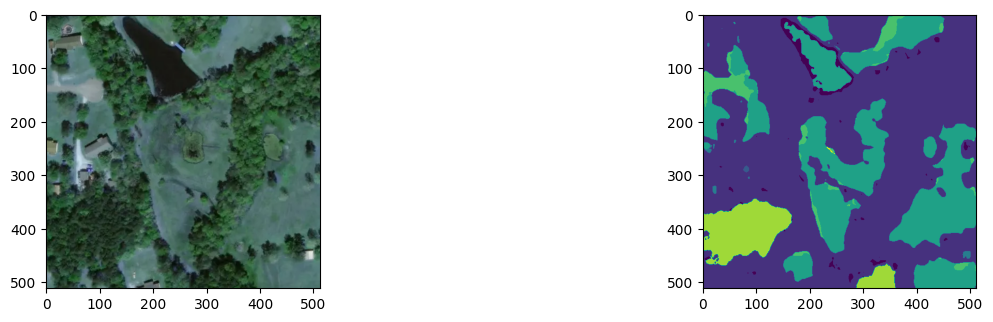

41
<class 'torch.Tensor'>
36712
51750


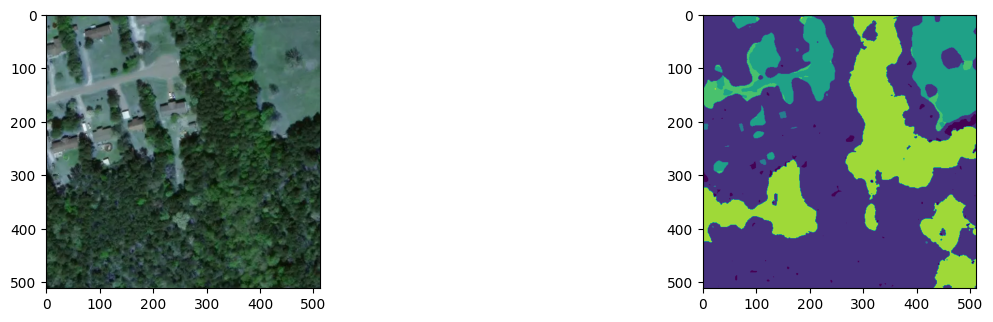

<class 'torch.Tensor'>
36712
51751


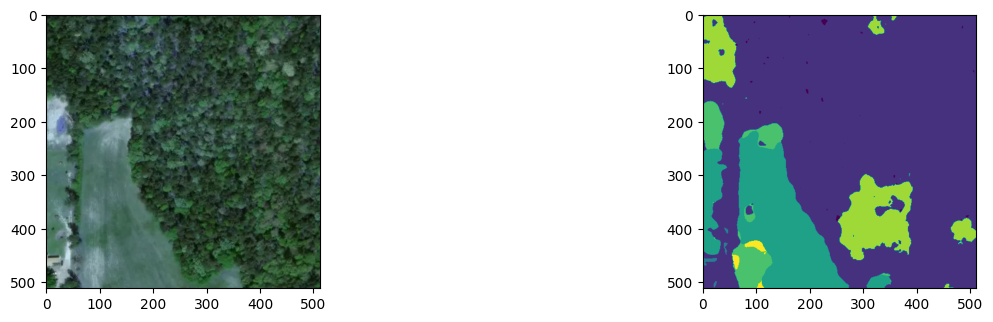

<class 'torch.Tensor'>
36712
51752


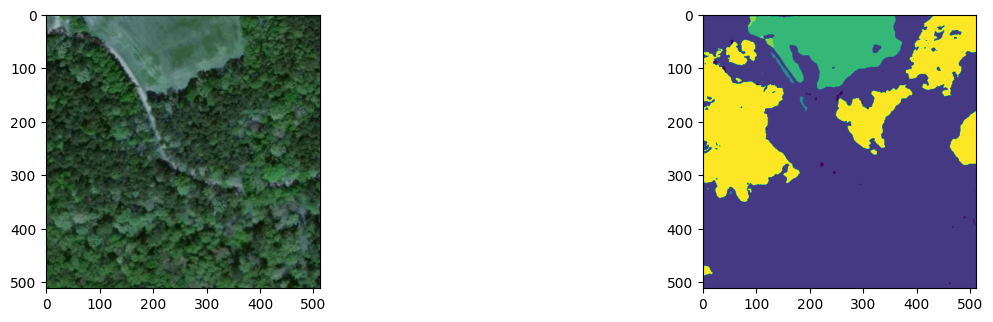

<class 'torch.Tensor'>
36712
51753


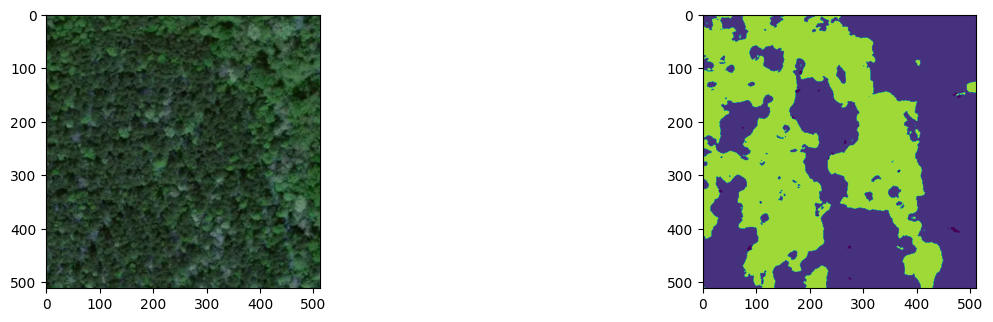

42
<class 'torch.Tensor'>
36712
51754


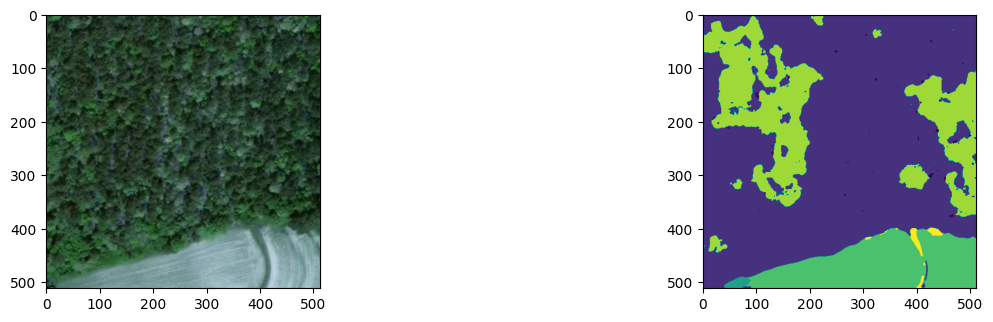

<class 'torch.Tensor'>
36712
51755


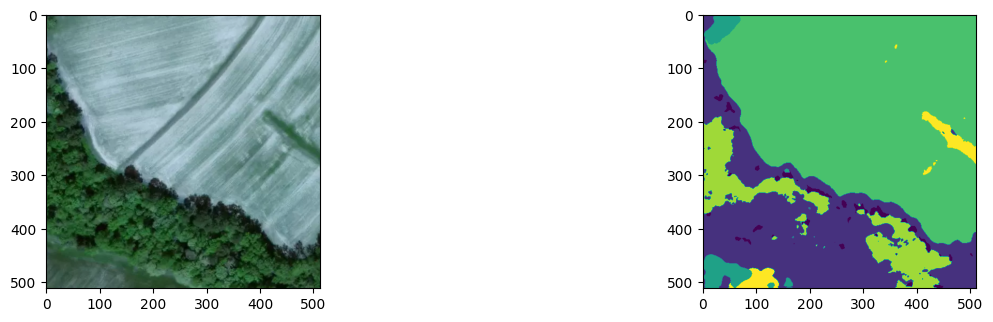

<class 'torch.Tensor'>
36712
51756


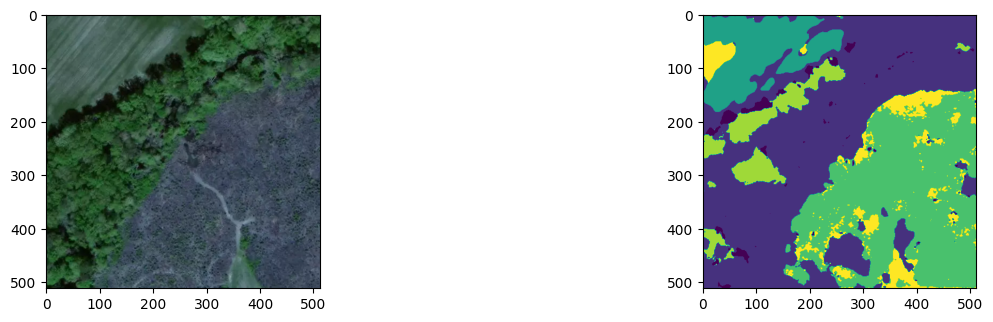

<class 'torch.Tensor'>
36712
51757


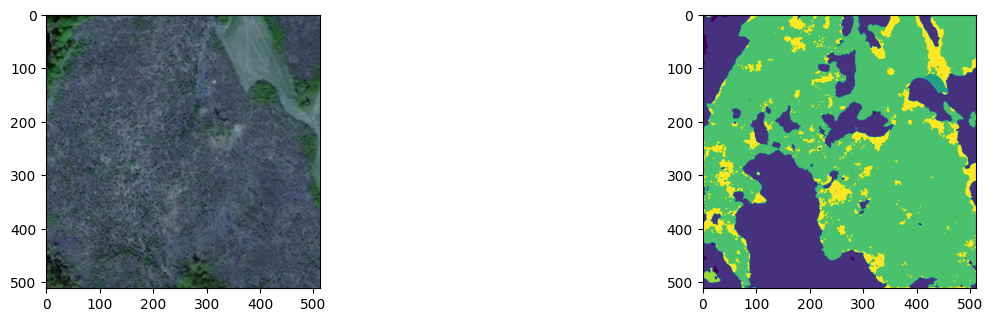

43
<class 'torch.Tensor'>
36712
51758


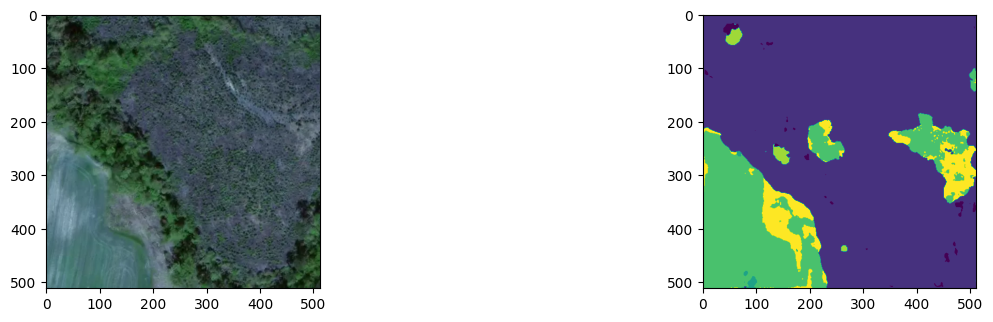

<class 'torch.Tensor'>
36712
51759


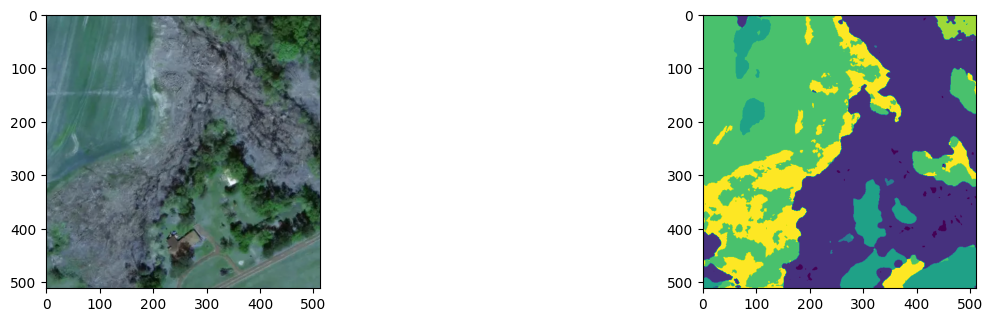

<class 'torch.Tensor'>
36712
51760


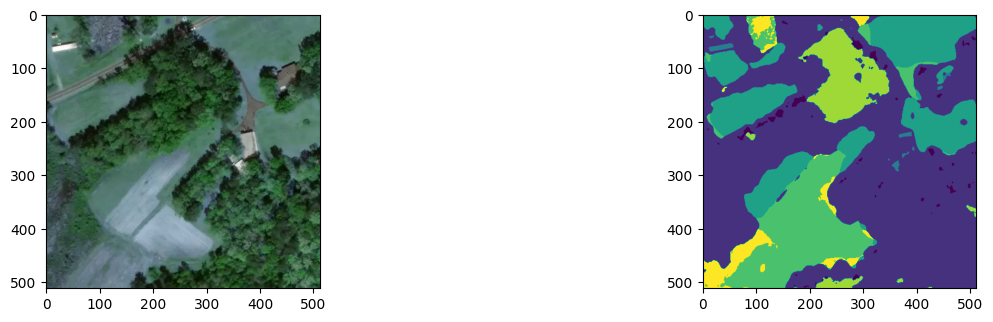

<class 'torch.Tensor'>
36712
51761


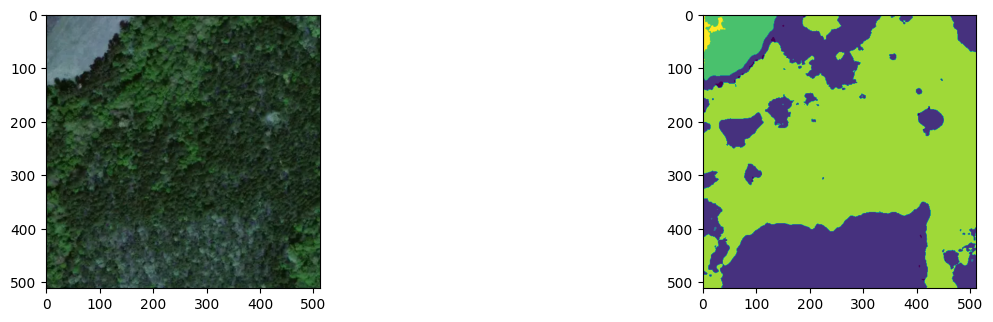

44
<class 'torch.Tensor'>
36712
51762


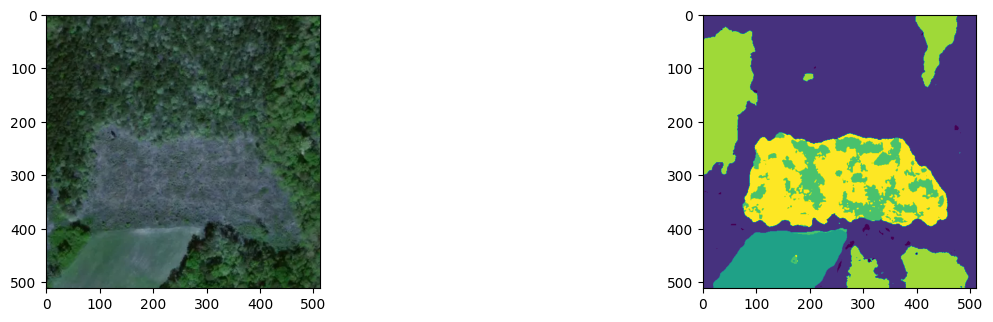

<class 'torch.Tensor'>
36712
51763


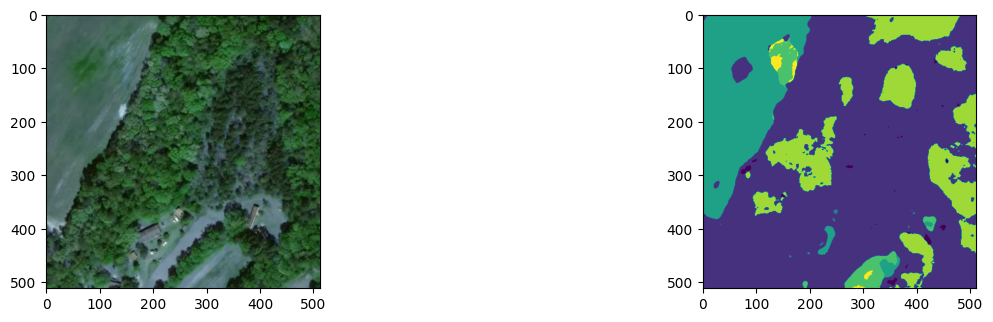

<class 'torch.Tensor'>
36712
51764


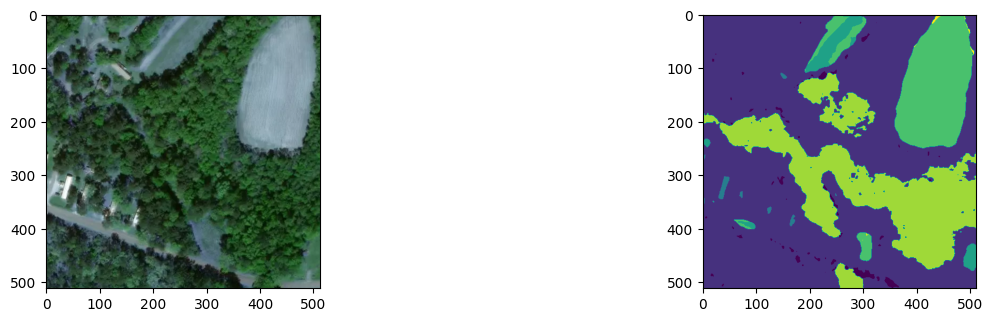

<class 'torch.Tensor'>
36712
51765


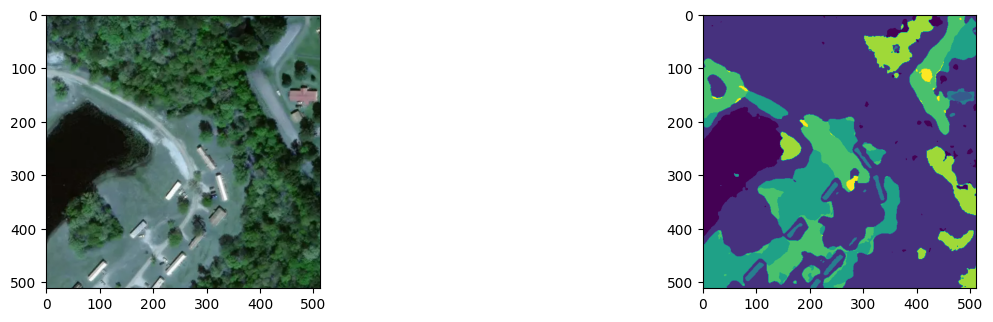

45
<class 'torch.Tensor'>
36713
51748


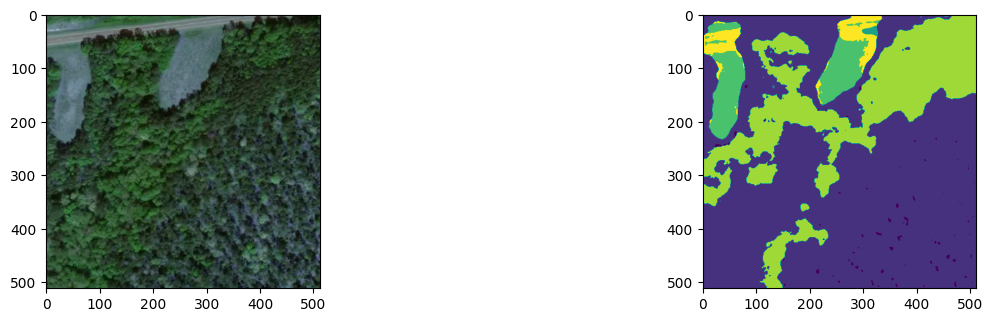

<class 'torch.Tensor'>
36713
51749


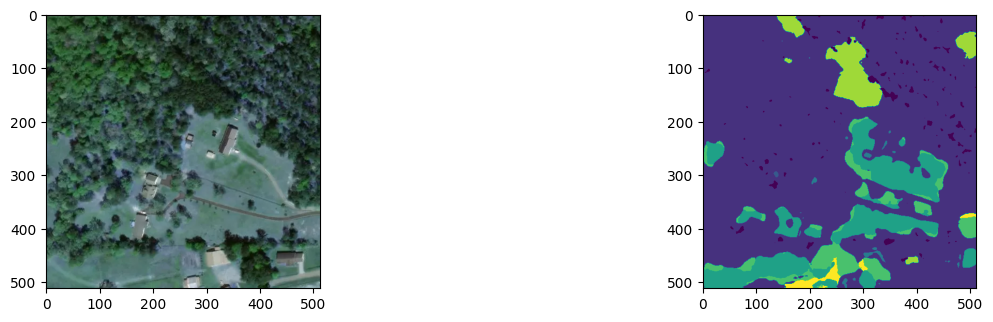

<class 'torch.Tensor'>
36713
51750


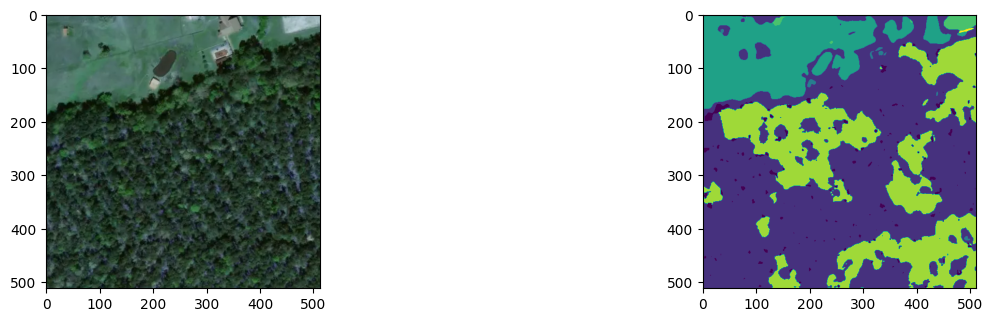

<class 'torch.Tensor'>
36713
51751


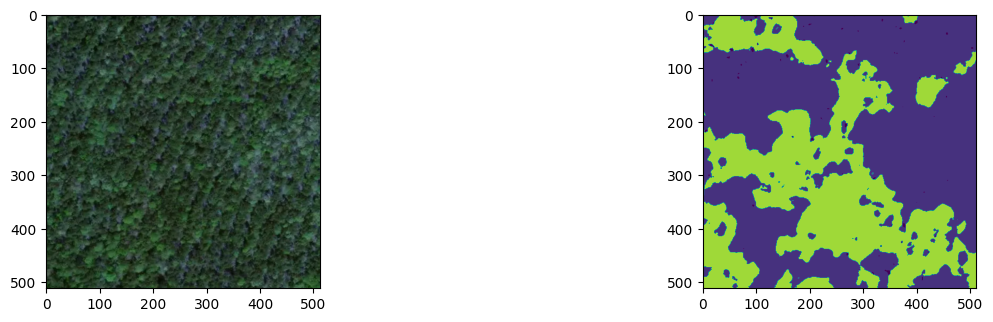

46
<class 'torch.Tensor'>
36713
51752


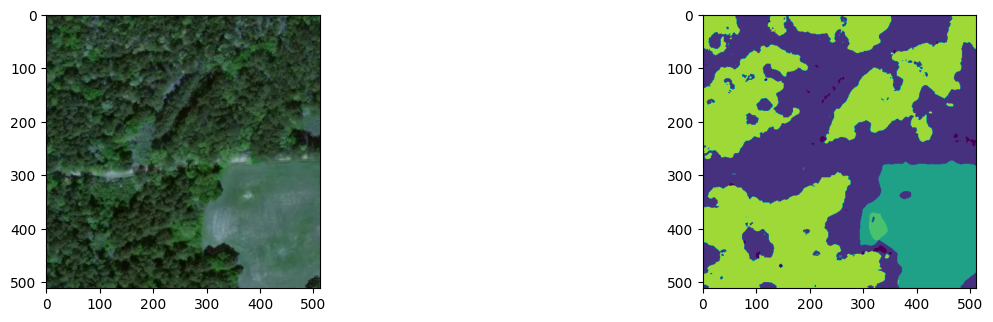

<class 'torch.Tensor'>
36713
51753


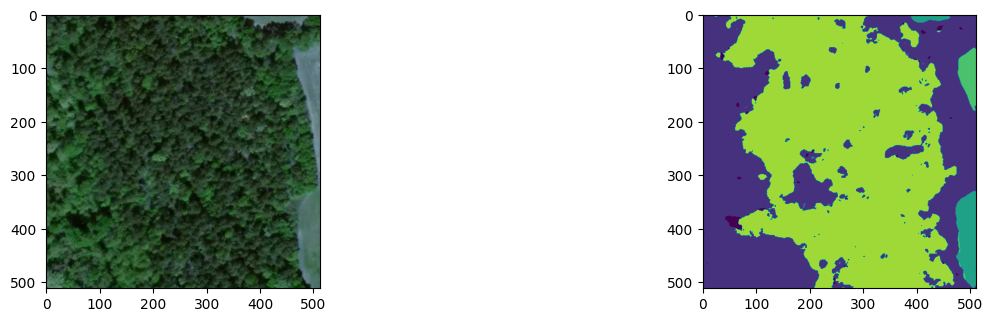

<class 'torch.Tensor'>
36713
51754


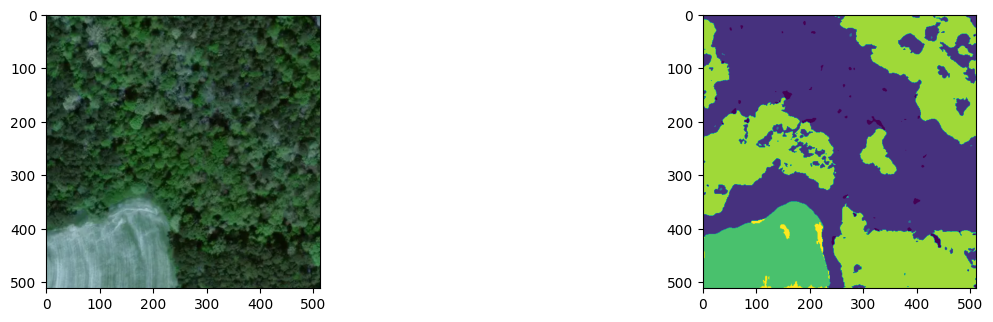

<class 'torch.Tensor'>
36713
51755


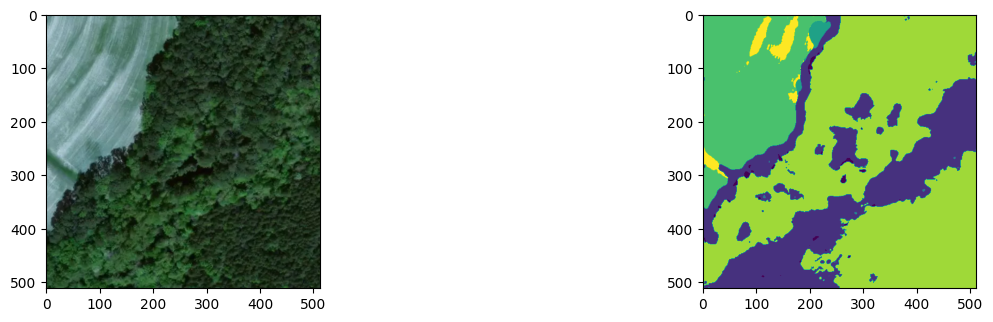

47
<class 'torch.Tensor'>
36713
51756


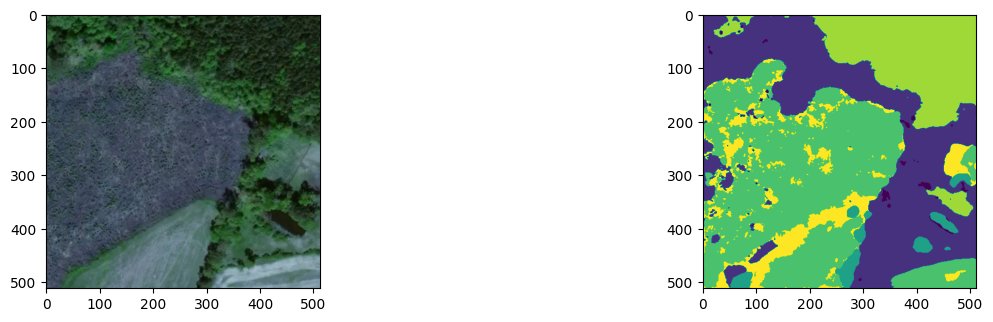

<class 'torch.Tensor'>
36713
51757


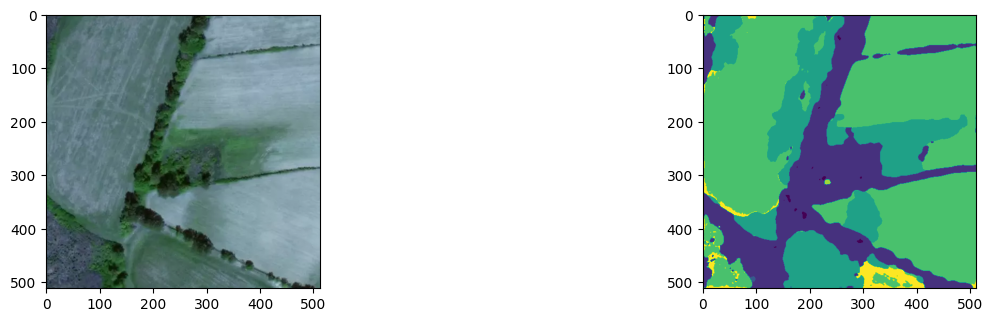

<class 'torch.Tensor'>
36713
51758


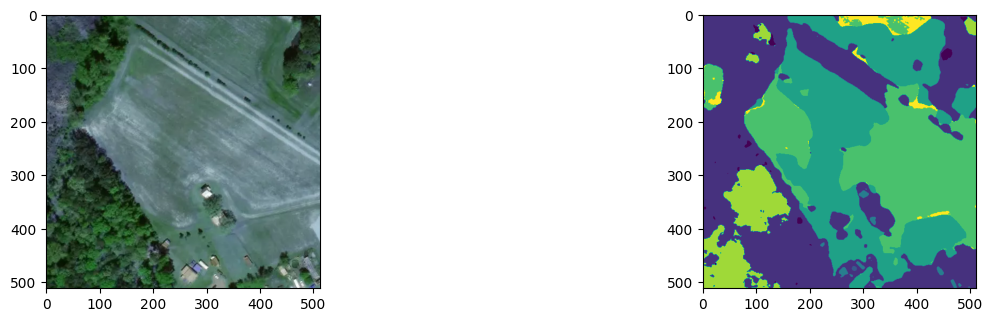

<class 'torch.Tensor'>
36713
51759


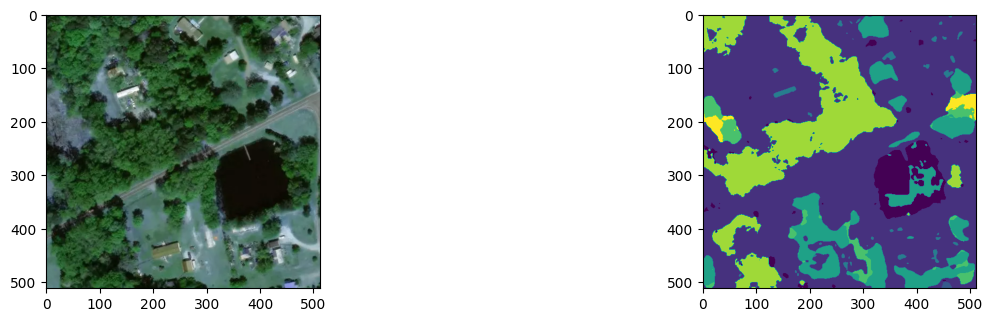

48
<class 'torch.Tensor'>
36713
51760


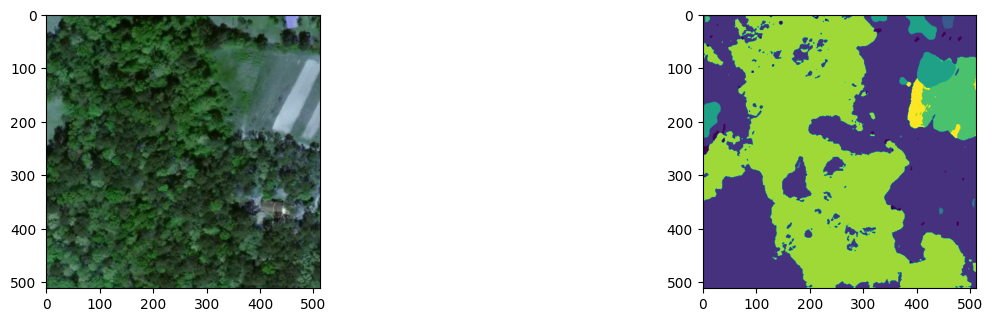

<class 'torch.Tensor'>
36713
51761


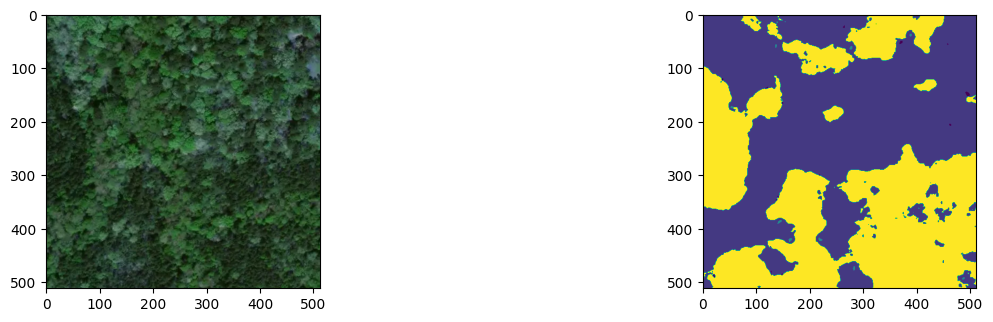

<class 'torch.Tensor'>
36713
51762


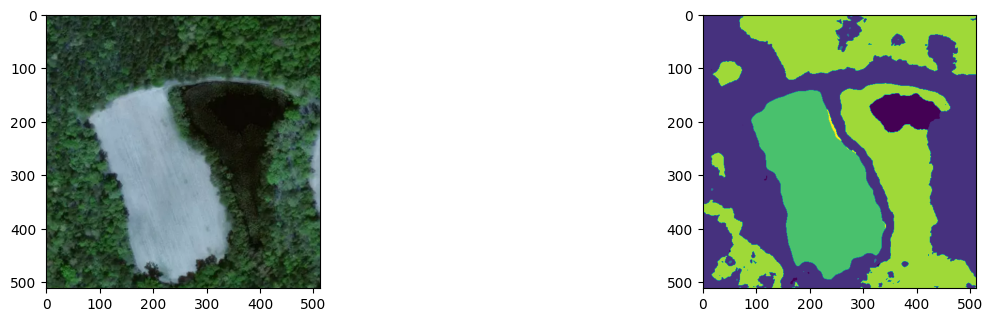

<class 'torch.Tensor'>
36713
51763


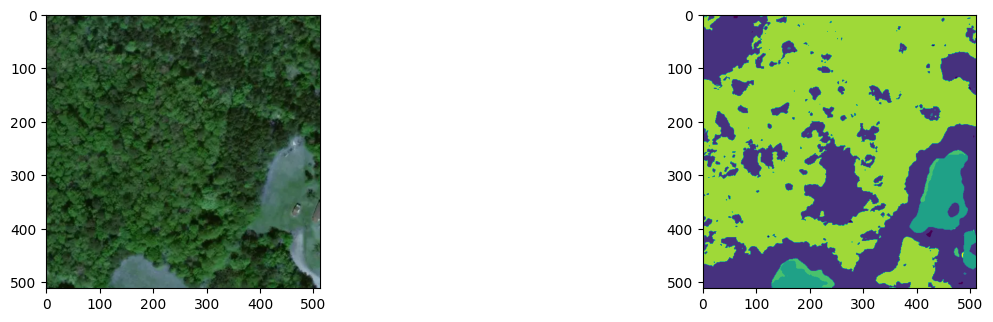

49
<class 'torch.Tensor'>
36713
51764


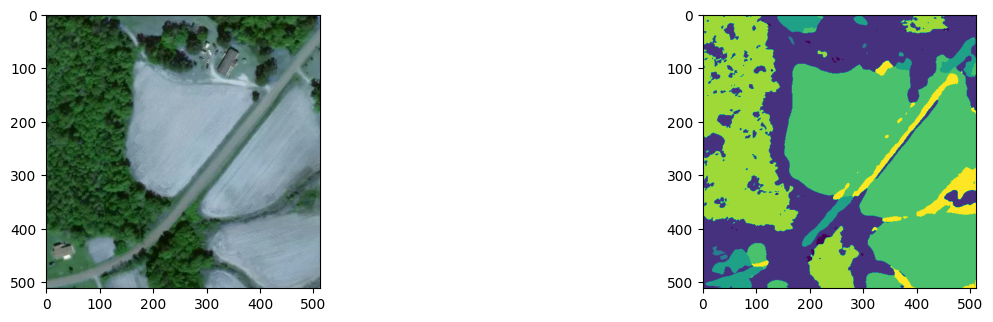

<class 'torch.Tensor'>
36713
51765


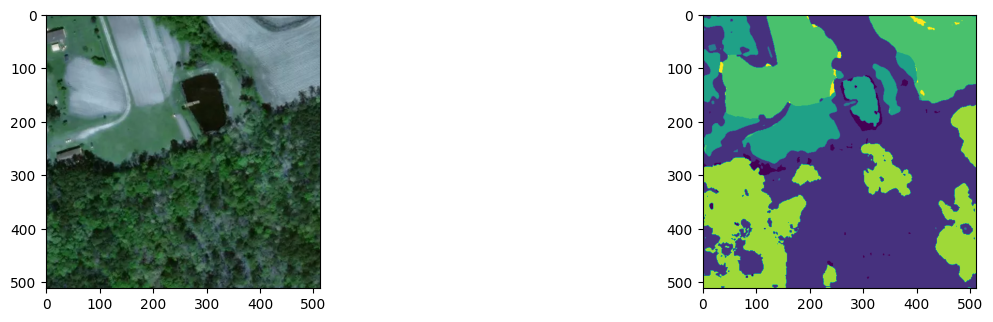

<class 'torch.Tensor'>
36714
51748


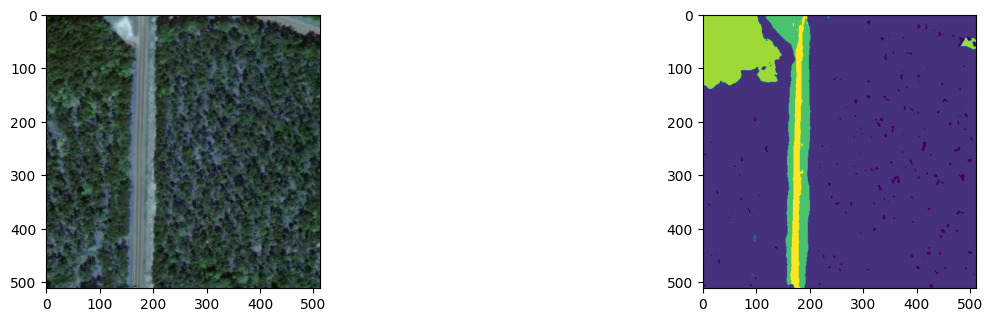

<class 'torch.Tensor'>
36714
51749


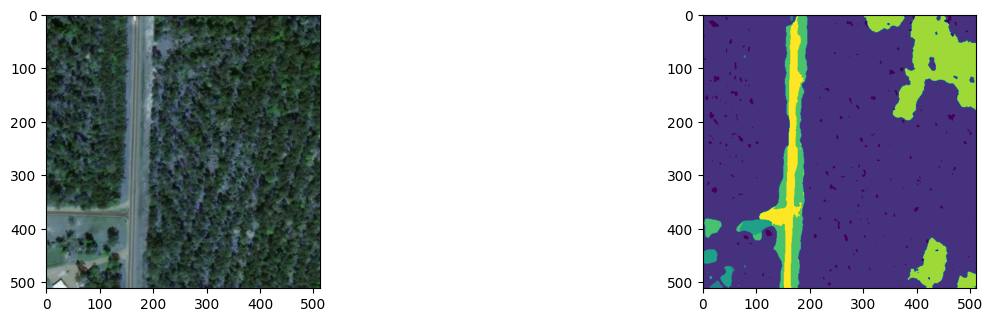

50
<class 'torch.Tensor'>
36714
51750


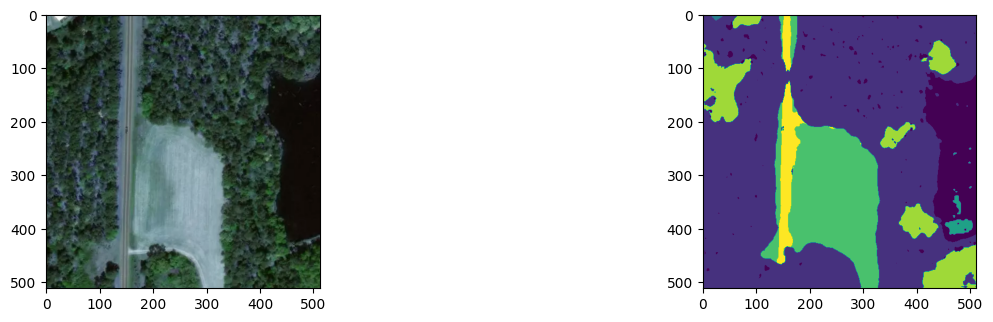

<class 'torch.Tensor'>
36714
51751


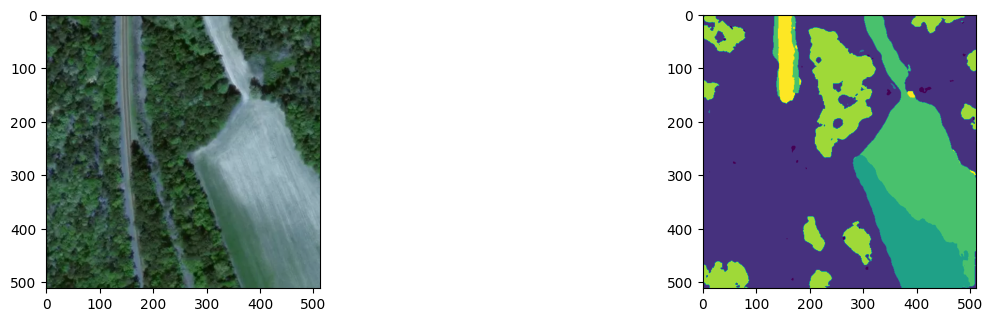

<class 'torch.Tensor'>
36714
51752
Buffered data was truncated after reaching the output size limit.

In [ ]:
model.eval()
k = 0
for batch_i, (x) in enumerate(test_dataloader):
  print(batch_i)
  for j in range(len(x)):
      print(type(x))
      result = model(x.to(device)[j:j+1])
      mask= torch.argmax(result, axis=1).cpu().detach().numpy()[0]
      create_json(mask, int(filenames_image[k][0:5]), int(filenames_image[k][6:11]), int(filenames_image[k][12:14]) )

      print(filenames_image[k][0:5])
      print(filenames_image[k][6:11])

      k = k +1
      im = np.moveaxis(x.to(device)[j].cpu().detach().numpy(), 0, -1).copy()*255
      im = im.astype(int)
      #gt_mask = y[j]

      plt.figure(figsize=(12,12))

      plt.subplot(1,3,1)
      im = np.moveaxis(x.to(device)[j].cpu().detach().numpy(), 0, -1).copy()*255
      im = im.astype(int)
      plt.imshow(im)

      plt.subplot(1,3,3)
      plt.imshow(mask)
      plt.show()

# Create a map with a single prediction.

In [ ]:
import folium
# Create a Folium map centered on a specific location


In [ ]:
CLASS = 1

directory = '/content/drive/MyDrive/Final_model/results_35.36-79.17_17/'

# Create a map
m = folium.Map(location=[35.367077,-79.17496], zoom_start=14)
tile = folium.TileLayer(
        tiles = 'https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}',
        attr = 'Esri',
        name = 'Esri Satellite',
        overlay = False,
        control = True
       ).add_to(m)
# Iterate over each file in the directory
for filename in os.listdir(directory):
    # Check if the file is a geojson file
    if filename.endswith(f'{CLASS}.geojson'):
        # Full file path
        geojson_file = os.path.join(directory, filename)

        # Open and load the geojson file
        with open(geojson_file, 'r') as f:
            geojson_data = json.load(f)

        # Add the GeoJSON data to the map
        folium.GeoJson(geojson_data).add_to(m)

# Display the map
m

# Pegar geofiles para cada clase segmentada

In [ ]:
!pip install geopandas

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 20.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.4/16.4 MB 53.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.9/7.9 MB 66.5 MB/s eta 0:00:00


In [ ]:
import geopandas as gdf
import glob

json_dir_name = "/content/drive/MyDrive/Final_model/results35.48_-79.20_0.1_17"
json_pattern = os.path.join(json_dir_name,'*_5.geojson')
file_list = glob.glob(json_pattern)
len(file_list)

77

In [ ]:

for i in range(len(file_list)):
  if i == 0:
    one = gdf.read_file(file_list[i])
  else :
    two = gdf.read_file(file_list[i])
    one = two.append(one, ignore_index=True)

<ipython-input-34-f062d426f088>:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  one = two.append(one, ignore_index=True)
<ipython-input-34-f062d426f088>:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  one = two.append(one, ignore_index=True)
<ipython-input-34-f062d426f088>:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  one = two.append(one, ignore_index=True)
<ipython-input-34-f062d426f088>:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  one = two.append(one, ignore_index=True)
<ipython-input-34-f062d426f088>:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.conc

In [ ]:
one.to_file("/content/drive/MyDrive/Final_model/results35.48_-79.20_0.1_17/3579_barren_5_17.geojson", driver='GeoJSON')

# Crear un solo mapa para cada clase segmentada

In [ ]:
map_center = [35.367077,-79.17496]  # Replace with your desired map center coordinates
m = folium.Map(location=map_center, zoom_start=16)
tile = folium.TileLayer(
        tiles = 'https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}',
        attr = 'Esri',
        name = 'Esri Satellite',
        overlay = False,
        control = True
       ).add_to(m)
# Read the GeoJSON file
geojson_file = f'/content/drive/MyDrive/Final_model/results_35.36-79.17_17/forest_6_17.geojson'

with open(geojson_file, 'r') as f:
  geojson_data = json.load(f)

  # Add the GeoJSON data to the map
  folium.GeoJson(geojson_data).add_to(m)

m